# Projet : Implémentez un modèle de scoring
## Description

Vous êtes Data Scientist au sein d'une société financière, nommée "Prêt à dépenser",  qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.

L’entreprise souhaite développer un modèle de scoring de la probabilité de défaut de paiement du client pour étayer la décision d'accorder ou non un prêt à un client potentiel en s’appuyant sur des sources de données variées (données comportementales, données provenant d'autres institutions financières, etc.).

De plus, les chargés de relation client ont fait remonter le fait que les clients sont de plus en plus demandeurs de transparence vis-à-vis des décisions d’octroi de crédit. Cette demande de transparence des clients va tout à fait dans le sens des valeurs que l’entreprise veut incarner.

Elle décide donc de développer un dashboard interactif pour que les chargés de relation client puissent à la fois expliquer de façon la plus transparente possible les décisions d’octroi de crédit, mais également permettre à leurs clients de disposer de leurs informations personnelles et de les explorer facilement. 

## Les données
Voici les données dont vous aurez besoin pour réaliser le dashboard. Pour plus de simplicité, vous pouvez les télécharger à cette adresse.

https://www.kaggle.com/c/home-credit-default-risk/data

## Votre mission

1. Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique.
2. Construire un dashboard interactif à destination des gestionnaires de la relation client permettant d'interpréter les prédictions faites par le modèle et d’améliorer la connaissance client des chargés de relation client.

Michaël, votre manager, vous incite à sélectionner un kernel Kaggle pour vous faciliter la préparation des données nécessaires à l’élaboration du modèle de scoring. Vous analyserez ce kernel et l’adapterez pour vous assurer qu’il répond aux besoins de votre mission.

Vous pourrez ainsi vous focaliser sur l’élaboration du modèle, son optimisation et sa compréhension.

## Spécification du dashboard

Michaël vous a fourni un cahier des charges pour le dashboard interactif. Celui-ci devra a minima contenir les fonctionnalités suivantes :

- Permettre de visualiser le score et l’interprétation de ce score pour chaque client de façon intelligible pour une personne -non experte en data science.
- Permettre de visualiser des informations descriptives relatives à un client (via un système de filtre).
- Permettre de comparer les informations descriptives relatives à un client à l’ensemble des clients ou à un groupe de clients similaires

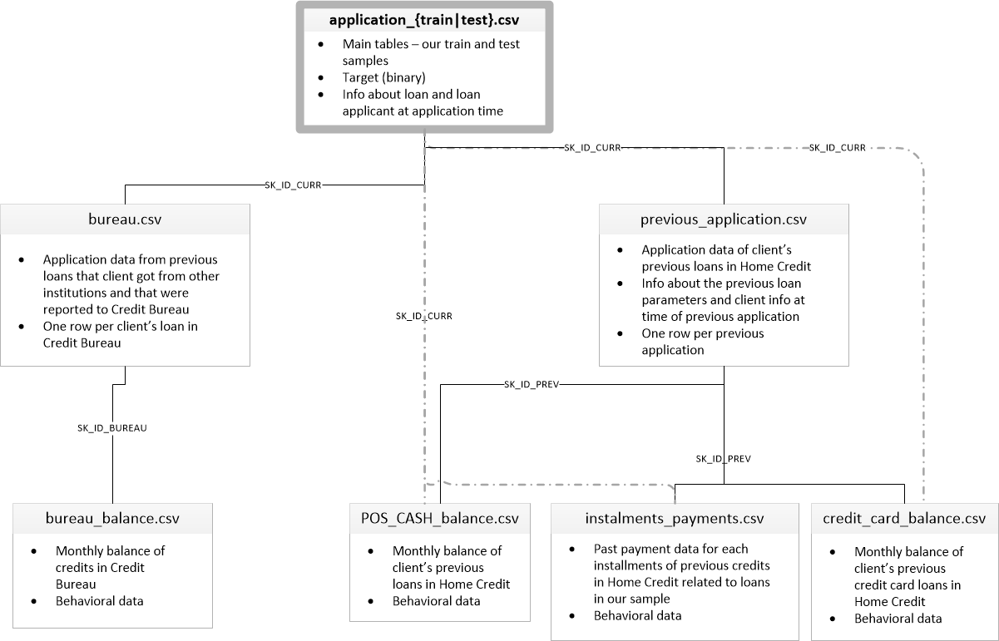

Notebook utilisés : https://www.kaggle.com/willkoehrsen/start-here-a-gentle-introduction
https://www.kaggle.com/codename007/home-credit-complete-eda-feature-importance

## Import et exploration des donnnées

In [2]:
!pip install optuna

     |████████████████████████████████| 308 kB 3.1 MB/s 
     |████████████████████████████████| 80 kB 9.0 MB/s 
     |████████████████████████████████| 209 kB 52.9 MB/s 
     |████████████████████████████████| 75 kB 4.0 MB/s 
     |████████████████████████████████| 111 kB 57.8 MB/s 
     |████████████████████████████████| 49 kB 6.1 MB/s 
     |████████████████████████████████| 144 kB 57.1 MB/s 
  Created wheel for pyperclip: filename=pyperclip-1.8.2-py3-none-any.whl size=11136 sha256=bfb3aa75e538b1df973238f5ca67e3ab64e5c19bb424cf53350fe772f18ea01d
  Stored in directory: /root/.cache/pip/wheels/9f/18/84/8f69f8b08169c7bae2dde6bd7daf0c19fca8c8e500ee620a28
Successfully built pyperclip


In [3]:
!pip install mlrose

In [4]:
!pip install shap

     |████████████████████████████████| 371 kB 4.1 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for shap: filename=shap-0.40.0-cp37-cp37m-linux_x86_64.whl size=509237 sha256=b7a1703091170e8043b12964baa6c055e69180950749ca027056dc07775bddba
  Stored in directory: /root/.cache/pip/wheels/ec/35/84/e304841ac4b910bc95fe9a6e5302eb2507b4333728851dcbfb
Successfully built shap


In [5]:
import sys
import sklearn.neighbors._base
sys.modules['sklearn.neighbors.base'] = sklearn.neighbors._base
import six
sys.modules['sklearn.externals.six'] = six

In [6]:
from google.colab import drive

# numpy and pandas for data manipulation
import numpy as np
import pandas as pd 

# File system manangement
import os
import glob
from zipfile import ZipFile

# Suppress warnings 
import warnings
warnings.filterwarnings('ignore')

# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns

#Plotly 
from IPython.display import HTML
import plotly.express as px
import plotly.graph_objects as go

#Shap
import shap as shap

#Sauvegarde du modèle
from joblib import dump, load
import pickle

# sklearn preprocessing for dealing with categorical variables
from sklearn.preprocessing import LabelEncoder
# imputer for handling missing values
from sklearn.impute import SimpleImputer

from sklearn.preprocessing import MinMaxScaler

from sklearn.preprocessing import PolynomialFeatures

#Ré-échantillonage
import mlrose
import imblearn
from imblearn.over_sampling import SMOTE



#Modèles 
from sklearn import model_selection
from sklearn.linear_model import LogisticRegression
from imblearn.pipeline import Pipeline as imbpipeline
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb

#Hyper-paramètres
import optuna

Liste les fichiers contenus dans le fichier zip
test_file_name = '/content/Projet+Mise+en+prod+-+home-credit-default-risk.zip'

with ZipFile(test_file_name, 'r') as zipf:
    zipf.printdir()
    zipf.extractall() 

###Description des données

1. application_{train|test}.csv

This is the main table, broken into two files for Train (with TARGET) and Test (without TARGET).
Static data for all applications. One row represents one loan in our data sample.

2. bureau.csv

All client's previous credits provided by other financial institutions that were reported to Credit Bureau (for clients who have a loan in our sample).
For every loan in our sample, there are as many rows as number of credits the client had in Credit Bureau before the application date.

3. bureau_balance.csv

Monthly balances of previous credits in Credit Bureau.
This table has one row for each month of history of every previous credit reported to Credit Bureau – i.e the table has (#loans in sample * # of relative previous credits * # of months where we have some history observable for the previous credits) rows.

4. POS_CASH_balance.csv

Monthly balance snapshots of previous POS (point of sales) and cash loans that the applicant had with Home Credit.
This table has one row for each month of history of every previous credit in Home Credit (consumer credit and cash loans) related to loans in our sample – i.e. the table has (#loans in sample * # of relative previous credits * # of months in which we have some history observable for the previous credits) rows.

5. credit_card_balance.csv

Monthly balance snapshots of previous credit cards that the applicant has with Home Credit.
This table has one row for each month of history of every previous credit in Home Credit (consumer credit and cash loans) related to loans in our sample – i.e. the table has (#loans in sample * # of relative previous credit cards * # of months where we have some history observable for the previous credit card) rows.

6. previous_application.csv

All previous applications for Home Credit loans of clients who have loans in our sample.
There is one row for each previous application related to loans in our data sample.

7. installments_payments.csv

Repayment history for the previously disbursed credits in Home Credit related to the loans in our sample.
There is a) one row for every payment that was made plus b) one row each for missed payment.
One row is equivalent to one payment of one installment OR one installment corresponding to one payment of one previous Home Credit credit related to loans in our sample.

8. HomeCredit_columns_description.csv

This file contains descriptions for the columns in the various data files.

In [8]:

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
Home_credit_col = pd.read_csv('/content/drive/MyDrive/data/HomeCredit_columns_description.csv',encoding= 'unicode_escape')
Home_credit_col.drop("Unnamed: 0", axis=1, inplace=True)
Home_credit_col.head()

,Table,Row,Description,Special
0,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


In [ ]:
#Lecture du fichier csv

POS_CASH = pd.read_csv('/content/drive/MyDrive/data/POS_CASH_balance.csv')
POS_CASH.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [ ]:
bureau_balance = pd.read_csv('/content/drive/MyDrive/data/bureau_balance.csv')
bureau_balance.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [ ]:
bureau = pd.read_csv('/content/drive/MyDrive/data/bureau.csv')
bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [ ]:
#Lecture du fichier csv

installments_payments = pd.read_csv('/content/drive/MyDrive/data/installments_payments.csv')
installments_payments.head()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [ ]:
credit_card_balance = pd.read_csv('/content/drive/MyDrive/data/credit_card_balance.csv')
credit_card_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [ ]:
previous_application = pd.read_csv('/content/drive/MyDrive/data/previous_application.csv')
previous_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
sample_submission = pd.read_csv('/content/drive/MyDrive/data/sample_submission.csv')
sample_submission.head()

,SK_ID_CURR,TARGET
0,100001,0.5
1,100005,0.5
2,100013,0.5
3,100028,0.5
4,100038,0.5


In [ ]:
# Training data
app_train = pd.read_csv('/content/drive/MyDrive/data/application_train.csv')
print('Training data shape: ', app_train.shape)
app_train.head()

Training data shape:  (307511, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,...,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,...,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,...,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


La base d'entraînement a 307511 observations (chacun un prêt séparé) et 122  variables incluant la  colonne `TARGET` (variable cible que nous cherchons à prédire).

In [ ]:
# Testing data features
app_test = pd.read_csv('/content/drive/MyDrive/data/application_test.csv')
print('Testing data shape: ', app_test.shape)
app_test.head()

Testing data shape:  (48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,...,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,...,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.026392,-13976,-1866,-2000.0,-4208,NaN,1,1,0,1,1,0,Sales staff,4.0,2,2,WEDNESDAY,11,0,0,0,0,0,0,Business Entity Type 3,...,0.2446,0.3739,0.0388,0.0817,reg oper account,block of flats,0.3700,Panel,No,0.0,0.0,0.0,0.0,-1805.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010032,-13040,-2191,-4000.0,-4262,16.0,1,1,1,1,0,0,NaN,3.0,2,2,FRIDAY,5,0,0,0,0,1,1,Business Entity Type 3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-821.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


Le jeu de test est bien plus petit avec 48744 observations et ne contient pas la colonne 'TARGET'. 

# Exploratory Data Analysis

Exploratory Data Analysis (EDA) is an open-ended process where we calculate statistics and make figures to find trends, anomalies, patterns, or relationships within the data. The goal of EDA is to learn what our data can tell us. It generally starts out with a high level overview, then narrows in to specific areas as we find intriguing areas of the data. The findings may be interesting in their own right, or they can be used to inform our modeling choices, such as by helping us decide which features to use.

## Examine the Distribution of the Target Column

The target is what we are asked to predict: either a 0 for the loan was repaid on time, or a 1 indicating the client had payment difficulties. We can first examine the number of loans falling into each category.

In [ ]:
app_train['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

On remarque qu'il y a une disparité entre le nombre de 1, ceux qui ont dû mal à payer et le nombre de 0, ceux qui ont remboursé leur prêt dans les temps

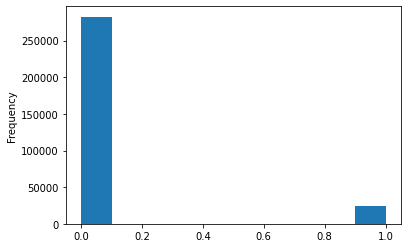

In [ ]:
app_train['TARGET'].astype(int).plot.hist();

From this information, we see this is an [_imbalanced class problem_](http://www.chioka.in/class-imbalance-problem/). There are far more loans that were repaid on time than loans that were not repaid. Once we get into more sophisticated machine learning models, we can [weight the classes](http://xgboost.readthedocs.io/en/latest/parameter.html) by their representation in the data to reflect this imbalance. 

## Examine Missing Values

Next we can look at the number and percentage of missing values in each column. 

In [ ]:
# Function to calculate missing values by column# Funct 
def missing_values_table(df):
        # Total missing values
        mis_val = df.isnull().sum()
        
        # Percentage of missing values
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        # Make a table with the results
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        # Rename the columns
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        
        # Sort the table by percentage of missing descending
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        
        # Print some summary information
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        
        # Return the dataframe with missing information
        return mis_val_table_ren_columns

In [ ]:
# Missing values statistics
missing_values = missing_values_table(app_train)
missing_values.head(20)

Your selected dataframe has 122 columns.
There are 67 columns that have missing values.


,Missing Values,% of Total Values
COMMONAREA_MEDI,214865,69.9
COMMONAREA_AVG,214865,69.9
COMMONAREA_MODE,214865,69.9
NONLIVINGAPARTMENTS_MEDI,213514,69.4
NONLIVINGAPARTMENTS_MODE,213514,69.4
NONLIVINGAPARTMENTS_AVG,213514,69.4
FONDKAPREMONT_MODE,210295,68.4
LIVINGAPARTMENTS_MODE,210199,68.4
LIVINGAPARTMENTS_MEDI,210199,68.4
LIVINGAPARTMENTS_AVG,210199,68.4


When it comes time to build our machine learning models, we will have to fill in these missing values (known as imputation). In later work, we will use models such as XGBoost that can [handle missing values with no need for imputation](https://stats.stackexchange.com/questions/235489/xgboost-can-handle-missing-data-in-the-forecasting-phase). Another option would be to drop columns with a high percentage of missing values, although it is impossible to know ahead of time if these columns will be helpful to our model. Therefore, we will keep all of the columns for now.

In [ ]:
# Missing values statistics
missing_values = missing_values_table(POS_CASH)
missing_values.head(20)

Your selected dataframe has 8 columns.
There are 2 columns that have missing values.


,Missing Values,% of Total Values
CNT_INSTALMENT_FUTURE,26087,0.3
CNT_INSTALMENT,26071,0.3


In [ ]:
# Missing values statistics
missing_values = missing_values_table(previous_application)
missing_values.head(20)

Your selected dataframe has 37 columns.
There are 16 columns that have missing values.


,Missing Values,% of Total Values
RATE_INTEREST_PRIMARY,1664263,99.6
RATE_INTEREST_PRIVILEGED,1664263,99.6
AMT_DOWN_PAYMENT,895844,53.6
RATE_DOWN_PAYMENT,895844,53.6
NAME_TYPE_SUITE,820405,49.1
DAYS_FIRST_DRAWING,673065,40.3
DAYS_FIRST_DUE,673065,40.3
DAYS_LAST_DUE_1ST_VERSION,673065,40.3
DAYS_LAST_DUE,673065,40.3
DAYS_TERMINATION,673065,40.3


In [ ]:
# Missing values statistics
missing_values = missing_values_table(bureau_balance)
missing_values.head(20)

Your selected dataframe has 3 columns.
There are 0 columns that have missing values.


,Missing Values,% of Total Values


In [ ]:
# Missing values statistics
missing_values = missing_values_table(installments_payments)
missing_values.head(20)

Your selected dataframe has 8 columns.
There are 2 columns that have missing values.


,Missing Values,% of Total Values
DAYS_ENTRY_PAYMENT,2905,0.0
AMT_PAYMENT,2905,0.0


0.021352 % de valeurs manquantes

In [ ]:
# Missing values statistics
missing_values = missing_values_table(credit_card_balance)
missing_values.head(20)

Your selected dataframe has 23 columns.
There are 9 columns that have missing values.


,Missing Values,% of Total Values
AMT_PAYMENT_CURRENT,767988,20.0
AMT_DRAWINGS_ATM_CURRENT,749816,19.5
AMT_DRAWINGS_OTHER_CURRENT,749816,19.5
AMT_DRAWINGS_POS_CURRENT,749816,19.5
CNT_DRAWINGS_ATM_CURRENT,749816,19.5
CNT_DRAWINGS_OTHER_CURRENT,749816,19.5
CNT_DRAWINGS_POS_CURRENT,749816,19.5
AMT_INST_MIN_REGULARITY,305236,7.9
CNT_INSTALMENT_MATURE_CUM,305236,7.9


In [ ]:
# Missing values statistics
missing_values = missing_values_table(bureau)
missing_values.head(20)

Your selected dataframe has 17 columns.
There are 7 columns that have missing values.


,Missing Values,% of Total Values
AMT_ANNUITY,1226791,71.5
AMT_CREDIT_MAX_OVERDUE,1124488,65.5
DAYS_ENDDATE_FACT,633653,36.9
AMT_CREDIT_SUM_LIMIT,591780,34.5
AMT_CREDIT_SUM_DEBT,257669,15.0
DAYS_CREDIT_ENDDATE,105553,6.1
AMT_CREDIT_SUM,13,0.0


## Column Types

Let's look at the number of columns of each data type. `int64` and `float64` are numeric variables ([which can be either discrete or continuous](https://stats.stackexchange.com/questions/206/what-is-the-difference-between-discrete-data-and-continuous-data)). `object` columns contain strings and are  [categorical features.](http://support.minitab.com/en-us/minitab-express/1/help-and-how-to/modeling-statistics/regression/supporting-topics/basics/what-are-categorical-discrete-and-continuous-variables/) . 

In [ ]:
#Colonnes
for i in app_train.columns:
  print(i)

SK_ID_CURR
TARGET
NAME_CONTRACT_TYPE
CODE_GENDER
FLAG_OWN_CAR
FLAG_OWN_REALTY
CNT_CHILDREN
AMT_INCOME_TOTAL
AMT_CREDIT
AMT_ANNUITY
AMT_GOODS_PRICE
NAME_TYPE_SUITE
NAME_INCOME_TYPE
NAME_EDUCATION_TYPE
NAME_FAMILY_STATUS
NAME_HOUSING_TYPE
REGION_POPULATION_RELATIVE
DAYS_BIRTH
DAYS_EMPLOYED
DAYS_REGISTRATION
DAYS_ID_PUBLISH
OWN_CAR_AGE
FLAG_MOBIL
FLAG_EMP_PHONE
FLAG_WORK_PHONE
FLAG_CONT_MOBILE
FLAG_PHONE
FLAG_EMAIL
OCCUPATION_TYPE
CNT_FAM_MEMBERS
REGION_RATING_CLIENT
REGION_RATING_CLIENT_W_CITY
WEEKDAY_APPR_PROCESS_START
HOUR_APPR_PROCESS_START
REG_REGION_NOT_LIVE_REGION
REG_REGION_NOT_WORK_REGION
LIVE_REGION_NOT_WORK_REGION
REG_CITY_NOT_LIVE_CITY
REG_CITY_NOT_WORK_CITY
LIVE_CITY_NOT_WORK_CITY
ORGANIZATION_TYPE
EXT_SOURCE_1
EXT_SOURCE_2
EXT_SOURCE_3
APARTMENTS_AVG
BASEMENTAREA_AVG
YEARS_BEGINEXPLUATATION_AVG
YEARS_BUILD_AVG
COMMONAREA_AVG
ELEVATORS_AVG
ENTRANCES_AVG
FLOORSMAX_AVG
FLOORSMIN_AVG
LANDAREA_AVG
LIVINGAPARTMENTS_AVG
LIVINGAREA_AVG
NONLIVINGAPARTMENTS_AVG
NONLIVINGAREA_AVG
APART

In [ ]:
# Number of each type of column
app_train.dtypes.value_counts()

float64    65
int64      41
object     16
dtype: int64

Let's now look at the number of unique entries in each of the `object` (categorical) columns.

In [ ]:
# Number of unique classes in each object column
app_train.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

Most of the categorical variables have a relatively small number of unique entries. We will need to find a way to deal with these categorical variables! 

## Data Exploration/Data Viz

### 1. AMT_CREDIT

Text(0.5, 1.0, 'Distribution of AMT_CREDIT')

<Figure size 864x360 with 0 Axes>

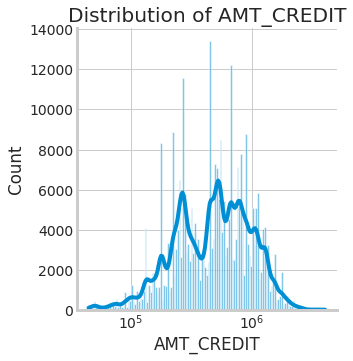

In [ ]:
plt.figure(figsize=(12,5))
sns.displot(data=app_train["AMT_CREDIT"],kde=True,log_scale=True)
plt.title("Distribution of AMT_CREDIT")

### 2. AMT_INCOME_TOTAL

Text(0.5, 1.0, 'Distribution of AMT_INCOME_TOTAL')

<Figure size 864x360 with 0 Axes>

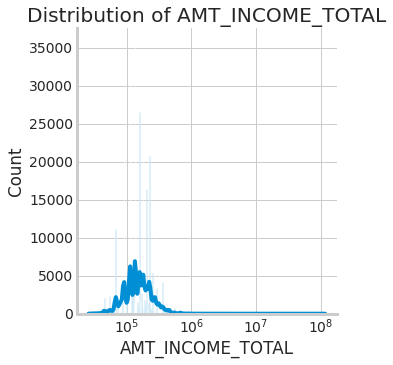

In [ ]:
plt.figure(figsize=(12,5))
sns.displot(app_train["AMT_INCOME_TOTAL"],kde=True,log_scale=True)
plt.title("Distribution of AMT_INCOME_TOTAL")

### 3. AMT_GOODS_PRICE

Text(0.5, 1.0, 'Distribution of AMT_GOODS_PRICE')

<Figure size 864x360 with 0 Axes>

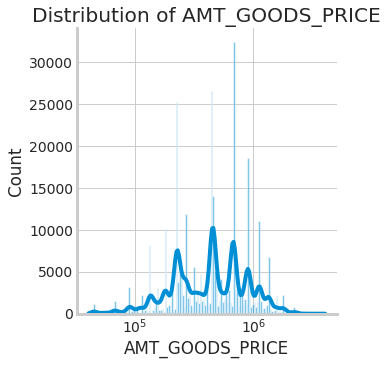

In [ ]:
plt.figure(figsize=(12,5))
sns.displot(app_train["AMT_GOODS_PRICE"],kde=True,log_scale=True)
plt.title("Distribution of AMT_GOODS_PRICE")

### 4. NAME_TYPE_SUITE
Qui accompagne le client quand ils candidatent? 

In [ ]:
fig = px.bar(x = temp.index,
    y = (temp / temp.sum())*100)
HTML(fig.to_html())

In [ ]:
temp = app_train["NAME_TYPE_SUITE"].value_counts()
#print("Total number of states : ",len(temp))
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
)
data = [trace]
layout = go.Layout(
    title = "Who accompanied client when applying for the  application in % ",
    xaxis=dict(
        title='Name of type of the Suite',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count of Name of type of the Suite in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

### 5. Data is balanced or imbalanced ? 

In [ ]:
temp = app_train["TARGET"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Loan Repayed or not')
fig.show(renderer='colab')

### 6. NAME_CONTRACT_TYPE : Type de prêts

* Rovolving loans : Arrangement which * allows for the loan amount to be withdrawn, repaid, and redrawn again in any manner and any number of times, until the arrangement expires. Credit card loans and overdrafts are revolving loans. Also called evergreen loan

In [ ]:
temp = app_train["NAME_CONTRACT_TYPE"].value_counts()
fig_set = {
  "data": [
    {
      "values": temp.values,
      "labels": temp.index,
      "domain": {"x": [0, .48]},
      #"name": "Types of Loans",
      #"hoverinfo":"label+percent+name",
      "hole": .7,
      "type": "pie"
    },
    
    ],
  "layout": {
        "title":"Types of loan",
        "annotations": [
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text": "",
                "x": 0.17,
                "y": 0.5
            }
            
        ]
    }
}
fig = go.Figure(fig_set)
fig.show(renderer='colab')

90.5% des prêts sont des "Cash loans"

### 7. FLAG_OWN_CAR, FLAG_OWN_REALTY : Purpose of loan

In [ ]:
temp1 = app_train["FLAG_OWN_CAR"].value_counts()
temp2 = app_train["FLAG_OWN_REALTY"].value_counts()
fig_set2 = {
  "data": [{
      "values": temp2.values,
      "labels": temp2.index,
      "domain": {"x": [.52, 1]},
      "name": "Own Reality",
      "hoverinfo":"label+percent+name",
      "hole": .6,
      "type": "pie"
    }],
  "layout": {
        "title":"Purpose of loan",
        "annotations": [
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text": "Own Realty",
                "x": 0.8,
                "y": 0.5
            }
        ]
    }
}
fig_set1 = {
  "data": [
    {
      "values": temp1.values,
      "labels": temp1.index,
      "domain": {"x": [0, .48]},
      "name": "Own Car",
      "hoverinfo":"label+percent+name",
      "hole": .6,
      "type": "pie"
    }
  ],
    "layout": {
        "title":"Purpose of loan",
        "annotations": [
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text": "Own Car",
                "x": 0.20,
                "y": 0.5
            },
        ]
    }
}
    

fig1 = go.Figure(fig_set1)
fig1.show(renderer='colab')
fig2 = go.Figure(fig_set2)
fig2.show(renderer='colab')

### 8. Source de revenus pour ceux qui demandent un prêt

In [ ]:
temp = app_train["NAME_INCOME_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Source de revenus pour les demandeurs',hole=0.5)
fig.show(renderer='colab')

* 51.6 % Applicants mentioned that they are working.  23.3 % are Commercial Associate and 18 % are Pensioner etc.

9. NAME_FAMILY_STATUS :  Statut familial pour ceux qui demandent un prêt

In [ ]:
temp = app_train["NAME_FAMILY_STATUS"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Statut familial pour les demandeurs',hole=0.5)
fig.show(renderer='colab')

63,9% des demandeurs sont mariés et 14,8% sont célibataires ou non mariés. 

10. OCCUPATION_TYPE : Emploi du demandeur

In [ ]:
temp = app_train["OCCUPATION_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.bar(df,x="labels", y="values", title='Emploi des demandeurs',labels={"values": "Count", "labels": "Occupation"})
fig.show(renderer='colab')

In [ ]:
temp = app_train["OCCUPATION_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Emploi des demandeurs',hole=0.5)
fig.show(renderer='colab')

* **Top 5 des demandeurs de prêts :**
  * Laborers - Approx. 55 K
  * Sales Staff - Approx. 32 K
  * Core staff - Approx. 28 K
  * Managers - Approx. 21 K
  * Drivers - Approx. 19 K

### 11. NAME_EDUCATION_TYPE : Education des demandeurs

In [ ]:
temp = app_train["NAME_EDUCATION_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Education des demandeurs',hole=0.5)
fig.show(renderer='colab')

71% des demandeurs ont un niveau "secondary" soit lycée. 
24.3% ont un niveau "higher education"

12. NAME_HOUSING_TYPE : Pour quel type de maison demandent-ils un prêt? 



In [ ]:
temp = app_train["NAME_HOUSING_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Type de maison demandé',hole=0.5)
fig.show(renderer='colab')

88.7% des personnes demandant un prêt souhaitent une maison/appartement

13. ORGANIZATION_TYPE : Type d'organisation qui demandent un prêt 

In [ ]:
temp = app_train["ORGANIZATION_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.bar(df,x="labels", y="values", title="Type d'organisation",labels={"values": "Count", "labels": "Occupation"})
fig.show(renderer='colab')

### 14. Exploration autour de si le prêt est remboursé ou non (TARGET)

#### 14.1 : Sources de revenus VS TARGET

In [ ]:
temp = app_train["NAME_INCOME_TYPE"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["NAME_INCOME_TYPE"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["NAME_INCOME_TYPE"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = (temp_y1 / temp.sum()) * 100,
    name='NO'
)
trace2 = go.Bar(
    x = temp.index,
    y = (temp_y0 / temp.sum()) * 100, 
    name='YES'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Income sources of Applicant's in terms of loan is repayed or not  in %",
    #barmode='stack',
    width = 1000,
    xaxis=dict(
        title='Income source',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

#### 14.2 : Statut familial selon la target

In [ ]:
app_train["NAME_FAMILY_STATUS"].value_counts()

Married                 196432
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Unknown                      2
Name: NAME_FAMILY_STATUS, dtype: int64

In [ ]:
temp = app_train["NAME_FAMILY_STATUS"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["NAME_FAMILY_STATUS"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["NAME_FAMILY_STATUS"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = (temp_y1 / temp.sum()) * 100,
    name='NO'
)
trace2 = go.Bar(
    x = temp.index,
    y = (temp_y0 / temp.sum()) * 100, 
    name='YES'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Family Status of Applicant's in terms of loan is repayed or not in %",
    #barmode='stack',
    width = 1000,
    xaxis=dict(
        title='Family Status',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

#### 14.3 Emploi du demandeur selon la target

In [ ]:
temp = app_train["OCCUPATION_TYPE"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
count_occ = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["OCCUPATION_TYPE"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["OCCUPATION_TYPE"]==val] == 0))
    count_occ.append(np.sum([app_train["OCCUPATION_TYPE"]==val]))
trace1 = go.Bar(
    x = (temp_y1 / pd.Series(count_occ)) * 100,
    y = temp.index,
    orientation='h',
    name='NO'
)
trace2 = go.Bar(
    x = (temp_y0 /  pd.Series(count_occ)) * 100,
    y = temp.index, 
    orientation='h',
    name='YES'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Occupation of Applicant's in terms of loan is repayed or not in %",
    #Barmode=stack permet d'avoir des graphiques empilés
    barmode='stack',
    width = 1000,
    xaxis=dict(
        title='Pourcentage',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Emploi du demandeur',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

In [ ]:
occ_by_target = pd.DataFrame(app_train.groupby(["TARGET", "OCCUPATION_TYPE"])["OCCUPATION_TYPE"].count())
df = pd.DataFrame({'count': occ_by_target["OCCUPATION_TYPE"]})
df = df.reset_index()

In [ ]:
fig = px.bar(df,x="TARGET", y="count", color="OCCUPATION_TYPE", title="Nombre de prêts payés/non-payés selon l'emploi")
fig.show(renderer='colab')

In [ ]:
fig = px.bar(df[df["TARGET"]==0],x="OCCUPATION_TYPE", y="count",  title="Nombre de prêts payés selon l'emploi")
fig.show(renderer='colab')

In [ ]:
fig = px.pie(df[df["TARGET"]==0], values='count', names='OCCUPATION_TYPE', title="Pourcentage de prêts payés selon l'emploi",hole=0.5)
fig.show(renderer='colab')

fig = px.pie(df[df["TARGET"]==1], values='count', names='OCCUPATION_TYPE', title="Pourcentage de prêts non-payés selon l'emploi",hole=0.5)
fig.show(renderer='colab')

In [ ]:
fig = px.bar(df[df["TARGET"]==1],x="OCCUPATION_TYPE", y="count",  title="Nombre de prêts non-payés selon l'emploi")
fig.show(renderer='colab')

#### 14.4 Education du demandeur selon la target

In [ ]:
temp = app_train["NAME_EDUCATION_TYPE"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["NAME_EDUCATION_TYPE"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["NAME_EDUCATION_TYPE"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = (temp_y1 / temp.sum()) * 100,
    name='NO'
)
trace2 = go.Bar(
    x = temp.index,
    y = (temp_y0 / temp.sum()) * 100, 
    name='YES'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Education of Applicant's in terms of loan is repayed or not in %",
    #barmode='stack',
    width = 1000,
    xaxis=dict(
        title='Education of Applicant\'s',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

#### 14.5 Pour quel type de maison les demandeurs ont-ils demandé un prêt et combien en % l'ont remboursé ou non?

In [ ]:
temp = app_train["NAME_HOUSING_TYPE"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["NAME_HOUSING_TYPE"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["NAME_HOUSING_TYPE"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = (temp_y1 / temp.sum()) * 100,
    name='NO'
)
trace2 = go.Bar(
    x = temp.index,
    y = (temp_y0 / temp.sum()) * 100, 
    name='YES'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "For which types of house higher applicant's applied for loan in terms of loan is repayed or not in %",
    #barmode='stack',
    width = 1000,
    xaxis=dict(
        title='types of house',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

#### 14.6 Types d'organisation en termes de prêts remboursés ou non

In [ ]:
temp = app_train["ORGANIZATION_TYPE"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["ORGANIZATION_TYPE"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["ORGANIZATION_TYPE"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = (temp_y1 / temp.sum()) * 100,
    name='YES'
)
trace2 = go.Bar(
    x = temp.index,
    y = (temp_y0 / temp.sum()) * 100, 
    name='NO'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Types of Organizations in terms of loan is repayed or not in %",
    #barmode='stack',
    width = 1000,
    xaxis=dict(
        title='Types of Organizations',
        tickfont=dict(
            size=10,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

#### 14.7 Distribution of Name of type of the Suite in terms of loan is repayed or not in %

In [ ]:
temp = app_train["NAME_TYPE_SUITE"].value_counts()
#print(temp.values)
temp_y0 = []
temp_y1 = []
for val in temp.index:
    temp_y1.append(np.sum(app_train["TARGET"][app_train["NAME_TYPE_SUITE"]==val] == 1))
    temp_y0.append(np.sum(app_train["TARGET"][app_train["NAME_TYPE_SUITE"]==val] == 0))    
trace1 = go.Bar(
    x = temp.index,
    y = (temp_y1 / temp.sum()) * 100,
    name='YES'
)
trace2 = go.Bar(
    x = temp.index,
    y = (temp_y0 / temp.sum()) * 100, 
    name='NO'
)

data = [trace1, trace2]
layout = go.Layout(
    title = "Distribution of Name of type of the Suite in terms of loan is repayed or not in %",
    #barmode='stack',
    width = 1000,
    xaxis=dict(
        title='Name of type of the Suite',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)

fig = go.Figure(data=data, layout=layout)
fig.show(renderer='colab')

### Exploration des demandes précédentes

#### 15.1 Type de contract lors des demandes précédentes

In [ ]:
temp = previous_application["NAME_CONTRACT_TYPE"].value_counts()
fig = {
  "data": [
    {
      "values": temp.values,
      "labels": temp.index,
      "domain": {"x": [0, .48]},
      #"name": "Types of Loans",
      #"hoverinfo":"label+percent+name",
      "hole": .7,
      "type": "pie"
    },
    
    ],
  "layout": {
        "title":"Contract product type of previous application",
        "annotations": [
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text": "Contract product type",
                "x": 0.12,
                "y": 0.5
            }
            
        ]
    }
}
fig = go.Figure(data=[go.Pie(labels=temp.index,
                             values=temp.values)])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20)
fig.show()

* **Contract product type of previous application :**
  * Cash loans - 44.8 %
  * Consumer loans - 43.7 %
  * Rovolving loan - 11.6 %
  * XNA - 0.0207 %

#### 15.2 Quel jour il y a eu le plus grand nombre de demandes dans les précédentes demandes ?

In [ ]:
temp = previous_application["WEEKDAY_APPR_PROCESS_START"].value_counts()
#print("Total number of states : ",len(temp))
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
)
data = [trace]
layout = go.Layout(
    title = "On which day highest number of clients applied in prevoies application in % ",
    xaxis=dict(
        title='Day of the Week',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count of Day of Week in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

* What a coincedence, Approximately 15 % clients applied in each 5 days a week i.e, Tuesday, Wednesday, Monday, Friday and Thrusday. 

#### Raison du prêt dans les demandes précédentes

In [ ]:
temp = previous_application["NAME_CASH_LOAN_PURPOSE"].value_counts()
#print("Total number of states : ",len(temp))
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
    marker=dict(
        color=(temp / temp.sum())*100,
        colorscale = 'Blues',
        reversescale = True
    ),
)
data = [trace]
layout = go.Layout(
    title = "Purpose of cash loan in previous application in % ",
    xaxis=dict(
        title='Purpose of cash loan',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

* **Main purpose of the cash loan was  :**
  * XAP - 55 %
  * XNA - 41 %

#### 15.4 Contract was approved or not in previous application</a>

In [ ]:
temp = previous_application["NAME_CONTRACT_STATUS"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Contrat approuvé ou non lors des demandes précédentes', hole = 0.5)
fig.show()

* **Contract was approved or not in previous application :**
  * Approved : 62.1 % times
  * Cancelled : 18.9 % times
  * Refused : 17.4 % times 
  * Unused offer : 1.58 % times

#### 15.5 Méthode de paiement choisie lors des précédentes demandes

In [ ]:
temp = previous_application["NAME_PAYMENT_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Méthode de paiement choisie lors des demandes précédentes', hole = 0.5)
fig.show()

* As we can most of the payment(61.9 %) has done thorugh cash only. 

#### 15.6 Pourquoi la précédente demande a été rejetée

In [ ]:
temp = previous_application["CODE_REJECT_REASON"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.bar(df,x="labels", y="values", title='Raison du rejet de la précédente demande',labels={"values": "Count", "labels": "Raison du rejet"})
fig.show(renderer='colab')

#### 15.7 Qui accompaganait le client lors de la précédente demande ?

In [ ]:
temp = previous_application["NAME_TYPE_SUITE"].value_counts()
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
    marker=dict(
        color=(temp / temp.sum())*100
        #colorscale = ['#ea7c96']
        #reversescale = True
    ),
)
data = [trace]
layout = go.Layout(
    title = "Qui accompagnait le client lors de la demande précédente (en %)",
    xaxis=dict(
        title="Type d'accompagnant",
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

* **Who accompanied client when applying for the previous application :**
  * Unaccompanied : Approx. 60 % times
  * Family : Approx. 25 % times
  * Spouse, Partner : Approx. 8 %
  * Childrens : Approx. 4 %

#### Est-ce-qu'il s'agissait d'un nouveau client lors de la précédente demande ?

In [ ]:
temp = previous_application["NAME_CLIENT_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Type de client lors de la demande précédente', hole = 0.5)
fig.show()

* Approximately 74 % was repeater clients who applied for previous application.

#### Pour quels types de biens le client a fait sa précédente demande? 

In [ ]:
temp = previous_application["NAME_GOODS_CATEGORY"].value_counts()
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
    marker=dict(
        color=(temp / temp.sum())*100,
        colorscale = 'Greens',
        reversescale = True
    ),
)
data = [trace]
layout = go.Layout(
    title = "What kind of goods did the client apply for in the previous application in % ",
    xaxis=dict(
        title='Name of the goods',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

#### 15.10 La précédente demande était pour CASH, POS, CAR, …

In [ ]:
temp = previous_application["NAME_PORTFOLIO"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Type de portefeuille', hole = 0.5)
fig.show()

#### 15.11 La précedente demande était x-sell ou walk-in ?</a>

'x-sell' is a short form for 'cross sell'. Means that the buyer had already brought some other product from HomeCredit Group and then this credit was sold as a second related or similar product to the buyer.

'Walk-in' means - the customer walked into Home credit branch on his own and applied for the credit.

In [ ]:
temp = previous_application["NAME_PRODUCT_TYPE"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Type de la demande précédente', hole = 0.5)
fig.show()

#### 15.12 Top channels  through which they acquired the client on the previous application</a>

In [ ]:
temp = previous_application["CHANNEL_TYPE"].value_counts()
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
    marker=dict(
        color=(temp / temp.sum())*100,
#         colorscale = 'Violet',
#         reversescale = True
    ),
)
data = [trace]
layout = go.Layout(
    title = "Top channels  through which they acquired the client on the previous application in % ",
    xaxis=dict(
        title='Name of the Channel',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

* **Top channels  through which they acquired the client on the previous application :**
  * Credidit and cash offices : 43 % times
  * Country_wide : 30 % times
  * Stone : 13 % times

#### 15.13 Top industry of the seller

In [ ]:
temp = previous_application["NAME_SELLER_INDUSTRY"].value_counts()
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
    marker=dict(
        color=(temp / temp.sum())*100,
        colorscale = 'Greens',
        reversescale = True
    ),
)
data = [trace]
layout = go.Layout(
    title = "Top industry of the seller in % ",
    xaxis=dict(
        title='Industry Name',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

#### 15.14 Grouped interest rate into small medium and high of the previous application

In [ ]:
temp = previous_application["NAME_YIELD_GROUP"].value_counts()
trace = go.Bar(
    x = temp.index,
    y = (temp / temp.sum())*100,
    marker=dict(
        color=(temp / temp.sum())*100,
        colorscale = 'Greens',
        reversescale = True
    ),
)
data = [trace]
layout = go.Layout(
    title = "Grouped interest rate into small medium and high of the previous application in % ",
    xaxis=dict(
        title='Grouped Interest rate',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count in %',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

#### 15.15 Top Detailed product combination of the previous application

In [ ]:
temp = previous_application["PRODUCT_COMBINATION"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title='Top de combinaison de produits lors de la précédente demande', hole = 0.5)
fig.show()

#### 15.16 Did the client requested insurance during the previous application</a>

In [ ]:
temp = previous_application["NFLAG_INSURED_ON_APPROVAL"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'values': temp.values
                  })
fig = px.pie(df, values='values', names='labels', title="Demande d'assurance lors de la précédente demande", hole = 0.5)
fig.show()

## Encoding Categorical Variables

Before we go any further, we need to deal with pesky categorical variables.  A machine learning model unfortunately cannot deal with categorical variables (except for some models such as [LightGBM](http://lightgbm.readthedocs.io/en/latest/Features.html)). Therefore, we have to find a way to encode (represent) these variables as numbers before handing them off to the model. There are two main ways to carry out this process:

* Label encoding: assign each unique category in a categorical variable with an integer. No new columns are created. An example is shown below

![image](https://raw.githubusercontent.com/WillKoehrsen/Machine-Learning-Projects/master/label_encoding.png)

* One-hot encoding: create a new column for each unique category in a categorical variable. Each observation recieves a 1 in the column for its corresponding category and a 0 in all other new columns. 

![image](https://raw.githubusercontent.com/WillKoehrsen/Machine-Learning-Projects/master/one_hot_encoding.png)

The problem with label encoding is that it gives the categories an arbitrary ordering. The value assigned to each of the categories is random and does not reflect any inherent aspect of the category. In the example above, programmer recieves a 4 and data scientist a 1, but if we did the same process again, the labels could be reversed or completely different. The actual assignment of the integers is arbitrary. Therefore, when we perform label encoding, the model might use the relative value of the feature (for example programmer = 4 and data scientist = 1) to assign weights which is not what we want. If we only have two unique values for a categorical variable (such as Male/Female), then label encoding is fine, but for more than 2 unique categories, one-hot encoding is the safe option.

There is some debate about the relative merits of these approaches, and some models can deal with label encoded categorical variables with no issues. [Here is a good Stack Overflow discussion](https://datascience.stackexchange.com/questions/9443/when-to-use-one-hot-encoding-vs-labelencoder-vs-dictvectorizor). I think (and this is just a personal opinion) for categorical variables with many classes, one-hot encoding is the safest approach because it does not impose arbitrary values to categories. The only downside to one-hot encoding is that the number of features (dimensions of the data) can explode with categorical variables with many categories. To deal with this, we can perform one-hot encoding followed by [PCA](http://www.cs.otago.ac.nz/cosc453/student_tutorials/principal_components.pdf) or other [dimensionality reduction methods](https://www.analyticsvidhya.com/blog/2015/07/dimension-reduction-methods/) to reduce the number of dimensions (while still trying to preserve information). 

In this notebook, we will use Label Encoding for any categorical variables with only 2 categories and One-Hot Encoding for any categorical variables with more than 2 categories. This process may need to change as we get further into the project, but for now, we will see where this gets us. (We will also not use any dimensionality reduction in this notebook but will explore in future iterations).

### Label Encoding and One-Hot Encoding

Let's implement the policy described above: for any categorical variable (`dtype == object`) with 2 unique categories, we will use label encoding, and for any categorical variable with more than 2 unique categories, we will use one-hot encoding. 

For label encoding, we use the Scikit-Learn `LabelEncoder` and for one-hot encoding, the pandas `get_dummies(df)` function.

In [ ]:
# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in app_train:
    if app_train[col].dtype == 'object':
        # If 2 or fewer unique categories
        if len(list(app_train[col].unique())) <= 2:
            print(col)
            # Train on the training data
            le.fit(app_train[col])
            # Transform both training and testing data
            app_train[col] = le.transform(app_train[col])
            app_test[col] = le.transform(app_test[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            
print('%d columns were label encoded.' % le_count)

NAME_CONTRACT_TYPE
FLAG_OWN_CAR
FLAG_OWN_REALTY
3 columns were label encoded.


In [ ]:
# one-hot encoding of categorical variables
app_train = pd.get_dummies(app_train)
app_test = pd.get_dummies(app_test)

print('Training Features shape: ', app_train.shape)
print('Testing Features shape: ', app_test.shape)

Training Features shape:  (307511, 243)
Testing Features shape:  (48744, 239)


In [ ]:
app_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,...,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security Ministries,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade: type 1,ORGANIZATION_TYPE_Trade: type 2,ORGANIZATION_TYPE_Trade: type 3,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University,ORGANIZATION_TYPE_XNA,FONDKAPREMONT_MODE_not specified,FONDKAPREMONT_MODE_org spec account,FONDKAPREMONT_MODE_reg oper account,FONDKAPREMONT_MODE_reg oper spec account,HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,100002,1,0,0,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0
1,100003,0,0,0,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,...,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,1,0
2,100004,0,1,1,1,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,0,1,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,2.0,2,2,17,0,0,0,0,0,0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,0,1,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,11,0,0,0,0,1,1,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Aligning Training and Testing Data

There need to be the same features (columns) in both the training and testing data. One-hot encoding has created more columns in the training data because there were some categorical variables with categories not represented in the testing data. To remove the columns in the training data that are not in the testing data, we need to `align` the dataframes. First we extract the target column from the training data (because this is not in the testing data but we need to keep this information). When we do the align, we must make sure to set `axis = 1` to align the dataframes based on the columns and not on the rows!

In [ ]:
app_train.columns.difference(app_test.columns)

Index(['CODE_GENDER_XNA', 'NAME_FAMILY_STATUS_Unknown',
       'NAME_INCOME_TYPE_Maternity leave', 'TARGET'],
      dtype='object')

In [ ]:
train_labels = app_train['TARGET']

# Align the training and testing data, keep only columns present in both dataframes
app_train, app_test = app_train.align(app_test, join = 'inner', axis = 1)

# Add the target back in
app_train['TARGET'] = train_labels

print('Training Features shape: ', app_train.shape)
print('Testing Features shape: ', app_test.shape)

Training Features shape:  (307511, 240)
Testing Features shape:  (48744, 239)


The training and testing datasets now have the same features which is required for machine learning. The number of features has grown significantly due to one-hot encoding. At some point we probably will want to try [dimensionality reduction (removing features that are not relevant)](https://en.wikipedia.org/wiki/Dimensionality_reduction) to reduce the size of the datasets.

## Back to Exploratory Data Analysis

### Anomalies

One problem we always want to be on the lookout for when doing EDA is anomalies within the data. These may be due to mis-typed numbers, errors in measuring equipment, or they could be valid but extreme measurements. One way to support anomalies quantitatively is by looking at the statistics of a column using the `describe` method. The numbers in the `DAYS_BIRTH` column are negative because they are recorded relative to the current loan application. To see these stats in years, we can mutliple by -1 and divide by the number of days in a year:



In [ ]:
(app_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

Those ages look reasonable. There are no outliers for the age on either the high or low end. How about the days of employment? 

In [ ]:
app_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

That doesn't look right! The maximum value (besides being positive) is about 1000 years! 

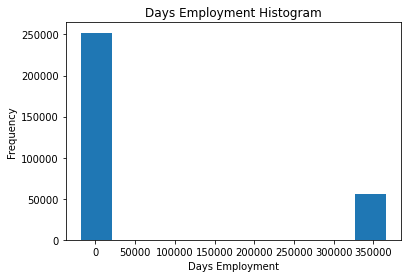

In [ ]:
app_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

Just out of curiousity, let's subset the anomalous clients and see if they tend to have higher or low rates of default than the rest of the clients.

In [ ]:
anom = app_train[app_train['DAYS_EMPLOYED'] == 365243]
non_anom = app_train[app_train['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans' % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.66% of loans
The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


Well that is extremely interesting! It turns out that the anomalies have a lower rate of default. 

Handling the anomalies depends on the exact situation, with no set rules. One of the safest approaches is just to set the anomalies to a missing value and then have them filled in (using Imputation) before machine learning. In this case, since all the anomalies have the exact same value, we want to fill them in with the same value in case all of these loans share something in common. The anomalous values seem to have some importance, so we want to tell the machine learning model if we did in fact fill in these values. As a solution, we will fill in the anomalous values with not a number (`np.nan`) and then create a new boolean column indicating whether or not the value was anomalous.



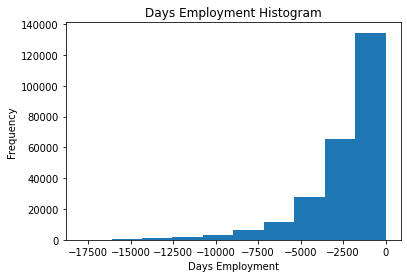

In [ ]:
# Create an anomalous flag column
app_train['DAYS_EMPLOYED_ANOM'] = app_train["DAYS_EMPLOYED"] == 365243

# Replace the anomalous values with nan
app_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

app_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

The distribution looks to be much more in line with what we would expect, and we also have created a new column to tell the model that these values were originally anomalous (becuase we will have to fill in the nans with some value, probably the median of the column). The other columns with `DAYS` in the dataframe look to be about what we expect with no obvious outliers. 

As an extremely important note, anything we do to the training data we also have to do to the testing data. Let's make sure to create the new column and fill in the existing column with `np.nan` in the testing data.

In [ ]:
app_test['DAYS_EMPLOYED_ANOM'] = app_test["DAYS_EMPLOYED"] == 365243
app_test["DAYS_EMPLOYED"].replace({365243: np.nan}, inplace = True)

print('There are %d anomalies in the test data out of %d entries' % (app_test["DAYS_EMPLOYED_ANOM"].sum(), len(app_test)))

There are 9274 anomalies in the test data out of 48744 entries


### Correlations

Now that we have dealt with the categorical variables and the outliers, let's continue with the EDA. One way to try and understand the data is by looking for correlations between the features and the target. We can calculate the Pearson correlation coefficient between every variable and the target using the `.corr` dataframe method.

The correlation coefficient is not the greatest method to represent "relevance" of a feature, but it does give us an idea of possible relationships within the data. Some [general interpretations of the absolute value of the correlation coefficent](http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf) are:


* .00-.19 “very weak”
*  .20-.39 “weak”
*  .40-.59 “moderate”
*  .60-.79 “strong”
* .80-1.0 “very strong”


In [ ]:
# Find correlations with the target and sort
correlations = app_train.corr()['TARGET'].sort_values()

# Display correlations
print('Most Positive Correlations:\n', correlations.tail(15))
print('\nMost Negative Correlations:\n', correlations.head(15))

Most Positive Correlations:
 OCCUPATION_TYPE_Laborers                             0.043019
FLAG_DOCUMENT_3                                      0.044346
REG_CITY_NOT_LIVE_CITY                               0.044395
FLAG_EMP_PHONE                                       0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
REGION_RATING_CLIENT                                 0.058899
REGION_RATING_CLIENT_W_CITY                          0.060893
DAYS_EMPLOYED                                        0.074958
DAYS_BIRTH                                           0.078239
TARGET                                               1.000000
Name: TARGET, dtype: float64

Most Negati

Let's take a look at some of more significant correlations: the `DAYS_BIRTH` is the most positive correlation. (except for `TARGET` because the correlation of a variable with itself is always 1!) Looking at the documentation, `DAYS_BIRTH` is the age in days of the client at the time of the loan in negative days (for whatever reason!). The correlation is positive, but the value of this feature is actually negative, meaning that as the client gets older, they are less likely to default on their loan (ie the target == 0). That's a little confusing, so we will take the absolute value of the feature and then the correlation will be negative.

### Effect of Age on Repayment

In [ ]:
# Find the correlation of the positive days since birth and target
app_train['DAYS_BIRTH'] = abs(app_train['DAYS_BIRTH'])
app_train['DAYS_BIRTH'].corr(app_train['TARGET'])

-0.07823930830982694

As the client gets older, there is a negative linear relationship with the target meaning that as clients get older, they tend to repay their loans on time more often. 

Let's start looking at this variable. First, we can make a histogram of the age. We will put the x axis in years to make the plot a little more understandable.

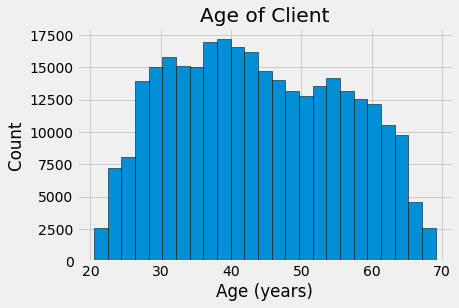

In [ ]:
# Set the style of plots
plt.style.use('fivethirtyeight')

# Plot the distribution of ages in years
plt.hist(app_train['DAYS_BIRTH'] / 365, edgecolor = 'k', bins = 25)
plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');

By itself, the distribution of age does not tell us much other than that there are no outliers as all the ages are reasonable. To visualize the effect of the age on the target, we will next make a [kernel density estimation plot](https://en.wikipedia.org/wiki/Kernel_density_estimation) (KDE) colored by the value of the target. A [kernel density estimate plot shows the distribution of a single variable](https://chemicalstatistician.wordpress.com/2013/06/09/exploratory-data-analysis-kernel-density-estimation-in-r-on-ozone-pollution-data-in-new-york-and-ozonopolis/) and can be thought of as a smoothed histogram (it is created by computing a kernel, usually a Gaussian, at each data point and then averaging all the individual kernels to develop a single smooth curve). We will use the seaborn `kdeplot` for this graph.

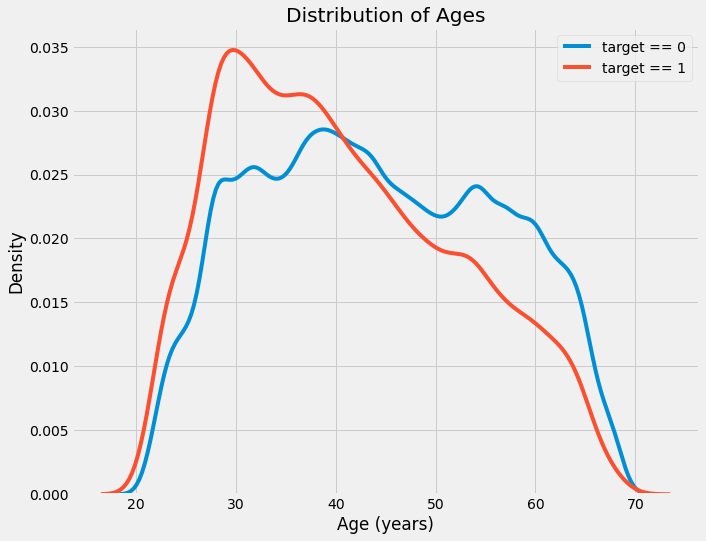

In [ ]:
plt.figure(figsize = (10, 8))

# KDE plot of loans that were repaid on time
sns.kdeplot(app_train.loc[app_train['TARGET'] == 0, 'DAYS_BIRTH'] / 365, label = 'target == 0')

# KDE plot of loans which were not repaid on time
sns.kdeplot(app_train.loc[app_train['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label = 'target == 1')

# Labeling of plot
plt.xlabel('Age (years)'); plt.ylabel('Density'); plt.title('Distribution of Ages');
plt.legend(['target == 0','target == 1'])

The target == 1 curve skews towards the younger end of the range. Although this is not a significant correlation (-0.07 correlation coefficient), this variable is likely going to be useful in a machine learning model because it does affect the target. Let's look at this relationship in another way: average failure to repay loans by age bracket. 

To make this graph, first we `cut` the age category into bins of 5 years each. Then, for each bin, we calculate the average value of the target, which tells us the ratio of loans that were not repaid in each age category.

In [ ]:
# Age information into a separate dataframe
age_data = app_train[['TARGET', 'DAYS_BIRTH']]
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

# Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))
age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,1,9461,25.920548,"(25.0, 30.0]"
1,0,16765,45.931507,"(45.0, 50.0]"
2,0,19046,52.180822,"(50.0, 55.0]"
3,0,19005,52.068493,"(50.0, 55.0]"
4,0,19932,54.608219,"(50.0, 55.0]"
5,0,16941,46.413699,"(45.0, 50.0]"
6,0,13778,37.747945,"(35.0, 40.0]"
7,0,18850,51.643836,"(50.0, 55.0]"
8,0,20099,55.065753,"(55.0, 60.0]"
9,0,14469,39.641096,"(35.0, 40.0]"


In [ ]:
# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111436,10155.219250,27.822518
"(30.0, 35.0]",0.102814,11854.848377,32.479037
"(35.0, 40.0]",0.089414,13707.908253,37.555913
"(40.0, 45.0]",0.078491,15497.661233,42.459346
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055314,20984.262742,57.491131
"(60.0, 65.0]",0.052737,22780.547460,62.412459


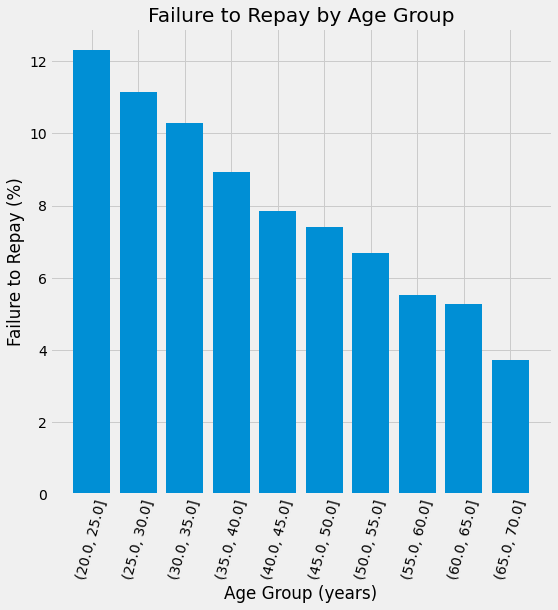

In [ ]:
plt.figure(figsize = (8, 8))

# Graph the age bins and the average of the target as a bar plot
plt.bar(age_groups.index.astype(str), 100 * age_groups['TARGET'])

# Plot labeling
plt.xticks(rotation = 75); plt.xlabel('Age Group (years)'); plt.ylabel('Failure to Repay (%)')
plt.title('Failure to Repay by Age Group');

There is a clear trend: younger applicants are more likely to not repay the loan! The rate of failure to repay is above 10% for the youngest three age groups and beolow 5% for the oldest age group.

This is information that could be directly used by the bank: because younger clients are less likely to repay the loan, maybe they should be provided with more guidance or financial planning tips. This does not mean the bank should discriminate against younger clients, but it would be smart to take precautionary measures to help younger clients pay on time.

### Exterior Sources

The 3 variables with the strongest negative correlations with the target are `EXT_SOURCE_1`, `EXT_SOURCE_2`, and `EXT_SOURCE_3`.
According to the documentation, these features represent a "normalized score from external data source". I'm not sure what this exactly means, but it may be a cumulative sort of credit rating made using numerous sources of data. 

Let's take a look at these variables.

First, we can show the correlations of the `EXT_SOURCE` features with the target and with each other.

In [ ]:
# Extract the EXT_SOURCE variables and show correlations
ext_data = app_train[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,-0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,0.205478
DAYS_BIRTH,-0.078239,0.600610,0.091996,0.205478,1.000000


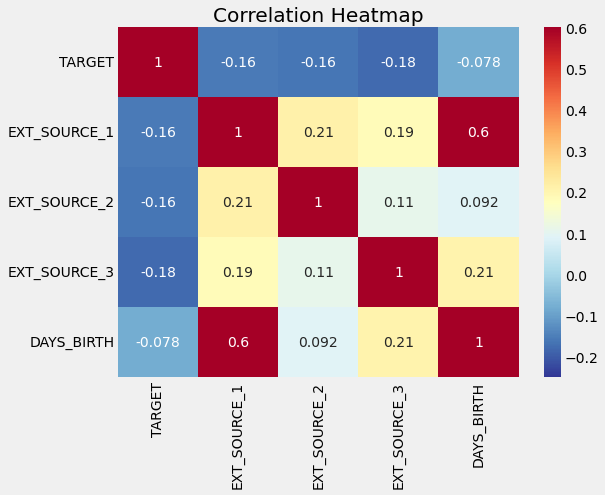

In [ ]:
plt.figure(figsize = (8, 6))

# Heatmap of correlations
sns.heatmap(ext_data_corrs, cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Correlation Heatmap');

All three `EXT_SOURCE` featureshave negative correlations with the target, indicating that as the value of the `EXT_SOURCE` increases, the client is more likely to repay the loan. We can also see that `DAYS_BIRTH` is positively correlated with `EXT_SOURCE_1` indicating that maybe one of the factors in this score is the client age.

Next we can look at the distribution of each of these features colored by the value of the target. This will let us visualize the effect of this variable on the target.

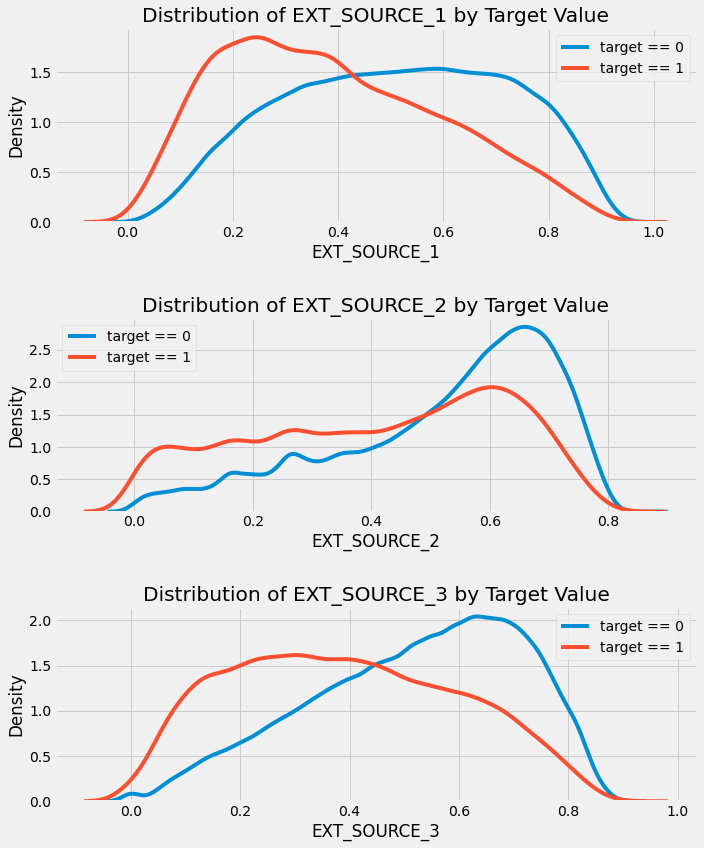

In [ ]:
plt.figure(figsize = (10, 12))

# iterate through the sources
for i, source in enumerate(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']):
    
    # create a new subplot for each source
    plt.subplot(3, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train.loc[app_train['TARGET'] == 0, source], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train.loc[app_train['TARGET'] == 1, source], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % source)
    plt.legend(['target == 0','target == 1']);
    plt.xlabel('%s' % source); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)
    

`EXT_SOURCE_3` displays the greatest difference between the values of the target. We can clearly see that this feature has some relationship to the likelihood of an applicant to repay a loan. The relationship is not very strong (in fact they are all [considered very weak](http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf), but these variables will still be useful for a machine learning model to predict whether or not an applicant will repay a loan on time.

## Pairs Plot

As a final exploratory plot, we can make a pairs plot of the `EXT_SOURCE` variables and the `DAYS_BIRTH` variable. The [Pairs Plot](https://towardsdatascience.com/visualizing-data-with-pair-plots-in-python-f228cf529166) is a great exploration tool because it lets us see relationships between multiple pairs of variables as well as distributions of single variables. Here we are using the seaborn visualization library and the PairGrid function to create a Pairs Plot with scatterplots on the upper triangle, histograms on the diagonal, and 2D kernel density plots and correlation coefficients on the lower triangle.

If you don't understand this code, that's all right! Plotting in Python can be overly complex, and for anything beyond the simplest graphs, I usually find an existing implementation and adapt the code (don't repeat yourself)! 

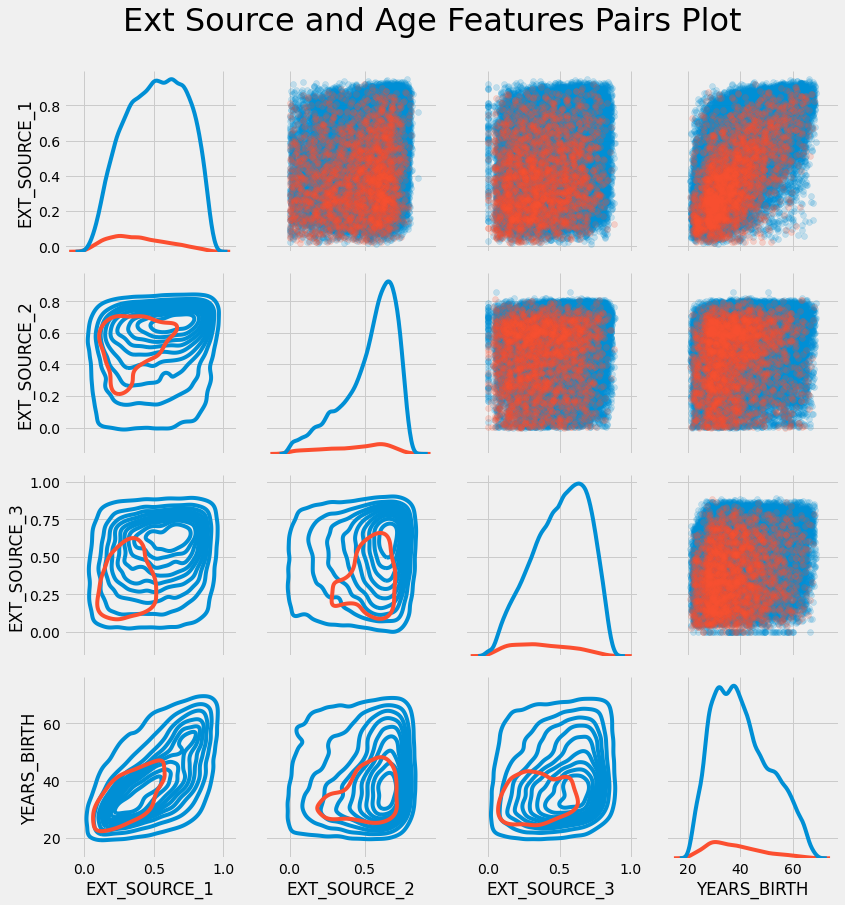

In [ ]:
# Copy the data for plotting
plot_data = ext_data.drop(columns = ['DAYS_BIRTH']).copy()

# Add in the age of the client in years
plot_data['YEARS_BIRTH'] = age_data['YEARS_BIRTH']

# Drop na values and limit to first 100000 rows
plot_data = plot_data.dropna().loc[:100000, :]

# Function to calculate correlation coefficient between two columns
def corr_func(x, y, **kwargs):
    r = np.corrcoef(x, y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
                xy=(.2, .8), xycoords=ax.transAxes,
                size = 20)

# Create the pairgrid object
grid = sns.PairGrid(data = plot_data, size = 3, diag_sharey=False,
                    hue = 'TARGET', 
                    vars = [x for x in list(plot_data.columns) if x != 'TARGET'])

# Upper is a scatter plot
grid.map_upper(plt.scatter, alpha = 0.2)

# Diagonal is a histogram
grid.map_diag(sns.kdeplot)

# Bottom is density plot
grid.map_lower(sns.kdeplot, cmap = plt.cm.OrRd_r);

plt.suptitle('Ext Source and Age Features Pairs Plot', size = 32, y = 1.05);

In this plot, the red indicates loans that were not repaid and the blue are loans that are paid. We can see the different relationships within the data. There does appear to be a moderate positive linear relationship between the `EXT_SOURCE_1` and the `DAYS_BIRTH` (or equivalently `YEARS_BIRTH`), indicating that this feature may take into account the age of the client. 

In [15]:
#Création d'ensemble de test
app_train, app_test = model_selection.train_test_split(app_train, test_size=0.2)

ValueError: ignored

# Feature Engineering

Kaggle competitions are won by feature engineering: those win are those who can create the most useful features out of the data. (This is true for the most part as the winning models, at least for structured data, all tend to be variants on [gradient boosting](http://blog.kaggle.com/2017/01/23/a-kaggle-master-explains-gradient-boosting/)). This represents one of the patterns in machine learning: feature engineering has a greater return on investment than model building and hyperparameter tuning. [This is a great article on the subject)](https://www.featurelabs.com/blog/secret-to-data-science-success/). As Andrew Ng is fond of saying: "applied machine learning is basically feature engineering." 

While choosing the right model and optimal settings are important, the model can only learn from the data it is given. Making sure this data is as relevant to the task as possible is the job of the data scientist (and maybe some [automated tools](https://docs.featuretools.com/getting_started/install.html) to help us out).

Feature engineering refers to a geneal process and can involve both feature construction: adding new features from the existing data, and feature selection: choosing only the most important features or other methods of dimensionality reduction. There are many techniques we can use to both create features and select features.

We will do a lot of feature engineering when we start using the other data sources, but in this notebook we will try only two simple feature construction methods: 

* Polynomial features
* Domain knowledge features


## Polynomial Features

One simple feature construction method is called [polynomial features](http://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.PolynomialFeatures.html). In this method, we make features that are powers of existing features as well as interaction terms between existing features. For example, we can create variables `EXT_SOURCE_1^2` and `EXT_SOURCE_2^2` and also variables such as `EXT_SOURCE_1` x `EXT_SOURCE_2`, `EXT_SOURCE_1` x `EXT_SOURCE_2^2`, `EXT_SOURCE_1^2` x   `EXT_SOURCE_2^2`, and so on. These features that are a combination of multiple individual variables are called [interaction terms](https://en.wikipedia.org/wiki/Interaction_(statistics) because they  capture the interactions between variables. In other words, while two variables by themselves  may not have a strong influence on the target, combining them together into a single interaction variable might show a relationship with the target. [Interaction terms are commonly used in statistical models](https://www.theanalysisfactor.com/interpreting-interactions-in-regression/) to capture the effects of multiple variables, but I do not see them used as often in machine learning. Nonetheless, we can try out a few to see if they might help our model to predict whether or not a client will repay a loan. 

Jake VanderPlas writes about [polynomial features in his excellent book Python for Data Science](https://jakevdp.github.io/PythonDataScienceHandbook/05.04-feature-engineering.html) for those who want more information.

In the following code, we create polynomial features using the `EXT_SOURCE` variables and the `DAYS_BIRTH` variable. [Scikit-Learn has a useful class called `PolynomialFeatures`](http://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.PolynomialFeatures.html) that creates the polynomials and the interaction terms up to a specified degree. We can use a degree of 3 to see the results (when we are creating polynomial features, we want to avoid using too high of a degree, both because the number of features scales exponentially with the degree, and because we can run into [problems with overfitting](http://scikit-learn.org/stable/auto_examples/model_selection/plot_underfitting_overfitting.html#sphx-glr-auto-examples-model-selection-plot-underfitting-overfitting-py)). 

In [ ]:
# Make a new dataframe for polynomial features
poly_features = app_train[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH', 'TARGET']]
poly_features_test = app_test[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]

imputer = SimpleImputer(missing_values=np.nan, strategy='median')


poly_target = poly_features['TARGET']

poly_features = poly_features.drop(columns = ['TARGET'])

# Need to impute missing values
imputer.fit(poly_features)
dump(imputer, '/content/drive/MyDrive/data/imputer_poly.joblib')
poly_features = imputer.transform(poly_features)

poly_features_test = imputer.transform(poly_features_test)
                                  
# Create the polynomial object with specified degree
poly_transformer = PolynomialFeatures(degree = 3)

In [ ]:
# Train the polynomial features
poly_transformer.fit(poly_features)

# Transform the features
poly_features = poly_transformer.transform(poly_features)
poly_features_test = poly_transformer.transform(poly_features_test)
print('Polynomial Features shape: ', poly_features.shape)

Polynomial Features shape:  (307511, 35)


This creates a considerable number of new features. To get the names we have to use the polynomial features `get_feature_names` method.

In [ ]:
poly_transformer.get_feature_names(input_features = ['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH'])[:15]

['1',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'DAYS_BIRTH',
 'EXT_SOURCE_1^2',
 'EXT_SOURCE_1 EXT_SOURCE_2',
 'EXT_SOURCE_1 EXT_SOURCE_3',
 'EXT_SOURCE_1 DAYS_BIRTH',
 'EXT_SOURCE_2^2',
 'EXT_SOURCE_2 EXT_SOURCE_3',
 'EXT_SOURCE_2 DAYS_BIRTH',
 'EXT_SOURCE_3^2',
 'EXT_SOURCE_3 DAYS_BIRTH',
 'DAYS_BIRTH^2']

There are 35 features with individual features raised to powers up to degree 3 and interaction terms. Now, we can see whether any of these new features are correlated with the target.

In [ ]:
# Create a dataframe of the features 
poly_features = pd.DataFrame(poly_features, 
                             columns = poly_transformer.get_feature_names(['EXT_SOURCE_1', 'EXT_SOURCE_2', 
                                                                           'EXT_SOURCE_3', 'DAYS_BIRTH']))

# Add in the target
poly_features['TARGET'] = poly_target

# Find the correlations with the target
poly_corrs = poly_features.corr()['TARGET'].sort_values()

# Display most negative and most positive
print(poly_corrs.head(10))
print(poly_corrs.tail(5))

EXT_SOURCE_2 EXT_SOURCE_3                -0.193939
EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3   -0.189605
EXT_SOURCE_2 EXT_SOURCE_3 DAYS_BIRTH     -0.181283
EXT_SOURCE_2^2 EXT_SOURCE_3              -0.176428
EXT_SOURCE_2 EXT_SOURCE_3^2              -0.172282
EXT_SOURCE_1 EXT_SOURCE_2                -0.166625
EXT_SOURCE_1 EXT_SOURCE_3                -0.164065
EXT_SOURCE_2                             -0.160295
EXT_SOURCE_2 DAYS_BIRTH                  -0.156873
EXT_SOURCE_1 EXT_SOURCE_2^2              -0.156867
Name: TARGET, dtype: float64
DAYS_BIRTH     -0.078239
DAYS_BIRTH^2   -0.076672
DAYS_BIRTH^3   -0.074273
TARGET          1.000000
1                    NaN
Name: TARGET, dtype: float64


Several of the new variables have a greater (in terms of absolute magnitude) correlation with the target than the original features. When we build machine learning models, we can try with and without these features to determine if they actually help the model learn. 

We will add these features to a copy of the training and testing data and then evaluate models with and without the features. Many times in machine learning, the only way to know if an approach will work is to try it out! 

In [ ]:
# Put test features into dataframe
poly_features_test = pd.DataFrame(poly_features_test, 
                                  columns = poly_transformer.get_feature_names(['EXT_SOURCE_1', 'EXT_SOURCE_2', 
                                                                                'EXT_SOURCE_3', 'DAYS_BIRTH']))

# Merge polynomial features into training dataframe
poly_features['SK_ID_CURR'] = app_train['SK_ID_CURR']
app_train_poly = app_train.merge(poly_features, on = 'SK_ID_CURR', how = 'left', suffixes=('', '_y'))
app_train_poly.drop(app_train_poly.filter(regex='_y$').columns.tolist(),axis=1, inplace=True)

# Merge polnomial features into testing dataframe
poly_features_test['SK_ID_CURR'] = app_test['SK_ID_CURR']
app_test_poly = app_test.merge(poly_features_test, on = 'SK_ID_CURR', how = 'left', suffixes=('', '_y'))
app_test_poly.drop(app_test_poly.filter(regex='_y$').columns.tolist(),axis=1, inplace=True)

# Align the dataframes
app_train_poly, app_test_poly = app_train_poly.align(app_test_poly, join = 'inner', axis = 1)

# Print out the new shapes
print('Training data with polynomial features shape: ', app_train_poly.shape)
print('Testing data with polynomial features shape:  ', app_test_poly.shape)

Training data with polynomial features shape:  (307511, 271)
Testing data with polynomial features shape:   (48744, 271)


In [ ]:
poly_features.columns.difference(poly_features_test.columns)

Index(['TARGET'], dtype='object')

In [ ]:
app_train_poly

,SK_ID_CURR,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,...,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,DAYS_EMPLOYED_ANOM,1,EXT_SOURCE_1^2,EXT_SOURCE_1 EXT_SOURCE_2,EXT_SOURCE_1 EXT_SOURCE_3,EXT_SOURCE_1 DAYS_BIRTH,EXT_SOURCE_2^2,EXT_SOURCE_2 EXT_SOURCE_3,EXT_SOURCE_2 DAYS_BIRTH,EXT_SOURCE_3^2,EXT_SOURCE_3 DAYS_BIRTH,DAYS_BIRTH^2,EXT_SOURCE_1^3,EXT_SOURCE_1^2 EXT_SOURCE_2,EXT_SOURCE_1^2 EXT_SOURCE_3,EXT_SOURCE_1^2 DAYS_BIRTH,EXT_SOURCE_1 EXT_SOURCE_2^2,EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3,EXT_SOURCE_1 EXT_SOURCE_2 DAYS_BIRTH,EXT_SOURCE_1 EXT_SOURCE_3^2,EXT_SOURCE_1 EXT_SOURCE_3 DAYS_BIRTH,EXT_SOURCE_1 DAYS_BIRTH^2,EXT_SOURCE_2^3,EXT_SOURCE_2^2 EXT_SOURCE_3,EXT_SOURCE_2^2 DAYS_BIRTH,EXT_SOURCE_2 EXT_SOURCE_3^2,EXT_SOURCE_2 EXT_SOURCE_3 DAYS_BIRTH,EXT_SOURCE_2 DAYS_BIRTH^2,EXT_SOURCE_3^3,EXT_SOURCE_3^2 DAYS_BIRTH,EXT_SOURCE_3 DAYS_BIRTH^2,DAYS_BIRTH^3
0,100002,0,0,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,9461,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,...,0,0,0,0,1,0,1,0,False,1.0,0.006895,0.021834,0.011573,785.612748,0.069142,0.036649,2487.756636,0.019426,1318.634256,89510521.0,0.000573,0.001813,0.000961,65.234900,0.005741,0.003043,206.575767,0.001613,109.495390,7.432682e+06,0.018181,0.009637,654.152107,0.005108,346.733022,2.353667e+07,0.002707,183.785678,1.247560e+07,8.468590e+11
1,100003,0,0,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,16765,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,...,0,0,0,0,0,0,1,0,False,1.0,0.096887,0.193685,0.166614,5218.396475,0.387190,0.333073,10431.950422,0.286521,8973.906339,281065225.0,0.030158,0.060288,0.051861,1624.316241,0.120520,0.103675,3247.125160,0.089185,2793.283699,8.748642e+07,0.240927,0.207254,6491.237078,0.178286,5583.975307,1.748916e+08,0.153368,4803.518937,1.504475e+08,4.712058e+12
2,100004,1,1,1,0,67500.0,135000.0,6750.0,135000.0,0.010032,19046,-225.0,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,False,1.0,0.256034,0.281290,0.369159,9637.236584,0.309038,0.405575,10587.901540,0.532268,13895.327191,362750116.0,0.129553,0.142332,0.186794,4876.421768,0.156373,0.205220,5357.456268,0.269326,7031.006802,1.835508e+08,0.171798,0.225464,5885.942404,0.295894,7724.580288,2.016572e+08,0.388325,10137.567875,2.646504e+08,6.908939e+12
3,100006,0,0,1,0,135000.0,312682.5,29686.5,297000.0,0.008019,19005,-3039.0,-9833.0,-2437,NaN,1,1,0,1,0,0,2.0,2,2,17,0,0,0,0,0,0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,False,1.0,0.256034,0.329122,0.270849,9616.490669,0.423074,0.348166,12361.644326,0.286521,10172.925140,361190025.0,0.129553,0.166535,0.137049,4865.924377,0.214075,0.176171,6254.966447,0.144979,5147.479068,1.827614e+08,0.275185,0.226462,8040.528832,0.186365,6616.894625,2.349331e+08,0.153368,5445.325225,1.933364e+08,6.864416e+12
4,100007,0,0,1,0,121500.0,513000.0,21865.5,513000.0,0.028663,19932,-3038.0,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,11,0,0,0,0,1,1,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,False,1.0,0.256034,0.163305,0.27084

## Domain Knowledge Features

Maybe it's not entirely correct to call this "domain knowledge" because I'm not a credit expert, but perhaps we could call this "attempts at applying limited financial knowledge". In this frame of mind, we can make a couple features that attempt to capture what we think may be important for telling whether a client will default on a loan. Here I'm going to use five features that were inspired by [this script](https://www.kaggle.com/jsaguiar/updated-0-792-lb-lightgbm-with-simple-features) by Aguiar:

* `CREDIT_INCOME_PERCENT`: the percentage of the credit amount relative to a client's income
* `ANNUITY_INCOME_PERCENT`: the percentage of the loan annuity relative to a client's income
* `CREDIT_TERM`:  the length of the payment in months (since the annuity is the monthly amount due
* `DAYS_EMPLOYED_PERCENT`: the percentage of the days employed relative to the client's age

Again, thanks to Aguiar and [his great script](https://www.kaggle.com/jsaguiar/updated-0-792-lb-lightgbm-with-simple-features) for exploring these features.



In [ ]:
app_train_domain = app_train.copy()
app_test_domain = app_test.copy()

app_train_domain['CREDIT_INCOME_PERCENT'] = app_train_domain['AMT_CREDIT'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['ANNUITY_INCOME_PERCENT'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['CREDIT_TERM'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_CREDIT']
app_train_domain['DAYS_EMPLOYED_PERCENT'] = app_train_domain['DAYS_EMPLOYED'] / app_train_domain['DAYS_BIRTH']

In [ ]:
app_test_domain['CREDIT_INCOME_PERCENT'] = app_test_domain['AMT_CREDIT'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['ANNUITY_INCOME_PERCENT'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['CREDIT_TERM'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_CREDIT']
app_test_domain['DAYS_EMPLOYED_PERCENT'] = app_test_domain['DAYS_EMPLOYED'] / app_test_domain['DAYS_BIRTH']

#### Visualize New Variables

We should explore these __domain knowledge__ variables visually in a graph. For all of these, we will make the same KDE plot colored by the value of the `TARGET`.

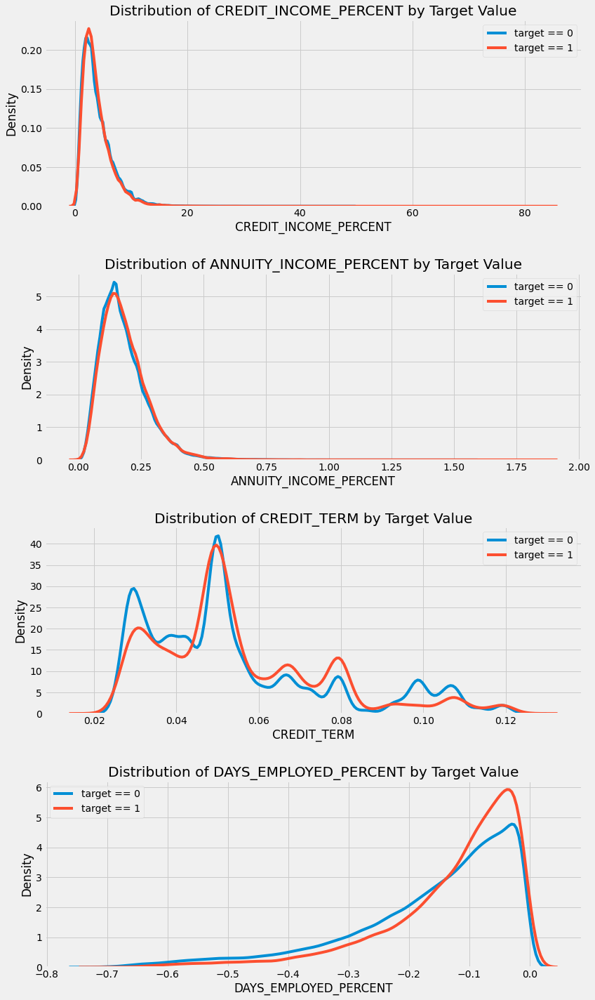

In [ ]:
plt.figure(figsize = (12, 20))
# iterate through the new features
for i, feature in enumerate(['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']):
    
    # create a new subplot for each source
    plt.subplot(4, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 0, feature], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 1, feature], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % feature)
    plt.xlabel('%s' % feature); plt.ylabel('Density');plt.legend(['target == 0','target == 1']);
    
plt.tight_layout(h_pad = 2.5)

It's hard to say ahead of time if these new features will be useful. The only way to tell for sure is to try them out! 

In [ ]:
app_train_matrix = np.asmatrix(app_train, dtype=float)
app_train_df = pd.DataFrame(app_train_matrix,columns=app_train.columns)
app_train_df.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,...,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security Ministries,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade: type 1,ORGANIZATION_TYPE_Trade: type 2,ORGANIZATION_TYPE_Trade: type 3,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University,ORGANIZATION_TYPE_XNA,FONDKAPREMONT_MODE_not specified,FONDKAPREMONT_MODE_org spec account,FONDKAPREMONT_MODE_reg oper account,FONDKAPREMONT_MODE_reg oper spec account,HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,TARGET,DAYS_EMPLOYED_ANOM
0,100002.0,0.0,0.0,1.0,0.0,202500.0,406597.5,24700.5,351000.0,0.018801,9461.0,-637.0,-3648.0,-2120.0,NaN,1.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,2.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
1,100003.0,0.0,0.0,0.0,0.0,270000.0,1293502.5,35698.5,1129500.0,0.003541,16765.0,-1188.0,-1186.0,-291.0,NaN,1.0,1.0,0.0,1.0,1.0,0.0,2.0,1.0,1.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,100004.0,1.0,1.0,1.0,0.0,67500.0,135000.0,6750.0,135000.0,0.010032,19046.0,-225.0,-4260.0,-2531.0,26.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,2.0,2.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006.0,0.0,0.0,1.0,0.0,135000.0,312682.5,29686.5,297000.0,0.008019,19005.0,-3039.0,-9833.0,-2437.0,NaN,1.0,1.0,0.0,1.0,0.0,0.0,2.0,2.0,2.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007.0,0.0,0.0,1.0,0.0,121500.0,513000.0,21865.5,513000.0,0.028663,19932.0,-3038.0,-4311.0,-3458.0,NaN,1.0,1.0,0.0,1.0,0.0,0.0,1.0,2.0,2.0,11.0,0.0,0.0,0.0,0.0,1.0,1.0,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# checking for infinity
print()
print("checking for infinity")

ds = app_train_df.isin([np.inf, -np.inf])
print(ds)

# printing the count of infinity values
print()
print("printing the count of infinity values")

count = np.isinf(app_train_df).values.sum()
print("It contains " + str(count) + " infinite values")

# counting infinity in a particular column name
c = np.isinf(app_train_df['EXT_SOURCE_1']).values.sum()
print("It contains " + str(c) + " infinite values")

# printing column name where infinity is present
print()
print("printing column name where infinity is present")
col_name = app_train_df.columns.to_series()[np.isinf(app_train_df).any()]
print(col_name)

# printing row index with infinity
print()
print("printing row index with infinity ")

r = app_train_df.index[np.isinf(app_train_df).any(1)]
print(r)



checking for infinity
        SK_ID_CURR  NAME_CONTRACT_TYPE  ...  TARGET  DAYS_EMPLOYED_ANOM
0            False               False  ...   False               False
1            False               False  ...   False               False
2            False               False  ...   False               False
3            False               False  ...   False               False
4            False               False  ...   False               False
...            ...                 ...  ...     ...                 ...
307506       False               False  ...   False               False
307507       False               False  ...   False               False
307508       False               False  ...   False               False
307509       False               False  ...   False               False
307510       False               False  ...   False               False

[307511 rows x 241 columns]

printing the count of infinity values
It contains 0 infinite values
It contains 0 i

In [ ]:
app_train.drop("DAYS_EMPLOYED_ANOM", axis=1, inplace=True)
app_train.to_csv('/content/drive/MyDrive/data/app_train_all.csv', index=False)

In [ ]:
app_train = pd.read_csv('/content/drive/MyDrive/data/app_train_all.csv')
app_train.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,...,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security Ministries,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade: type 1,ORGANIZATION_TYPE_Trade: type 2,ORGANIZATION_TYPE_Trade: type 3,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University,ORGANIZATION_TYPE_XNA,FONDKAPREMONT_MODE_not specified,FONDKAPREMONT_MODE_org spec account,FONDKAPREMONT_MODE_reg oper account,FONDKAPREMONT_MODE_reg oper spec account,HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,TARGET
0,100002,0,0,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,9461,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0,1
1,100003,0,0,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,16765,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,1,0,0
2,100004,1,1,1,0,67500.0,135000.0,6750.0,135000.0,0.010032,19046,-225.0,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,1,0,135000.0,312682.5,29686.5,297000.0,0.008019,19005,-3039.0,-9833.0,-2437,NaN,1,1,0,1,0,0,2.0,2,2,17,0,0,0,0,0,0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,1,0,121500.0,513000.0,21865.5,513000.0,0.028663,19932,-3038.0,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,11,0,0,0,0,1,1,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
app_train_FE = app_train_domain.merge(app_train_poly, on = 'SK_ID_CURR', how = 'left', suffixes=('', '_y'))
app_train_FE.drop(app_train_FE.filter(regex='_y$').columns.tolist(),axis=1, inplace=True)
app_train_FE.drop("DAYS_EMPLOYED_ANOM", axis=1, inplace=True)

# Merge polnomial features into testing dataframe
app_test_FE = app_test_domain.merge(app_test_poly, on = 'SK_ID_CURR', how = 'left', suffixes=('', '_y'))
app_test_FE.drop(app_test_FE.filter(regex='_y$').columns.tolist(),axis=1, inplace=True)
app_test_FE.drop("DAYS_EMPLOYED_ANOM", axis=1, inplace=True)

In [ ]:
app_train_FE.to_csv('/content/drive/MyDrive/data/app_train_FE.csv', index=False)

In [ ]:
app_train_FE = pd.read_csv('/content/drive/MyDrive/data/app_train_FE.csv')
app_train_FE.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,...,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,TARGET,CREDIT_INCOME_PERCENT,ANNUITY_INCOME_PERCENT,CREDIT_TERM,DAYS_EMPLOYED_PERCENT,1,EXT_SOURCE_1^2,EXT_SOURCE_1 EXT_SOURCE_2,EXT_SOURCE_1 EXT_SOURCE_3,EXT_SOURCE_1 DAYS_BIRTH,EXT_SOURCE_2^2,EXT_SOURCE_2 EXT_SOURCE_3,EXT_SOURCE_2 DAYS_BIRTH,EXT_SOURCE_3^2,EXT_SOURCE_3 DAYS_BIRTH,DAYS_BIRTH^2,EXT_SOURCE_1^3,EXT_SOURCE_1^2 EXT_SOURCE_2,EXT_SOURCE_1^2 EXT_SOURCE_3,EXT_SOURCE_1^2 DAYS_BIRTH,EXT_SOURCE_1 EXT_SOURCE_2^2,EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3,EXT_SOURCE_1 EXT_SOURCE_2 DAYS_BIRTH,EXT_SOURCE_1 EXT_SOURCE_3^2,EXT_SOURCE_1 EXT_SOURCE_3 DAYS_BIRTH,EXT_SOURCE_1 DAYS_BIRTH^2,EXT_SOURCE_2^3,EXT_SOURCE_2^2 EXT_SOURCE_3,EXT_SOURCE_2^2 DAYS_BIRTH,EXT_SOURCE_2 EXT_SOURCE_3^2,EXT_SOURCE_2 EXT_SOURCE_3 DAYS_BIRTH,EXT_SOURCE_2 DAYS_BIRTH^2,EXT_SOURCE_3^3,EXT_SOURCE_3^2 DAYS_BIRTH,EXT_SOURCE_3 DAYS_BIRTH^2,DAYS_BIRTH^3
0,100002,0,0,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,...,1,0,1,0,1,2.007889,0.121978,0.060749,0.067329,1.0,0.006895,0.021834,0.011573,-785.612748,0.069142,0.036649,-2487.756636,0.019426,-1318.634256,89510521.0,0.000573,0.001813,0.000961,-65.234900,0.005741,0.003043,-206.575767,0.001613,-109.495390,7.432682e+06,0.018181,0.009637,-654.152107,0.005108,-346.733022,2.353667e+07,0.002707,-183.785678,1.247560e+07,-8.468590e+11
1,100003,0,0,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,...,0,0,1,0,0,4.790750,0.132217,0.027598,0.070862,1.0,0.096887,0.193685,0.166614,-5218.396475,0.387190,0.333073,-10431.950422,0.286521,-8973.906339,281065225.0,0.030158,0.060288,0.051861,-1624.316241,0.120520,0.103675,-3247.125160,0.089185,-2793.283699,8.748642e+07,0.240927,0.207254,-6491.237078,0.178286,-5583.975307,1.748916e+08,0.153368,-4803.518937,1.504475e+08,-4.712058e+12
2,100004,1,1,1,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225.0,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,2.000000,0.100000,0.050000,0.011814,1.0,0.256034,0.281290,0.369159,-9637.236584,0.309038,0.405575,-10587.901540,0.532268,-13895.327191,362750116.0,0.129553,0.142332,0.186794,-4876.421768,0.156373,0.205220,-5357.456268,0.269326,-7031.006802,1.835508e+08,0.171798,0.225464,-5885.942404,0.295894,-7724.580288,2.016572e+08,0.388325,-10137.567875,2.646504e+08,-6.908939e+12
3,100006,0,0,1,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039.0,-9833.0,-2437,NaN,1,1,0,1,0,0,2.0,2,2,17,0,0,0,0,0,0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,0,0,0,0,2.316167,0.219900,0.094941,0.159905,1.0,0.256034,0.329122,0.270849,-9616.490669,0.423074,0.348166,-12361.644326,0.286521,-10172.925140,361190025.0,0.129553,0.166535,0.137049,-4865.924377,0.214075,0.176171,-6254.966447,0.144979,-5147.479068,1.827614e+08,0.275185,0.226462,-8040.528832,0.186365,-6616.894625,2.349331e+08,0.153368,-5445.325225,1.933364e+08,-6.864416e+12
4,100007,0,0,1,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038.0,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,11,0,0,0,

In [ ]:
app_train[["CODE_GENDER_XNA","NAME_INCOME_TYPE_Maternity leave","NAME_FAMILY_STATUS_Unknown"]]

In [ ]:
app_test_FE.to_csv('/content/drive/MyDrive/data/app_test_FE.csv', index=False)

# Modèle de base
For a naive baseline, we could guess the same value for all examples on the testing set.  We are asked to predict the probability of not repaying the loan, so if we are entirely unsure, we would guess 0.5 for all observations on the test set. This  will get us a Reciever Operating Characteristic Area Under the Curve (AUC ROC) of 0.5 in the competition ([random guessing on a classification task will score a 0.5](https://stats.stackexchange.com/questions/266387/can-auc-roc-be-between-0-0-5)).

Since we already know what score we are going to get, we don't really need to make a naive baseline guess. Let's use a slightly more sophisticated model for our actual baseline: Logistic Regression.

Afin d’éviter le sur-apprentissage tout en convergeant vers le meilleur modèle possible, il est préférable d’utiliser non pas deux jeux de données seulement (apprentissage et évaluation) mais trois (apprentissage, validation et évaluation).

L’ensemble de validation sert à évaluer les résultats de l’ensemble d’apprentissage et l’ensemble d’évaluation sert à vérifier l’évaluation après que le modèle a passé l’étape de validation.

La figure suivante présente ce nouveau workflow :


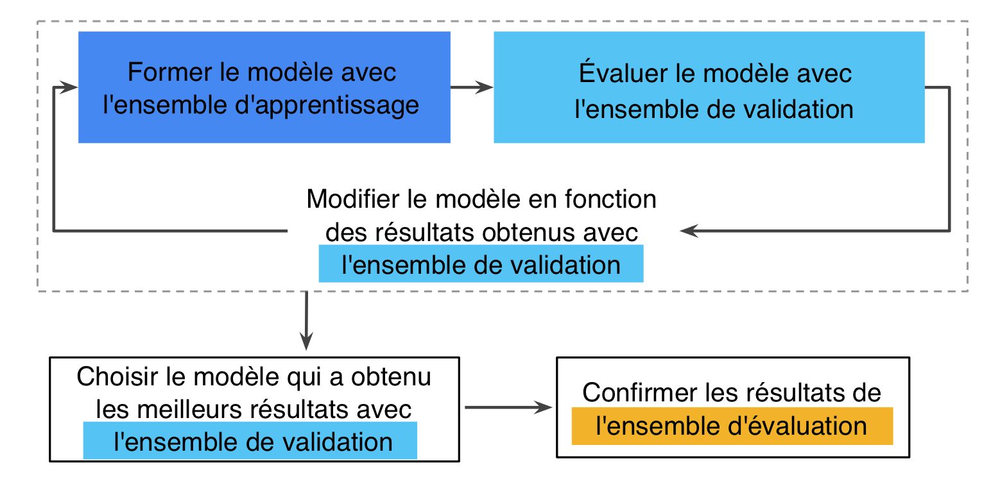

Nous allons tester différents modèles en gérant les données déséquilibrées par différentes méthodes (SMOTE, SMOTETomek, pondération). La pondération peut être gérée directement dans le modèle d'implémentation grâce à une option. 


# Données déséquilibrées

Plusieurs algorithmes de classification populaires supposent que les classes sont équilibrées et, par conséquent, construisent la fonction d’erreur correspondante pour maximiser un taux de précision global. Dans le cas d’un dataset non représentatif, le résultat conduirait à des prédictions faussées vers la classe minoritaire (surapprentissage).

De nombreuses méthodes ont été proposées pour résoudre le problème du déséquilibre des classes, y compris des méthodes telles que le suréchantillonnage, le sous-échantillonnage, les méthodes de pondération des coûts, de transfert learning, ou de transformations aléatoires pour les images.

1.  **Méthodes de sous-échantillonnage :** élimination aléatoire de quelques exemples de la classe majoritaire pour diminuer leur effet sur le modèle. En revanche, tous les exemples de la classe minoritaire sont conservés, par exemple Random Undersampling, Edited Nearest Neighbours ou Tomek Links. Cependant, le sous-échantillonnage de la classe majoritaire peut finir par exclure des cas importants qui fournissent des informations nécessaires à la différenciation des deux classes.

2. **Méthodes de suréchantillonnage :** génération de données supplémentaires (copies, données synthétiques) de la classe minoritaire pour augmenter leur effet sur le modèle. En revanche, tous les cas de la classe majoritaire sont conservés, par exemple Random Over-Sampling, SMOTE ou ADASYN. Cependant suréchantillonner la classe minoritaire peut conduire au surapprentissage du modèle, puisque cela introduira des instances dupliquées d’un ensemble qui est déjà petit.

3. **Méthodes hybrides :** combinaison des deux stratégies : le sous-échantillonnage et le suréchantillonnage. Par exemple SMOTEENN ou SMOTETomek.


## Sur-échantillonage : SMOTE

SMOTE (Synthetic Minority Over-Sampling TEchnique) est une technique utilisée pour traiter des ensembles de données déséquilibrées. Introduite pour la première fois par Nitesh V. Chawla, SMOTE est une technique basée sur les plus proches voisins avec une distance Euclidienne entre les points de données dans l’espace des caractéristiques.

De nombreuses modifications et extensions ont été apportées à la méthode SMOTE depuis sa proposition en 2002, telles que : SMOTEN, SMOTENC, SVMSMOTE, KmeanSMOTE, BorderlineSMOTE, ADASYN, etc., permettant de gérer les variables nominales (catégoriques) ainsi que les points dans la frontière.

### Comment ca marche ?

Le principe de SMOTE est de générer de nouveaux échantillons en combinant les données de la classe minoritaire avec celles de leurs voisins proches. Techniquement, on peut décomposer SMOTE en 5 étapes :

1. Choix d’un vecteur caractéristique de notre classe minoritaire que nous appellerons vc ;

2. Sélection des k-voisins les plus proches (k=5 par défaut) et choix de l’un d’eux au hasard que l’on appellera pv ;

3. Calcul de la différence pour chaque valeur caractéristique (feature value) i, vc[i]-pv[i] et multiplication de celle-ci par un nombre aléatoire entre [0,1];

4. Ajout du résultat précédent à la valeur de la caractéristique i du vecteur vc afin d’obtenir un nouveau point (une nouvelle donnée) dans l’espace des caractéristiques ;

5. Répétition de ces opérations pour chaque point de données de la classe minoritaire ;

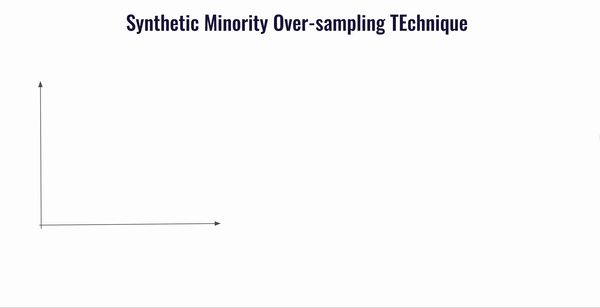

In [ ]:
#X matrice des var. explicatives
X = app_train.drop('TARGET', axis=1) 

#Y matrice de la variable cible : expliquée
y = app_train['TARGET']
y = y.values.reshape(-1,1)

Text(0.5, 1.0, 'Représentation graphique avant ré-échantillonage')

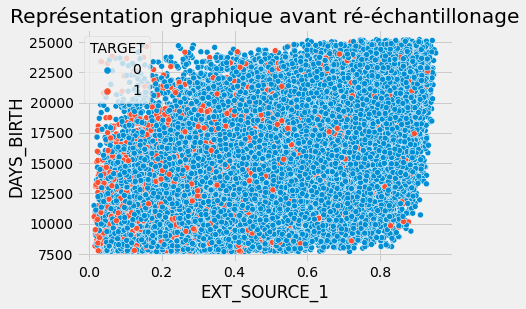

In [ ]:
X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
df_train = app_train.loc[X_train.index,:]

# Feature names
features = list(df_train.drop('TARGET', axis=1).columns)

## Représentation graphique avant ré-échantillonage
sns.scatterplot(data = df_train , x = df_train['EXT_SOURCE_1'], y = df_train['DAYS_BIRTH'], hue = df_train['TARGET'])
plt.title("Représentation graphique avant ré-échantillonage")

Training data shape avant ré-échantillonage :  (246008, 240)
Training data shape après ré-échantillonage :  (452264, 240)


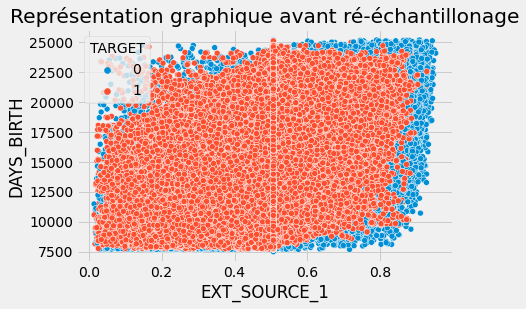

In [ ]:
# Median imputation of missing values
imputer = SimpleImputer(strategy = 'median')
# Fit on the training data
imputer.fit(X_train)

# Transform both training and validation data
X_train = imputer.transform(X_train)
X_val = imputer.transform(X_val)

print('Training data shape avant ré-échantillonage : ', X_train.shape)

#Oversampling the data
#seed = 5
#smote = SMOTE(sampling_strategy='auto', random_state=seed,k_neighbors=7)
smote = SMOTE(random_state = 101)

# SMOTE
x_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Création de la nouvelle table
df_train = pd.DataFrame(x_train_smote, columns = app_train.drop("TARGET",axis=1).columns)
df_train['TARGET'] = y_train_smote
df_train['SMOTE'] = 1

## Représentation graphique après ré-échantillonage
sns.scatterplot(data = df_train , x = df_train['EXT_SOURCE_1'], y = df_train['DAYS_BIRTH'], hue = df_train['TARGET'])
plt.title("Représentation graphique avant ré-échantillonage")

print('Training data shape après ré-échantillonage : ', x_train_smote.shape)

Text(0.5, 1.0, 'Distribution de la TARGET après ré-échantillonage')

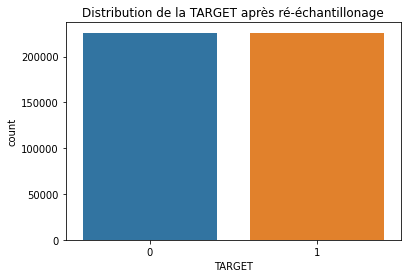

In [ ]:
sns.countplot(df_train['TARGET'])
plt.title("Distribution de la TARGET après ré-échantillonage")

#### SMOTETomek


In [ ]:
from imblearn.combine import SMOTETomek

smt = SMOTETomek(ratio='auto')
X_smt, y_smt = smt.fit_sample(X, y)

plot_2d_space(X_smt, y_smt, 'SMOTE + Tomek links')

In [ ]:

def load_model(model, X, y, smote=True):

  f1_val_score = []
  f1_train_score = []

  f2_val_score = []
  f2_train_score = []
  nb_fold = []
  fold = 1

  # Etape 1 : prepare cross validation
  kfold = model_selection.KFold(n_splits = 5, shuffle = True, random_state = 1)
  # enumerate splits
  for train_ix, val_ix in kfold.split(X):

    # select rows : split into train and validation set 
    X_train, X_val = X.iloc[train_ix], X.iloc[val_ix]
    y_train, y_val = y[train_ix], y[val_ix]

    # summarize
    train_0, train_1 = len(y_train[y_train==0]), len(y_train[y_train==1])
    val_0, val_1 = len(y_val[y_val==0]), len(y_val[y_val==1])

    print('>Train: 0=%d, 1=%d, Val: 0=%d, 1=%d' % (train_0, train_1, val_0, val_1))
    
    if smote == True:
        pipeline = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['smote', SMOTE(random_state=11)],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', model]])
    else:
        
        pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                     ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                     ['classifier', model]])
    
    
    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_val)
    y_pred_train = pipeline.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)

    print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

    f1_val_score.append(f1_score_val)
    f1_train_score.append(f1_score_train)

    f2_val_score.append(f2_score_val)
    f2_train_score.append(f2_score_train)

    nb_fold.append(fold)

    fold = fold +1

  return {'f1_val_score':f1_val_score, 'f1_train_score': f1_train_score, 'f2_val_score':f2_val_score, 'f2_train_score': f2_train_score, 'fold': nb_fold}


### Logistic Regression Implementation

Here I will focus on implementing the model rather than explaining the details, but for those who want to learn more about the theory of machine learning algorithms, I recommend both [An Introduction to Statistical Learning](http://www-bcf.usc.edu/~gareth/ISL/) and [Hands-On Machine Learning with Scikit-Learn and TensorFlow](http://shop.oreilly.com/product/0636920052289.do). Both of these books present the theory and also the code needed to make the models (in R and Python respectively). They both teach with the mindset that the best way to learn is by doing, and they are very effective! 

To get a baseline, we will use all of the features after encoding the categorical variables. We will preprocess the data by filling in the missing values (imputation) and normalizing the range of the features (feature scaling). The following code performs both of these preprocessing steps.


We will use [`LogisticRegression`from Scikit-Learn](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html) for our first model. The only change we will make from the default model settings is to lower the [regularization parameter](http://scikit-learn.org/stable/modules/linear_model.html#logistic-regression), C, which controls the amount of overfitting (a lower value should decrease overfitting). This will get us slightly better results than the default `LogisticRegression`, but it still will set a low bar for any future models.

Here we use the familiar Scikit-Learn modeling syntax: we first create the model, then we train the model using `.fit` and then we make predictions on the testing data using `.predict_proba` (remember that we want probabilities and not a 0 or 1).

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_C, df_nb_fold = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
for param_C in np.logspace(-3, 3, 7): 
  df_C.append(param_C)
  log_reg_smote = model(LogisticRegression(C=param_C, random_state=42), X, y, smote=True)

  df_f1_val_score.append(log_reg_smote["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(log_reg_smote["f1_train_score"]) 
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(log_reg_smote["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(log_reg_smote["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(log_reg_smote["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'C': df_C}

df_log_reg_smote = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold', 'C'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2561, Val=0.2596, Fbeta-score: Train=0.4061, Val=0.4118
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2582, Val=0.2540, Fbeta-score: Train=0.4087, Val=0.4022
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2586, Val=0.2512, Fbeta-score: Train=0.4094, Val=0.3985
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2557, Val=0.2608, Fbeta-score: Train=0.4058, Val=0.4101
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2574, Val=0.2552, Fbeta-score: Train=0.4072, Val=0.4069
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2580, Val=0.2618, Fbeta-score: Train=0.4079, Val=0.4139
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2605, Val=0.2550, Fbeta-score: Train=0.4110, Val=0.4026
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2611, Val=0.2543, Fbeta-score: Train=0.4120, Val=0.4017
>Train: 0=226294

In [ ]:
df_log_reg_smote

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,C
0,"[0.25959271996599564, 0.2539707195837055, 0.25...",0.256160,"[0.25608328415104925, 0.2582414910070718, 0.25...",0.257219,"[0.40614527197063627, 0.40874015408586195, 0.4...",0.407466,"[0.41175316874647583, 0.40219423398602777, 0.3...",0.405911,"[1, 2, 3, 4, 5]",0.001
1,"[0.26181194448775924, 0.25497259201252936, 0.2...",0.257213,"[0.25797765962635966, 0.26047542897507087, 0.2...",0.258376,"[0.40791016227556, 0.4109830777137267, 0.41195...",0.408678,"[0.41393422415068293, 0.4025617566331198, 0.40...",0.406903,"[1, 2, 3, 4, 5]",0.010
2,"[0.2627032915726403, 0.25583038869257946, 0.25...",0.257648,"[0.25834201025660986, 0.2607388189510304, 0.26...",0.258991,"[0.4088635355576363, 0.41114230990944084, 0.41...",0.409392,"[0.41564069733083825, 0.40350746823214684, 0.4...",0.407306,"[1, 2, 3, 4, 5]",0.100
3,"[0.26295936223993777, 0.25550280535174796, 0.2...",0.257848,"[0.2581775359850513, 0.2608259882675471, 0.261...",0.259278,"[0.4085857216787008, 0.4112976701809189, 0.412...",0.409771,"[0.4161230769230769, 0.40309002674061606, 0.40...",0.407553,"[1, 2, 3, 4, 5]",1.000
4,"[0.26371813504065356, 0.25617004526667975, 0.2...",0.258044,"[0.25905492452180756, 0.2609731368553682, 0.26...",0.259516,"[0.4084031007751938, 0.41126064915644417, 0.41...",0.409988,"[0.41578934330798384, 0.40366198580856444, 0.4...",0.407698,"[1, 2, 3, 4, 5]",10.000
5,"[0.26314765074545526, 0.2561607283001099, 0.25...",0.258079,"[0.2580858792937212, 0.2607176164531488, 0.261...",0.259589,"[0.40833559330391267, 0.41126989141409453, 0.4...",0.410099,"[0.41626641050272173, 0.4041104370434567, 0.40...",0.407747,"[1, 2, 3, 4, 5]",100.000
6,"[0.2627079123270636, 0.25608940306142525, 0.25...",0.258136,"[0.2578690259986209, 0.26116649117800456, 0.26...",0.259688,"[0.4084118819678587, 0.41161326343869226, 0.41...",0.410207,"[0.4158259928153142, 0.4035818822245374, 0.401...",0.407776,"[1, 2, 3, 4, 5]",1000.000


In [ ]:
#Score en fonction des hyperparamètres

# Afficher les performances correspondantes
print("Résultats de la validation croisée :")
for f1_mean, f2_mean, params in zip(
        df_log_reg_smote['f1_val_score_mean'], # F1-score moyen
        df_log_reg_smote['f2_val_score_mean'], # F2-score moyen
        df_log_reg_smote['C'],
                    ):

    print("f1-score = {:.4f} et f2-score={:.4f}  for {}".format(
        f1_mean,
        f2_mean,
        params
    ) )

Résultats de la validation croisée :
f1-score = 0.2562 et f2-score=0.4059  for 0.001
f1-score = 0.2572 et f2-score=0.4069  for 0.01
f1-score = 0.2576 et f2-score=0.4073  for 0.1
f1-score = 0.2578 et f2-score=0.4076  for 1.0
f1-score = 0.2580 et f2-score=0.4077  for 10.0
f1-score = 0.2581 et f2-score=0.4077  for 100.0
f1-score = 0.2581 et f2-score=0.4078  for 1000.0


In [ ]:
df_model=pd.DataFrame({'subsample': None, 'max_depth':None, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':True, 'F1':0.2581, 'F2':0.4078, 'model': 'LogisticRegression', 'C': 1000, 'Feature engineering': False},index=[0])

In [ ]:
pipeline_smote = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['smote', SMOTE(random_state=11)],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', LogisticRegression(C=1000, random_state=42)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline_smote.fit(X_train, y_train)

y_pred = pipeline_smote.predict(X_val)
y_pred_train = pipeline_smote.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
results = pd.DataFrame({"var":app_train.drop(columns = ['TARGET']).columns,"coef": pipeline_smote.named_steps['classifier'].coef_[0], "odds_ratio": np.exp(pipeline_smote.named_steps['classifier'].coef_[0])})
results.head()

,var,coef,odds_ratio
0,SK_ID_CURR,-0.016687,0.983452
1,NAME_CONTRACT_TYPE,-0.010695,0.989362
2,FLAG_OWN_CAR,-0.349484,0.705052
3,FLAG_OWN_REALTY,0.048238,1.049420
4,CNT_CHILDREN,0.448248,1.565567


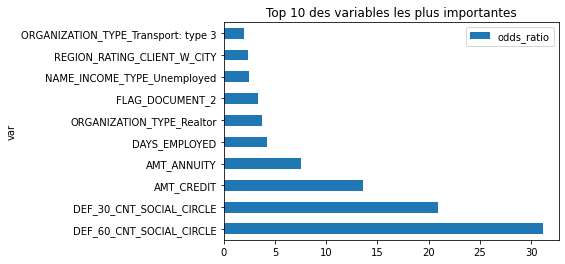

In [ ]:
results = results.sort_values(by = ["odds_ratio"], ascending=False)
ax = results.iloc[:10,].plot.barh(x='var', y='odds_ratio')
plt.title("Top 10 des variables les plus importantes")
plt.show()

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_C, df_nb_fold = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
for param_C in np.logspace(-3, 3, 7): 
  df_C.append(param_C)
  log_reg = model(LogisticRegression(C=param_C, class_weight='balanced', random_state=42), X, y, smote=False)

  df_f1_val_score.append(log_reg["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(log_reg["f1_train_score"]) 
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(log_reg["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(log_reg["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(log_reg["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'C': df_C}

df_log_reg = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold', 'C'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2541, Val=0.2565, Fbeta-score: Train=0.4053, Val=0.4094
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2556, Val=0.2524, Fbeta-score: Train=0.4069, Val=0.4018
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2564, Val=0.2503, Fbeta-score: Train=0.4083, Val=0.3992
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2534, Val=0.2587, Fbeta-score: Train=0.4047, Val=0.4095
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2546, Val=0.2531, Fbeta-score: Train=0.4054, Val=0.4061
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2561, Val=0.2601, Fbeta-score: Train=0.4073, Val=0.4138
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2588, Val=0.2534, Fbeta-score: Train=0.4107, Val=0.4022
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2593, Val=0.2519, Fbeta-score: Train=0.4116, Val=0.4005
>Train: 0=226294

In [ ]:
df_log_reg

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,C
0,"[0.2564842592944215, 0.2523929856803737, 0.250...",0.254201,"[0.2541082775242686, 0.25561620224073545, 0.25...",0.254823,"[0.40529124325375593, 0.4069108070534865, 0.40...",0.406121,"[0.40940280774919385, 0.40176503571515637, 0.3...",0.405206,"[1, 2, 3, 4, 5]",0.001
1,"[0.2601096247460616, 0.2534352323606608, 0.251...",0.255263,"[0.2561089187813847, 0.2588246656043266, 0.259...",0.256291,"[0.4073212147865817, 0.4107430771400021, 0.411...",0.407812,"[0.41379058025805515, 0.40223970202651377, 0.4...",0.406245,"[1, 2, 3, 4, 5]",0.010
2,"[0.26089293255019386, 0.2556833585066419, 0.25...",0.255930,"[0.25736914534273864, 0.2596301779442074, 0.25...",0.257152,"[0.40898469518834335, 0.41173329405049075, 0.4...",0.408883,"[0.4148050489513905, 0.40530916949069296, 0.40...",0.406975,"[1, 2, 3, 4, 5]",0.100
3,"[0.2607464114832536, 0.2557007034088274, 0.253...",0.256335,"[0.25705527349362967, 0.2594974038656779, 0.26...",0.257629,"[0.40916714952273486, 0.4116333429449622, 0.41...",0.409510,"[0.4150115754843426, 0.4056407112201103, 0.402...",0.407476,"[1, 2, 3, 4, 5]",1.000
4,"[0.2618801058566333, 0.2547184405940594, 0.253...",0.256544,"[0.2572949905809081, 0.2594793380431627, 0.260...",0.257915,"[0.4090545141159716, 0.41146933163089916, 0.41...",0.409898,"[0.41651416440963324, 0.40397968447137916, 0.4...",0.407748,"[1, 2, 3, 4, 5]",10.000
5,"[0.261132364192808, 0.2545088629150863, 0.2554...",0.256755,"[0.257526526152342, 0.25930943717581484, 0.261...",0.258148,"[0.4098330648704056, 0.4112086428089129, 0.413...",0.410183,"[0.41571254567600485, 0.40354451508382627, 0.4...",0.407997,"[1, 2, 3, 4, 5]",100.000
6,"[0.2608263578335818, 0.25566882437303773, 0.25...",0.256915,"[0.257234048671082, 0.259922480620155, 0.26104...",0.258297,"[0.40937046211668227, 0.411982257608709, 0.414...",0.410378,"[0.4153580210844108, 0.4051597051597052, 0.404...",0.408207,"[1, 2, 3, 4, 5]",1000.000


In [ ]:
#Score en fonction des hyperparamètres

# Afficher les performances correspondantes
print("Résultats de la validation croisée :")
for f1_mean, f2_mean, params in zip(
        df_log_reg['f1_val_score_mean'], # F1-score moyen
        df_log_reg['f2_val_score_mean'], # F2-score moyen
        df_log_reg['C'],
                    ):

    print("f1-score = {:.4f} et f2-score={:.4f}  for {}".format(
        f1_mean,
        f2_mean,
        params
    ) )

Résultats de la validation croisée :
f1-score = 0.2542 et f2-score=0.4052  for 0.001
f1-score = 0.2553 et f2-score=0.4062  for 0.01
f1-score = 0.2559 et f2-score=0.4070  for 0.1
f1-score = 0.2563 et f2-score=0.4075  for 1.0
f1-score = 0.2565 et f2-score=0.4077  for 10.0
f1-score = 0.2568 et f2-score=0.4080  for 100.0
f1-score = 0.2569 et f2-score=0.4082  for 1000.0


In [ ]:
df_model.loc[1,:]={'subsample': None, 'max_depth':None, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':False, 'F1':0.2569, 'F2':0.4082, 'model': 'LogisticRegression', 'C': 1000, 'Feature engineering': False}

In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', LogisticRegression(C=1000, class_weight='balanced', random_state=42)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2584, Val=0.2552, Fbeta-score: Train=0.4112, Val=0.4076


In [ ]:
results = pd.DataFrame({"var":app_train.drop(columns = ['TARGET']).columns,"coef": pipeline.named_steps['classifier'].coef_[0], "odds_ratio": np.exp(pipeline.named_steps['classifier'].coef_[0])})
results.head()

,var,coef,odds_ratio
0,SK_ID_CURR,-0.017464,0.982687
1,NAME_CONTRACT_TYPE,-0.138621,0.870557
2,FLAG_OWN_CAR,-0.320749,0.725605
3,FLAG_OWN_REALTY,0.019443,1.019633
4,CNT_CHILDREN,0.275293,1.316916


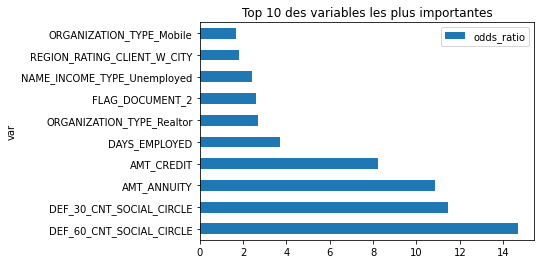

In [ ]:
results = results.sort_values(by = ["odds_ratio"], ascending=False)
ax = results.iloc[:10,].plot.barh(x='var', y='odds_ratio')
plt.title("Top 10 des variables les plus importantes")
plt.show()

### RandomForestClassifier

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold, df_max_depth = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
# Hyper-paramètres 
tuned_parameters = { 'max_depth': [None, 2, 5, 10], 'min_samples_split': [ 2, 3], 'n_estimators':[100, 500, 1000]}
for max_d in tuned_parameters["max_depth"]: 
  df_max_depth.append(max_d)
  #for min_samples in tuned_parameters["min_samples_split"]:
    #df_min_samples_split.append(min_samples)

  RF_smote = model(RandomForestClassifier(n_estimators=100, max_depth=max_d), X, y, smote=True)

  df_f1_val_score.append(RF_smote["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(RF_smote["f1_train_score"])
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(RF_smote["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(RF_smote["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(RF_smote["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'max_depth': df_max_depth}

df_RF_smote = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold','max_depth'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.9998, Val=0.0012, Fbeta-score: Train=0.9996, Val=0.0008
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.9999, Val=0.0008, Fbeta-score: Train=0.9999, Val=0.0005
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.9998, Val=0.0008, Fbeta-score: Train=0.9997, Val=0.0005
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.9998, Val=0.0008, Fbeta-score: Train=0.9997, Val=0.0005
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.9999, Val=0.0004, Fbeta-score: Train=0.9999, Val=0.0003
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2055, Val=0.2099, Fbeta-score: Train=0.2607, Val=0.2677
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2107, Val=0.2069, Fbeta-score: Train=0.2848, Val=0.2795
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2032, Val=0.1947, Fbeta-score: Train=0.2764, Val=0.2648
>Train: 0=226294

In [ ]:
df_RF_smote

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,max_depth
0,"[0.0004023335345001006, 0.00040257648953301127...",0.000964,"[0.9998740712756579, 0.9998740903024351, 0.999...",0.999884,"[0.9997985292636246, 0.9997985597018684, 0.999...",0.999815,"[0.0002514964036014285, 0.0002516482963410338,...",0.114865,"[1, 2, 3, 4, 5]",NaN
1,"[0.2090539441583085, 0.19996860775388478, 0.20...",0.103987,"[0.20558344389883598, 0.2001865816683511, 0.20...",0.603450,"[0.2832129882267814, 0.28244559494559496, 0.27...",0.638630,"[0.28901214210763004, 0.2809137414005997, 0.26...",0.114865,"[1, 2, 3, 4, 5]",2.0
2,"[0.16339712918660287, 0.1699831365935919, 0.16...",0.126431,"[0.1648833854291897, 0.1730977882876617, 0.166...",0.459382,"[0.14773204649008476, 0.16284718223599493, 0.1...",0.478920,"[0.14675547915771378, 0.1588502269288956, 0.14...",0.114865,"[1, 2, 3, 4, 5]",5.0
3,"[0.03375843960990248, 0.03558718861209964, 0.0...",0.103131,"[0.03784089836746248, 0.04141348041506965, 0.0...",0.353594,"[0.02482695427135056, 0.0273564865131904, 0.02...",0.365135,"[0.022231004841418833, 0.023468379446640316, 0...",0.114865,"[1, 2, 3, 4, 5]",10.0


In [ ]:
pipeline_smote = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['smote', SMOTE(random_state=11)],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', RandomForestClassifier(n_estimators=1000, max_depth=5)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline_smote.fit(X_train, y_train)

y_pred = pipeline_smote.predict(X_val)
y_pred_train = pipeline_smote.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.1663, Val=0.1699, Fbeta-score: Train=0.1509, Val=0.1552


In [ ]:
df_model.loc[2,:]={'subsample': None, 'max_depth':5, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':True, 'F1':0.1699, 'F2':0.1552, 'model': 'RandomForestClassifier', 'C': None, 'Feature engineering': False}

In [ ]:
feature_imp = pd.Series(pipeline_smote.named_steps['classifier'].feature_importances_,index=app_train.drop(columns = ['TARGET']).columns).sort_values(ascending=False)
feature_imp.head()

NAME_INCOME_TYPE_Working    0.061313
CODE_GENDER_M               0.059686
EXT_SOURCE_3                0.053820
CODE_GENDER_F               0.051694
EMERGENCYSTATE_MODE_No      0.049255
dtype: float64

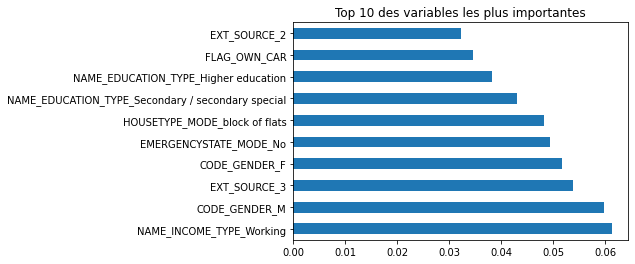

In [ ]:
ax = feature_imp.iloc[:10,].plot.barh(x=feature_imp.index, y=feature_imp[1])
plt.title("Top 10 des variables les plus importantes")
plt.show()

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold, df_max_depth = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
# Hyper-paramètres 
tuned_parameters = { 'max_depth': [None, 2, 5, 10], 'min_samples_split': [ 2, 3], 'n_estimators':[100, 500, 1000]}
for max_d in tuned_parameters["max_depth"]: 
  df_max_depth.append(max_d)
  #for min_samples in tuned_parameters["min_samples_split"]:
    #df_min_samples_split.append(min_samples)

  RF_balanced = model(RandomForestClassifier(n_estimators=100, max_depth=max_d, class_weight='balanced'), X, y, smote=False)

  df_f1_val_score.append(RF_balanced["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(RF_balanced["f1_train_score"])
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(RF_balanced["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(RF_balanced["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(RF_balanced["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'max_depth': df_max_depth}

df_RF_balanced = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold','max_depth'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.9997, Val=0.0028, Fbeta-score: Train=0.9995, Val=0.0018
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.9998, Val=0.0016, Fbeta-score: Train=0.9997, Val=0.0010
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.9997, Val=0.0008, Fbeta-score: Train=0.9995, Val=0.0005
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.9998, Val=0.0055, Fbeta-score: Train=0.9998, Val=0.0034
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.9997, Val=0.0041, Fbeta-score: Train=0.9996, Val=0.0026
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2249, Val=0.2277, Fbeta-score: Train=0.3725, Val=0.3778
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2345, Val=0.2315, Fbeta-score: Train=0.3828, Val=0.3777
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2298, Val=0.2227, Fbeta-score: Train=0.3801, Val=0.3690
>Train: 0=226294

In [ ]:
df_RF_balanced

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,max_depth
0,"[0.0028101164191087916, 0.0016057808109193096,...",0.002957,"[0.9996977177691571, 0.9997985292636244, 0.999...",0.999753,"[0.9995164361343098, 0.9996776857839287, 0.999...",0.999605,"[0.0017595013070581136, 0.0010058844238796962,...",0.001853,"[1, 2, 3, 4, 5]",NaN
1,"[0.22773017815857477, 0.23150826815243403, 0.2...",0.115490,"[0.22488120064271305, 0.23448509605950874, 0.2...",0.614440,"[0.37254557708318, 0.38280758567667683, 0.3801...",0.689075,"[0.3778033482243581, 0.37773892773892775, 0.36...",0.189254,"[1, 2, 3, 4, 5]",2.0
2,"[0.2413160073431482, 0.2409916617033949, 0.237...",0.157073,"[0.23999927678385782, 0.24517844854842008, 0.2...",0.491178,"[0.3899942414591438, 0.39443606682943183, 0.39...",0.591079,"[0.3925886018130285, 0.38752543996169037, 0.38...",0.255473,"[1, 2, 3, 4, 5]",5.0
3,"[0.2611483778424672, 0.2581170920008578, 0.251...",0.182186,"[0.293541456016178, 0.2964236077957075, 0.2983...",0.442552,"[0.450944605168631, 0.45406972586799804, 0.456...",0.556961,"[0.4007717608059462, 0.39368327402135234, 0.38...",0.290018,"[1, 2, 3, 4, 5]",10.0


In [ ]:
#Score en fonction des hyperparamètres

# Afficher les performances correspondantes
print("Résultats de la validation croisée :")
for f1_mean, f2_mean, params in zip(
        df_RF_balanced['f1_val_score_mean'], # F1-score moyen
        df_RF_balanced['f2_val_score_mean'], # F2-score moyen
        df_RF_balanced['max_depth'],
                    ):

    print("f1-score = {:.4f} et f2-score={:.4f}  for max_depth={}".format(
        f1_mean,
        f2_mean,
        params
    ) )

Résultats de la validation croisée :
f1-score = 0.0030 et f2-score=0.0019  for max_depth=nan
f1-score = 0.1155 et f2-score=0.1893  for max_depth=2.0
f1-score = 0.1571 et f2-score=0.2555  for max_depth=5.0
f1-score = 0.1822 et f2-score=0.2900  for max_depth=10.0


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', RandomForestClassifier(n_estimators=1000, max_depth=10, class_weight='balanced')]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2981, Val=0.2570, Fbeta-score: Train=0.4554, Val=0.3929


In [ ]:
df_model.loc[3,:]={'subsample': None, 'max_depth':10, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':False, 'F1':0.2570, 'F2':0.3929, 'model': 'RandomForestClassifier', 'C': None, 'Feature engineering': False}

In [ ]:
results = pd.DataFrame({"var":app_train.drop(columns = ['TARGET']).columns,"features_importance": pipeline.named_steps['classifier'].feature_importances_})
results.head()


,var,features_importance
0,SK_ID_CURR,0.007714
1,NAME_CONTRACT_TYPE,0.005787
2,FLAG_OWN_CAR,0.004112
3,FLAG_OWN_REALTY,0.000775
4,CNT_CHILDREN,0.001539


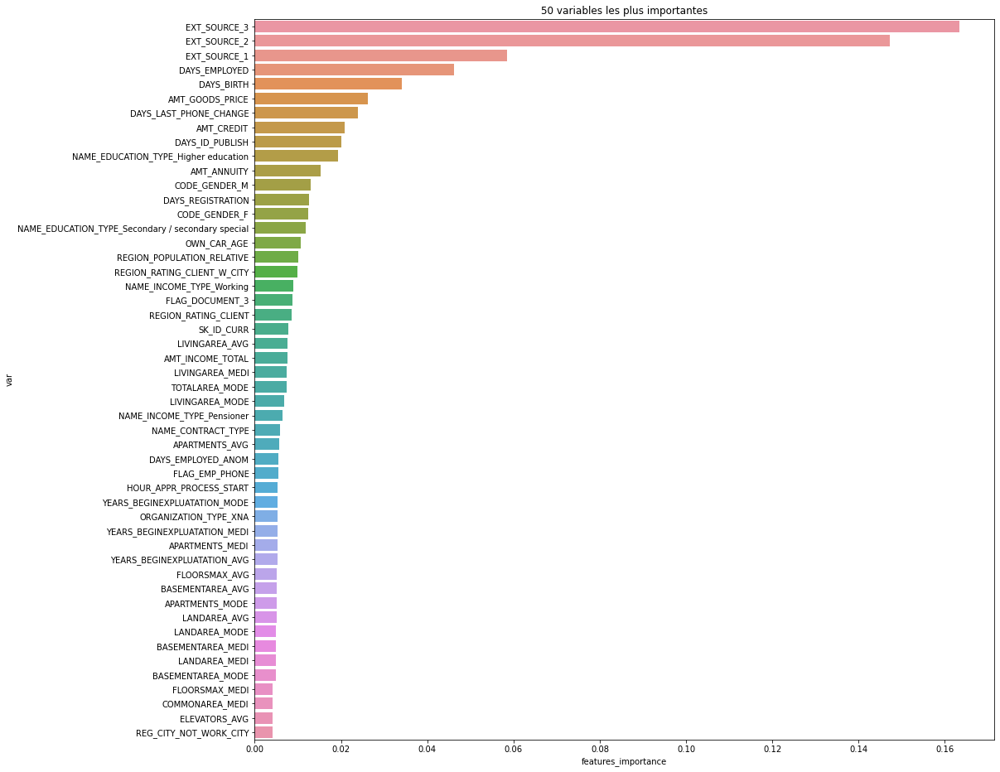

In [ ]:
plt.figure(figsize=(16, 16))
sns.barplot(data=results.sort_values(by='features_importance', ascending=False).head(50), x='features_importance', y='var');
plt.title('50 variables les plus importantes');

#### SHAP

In [ ]:
!pip install shap

     |████████████████████████████████| 356 kB 5.0 MB/s 
  Created wheel for shap: filename=shap-0.39.0-cp37-cp37m-linux_x86_64.whl size=491643 sha256=47ca8b61e97e4ea49f6173f3ba90cad020501643f8c55d3049a8581ff588faf6
  Stored in directory: /root/.cache/pip/wheels/ca/25/8f/6ae5df62c32651cd719e972e738a8aaa4a87414c4d2b14c9c0
Successfully built shap


In [ ]:
#On regarde les valeurs de SHAP pour un individu, l'individu 6 ici (5ème ligne). 
#Afin d'avoir le contexte, on regardera les prédictions pour cet individu avant les valeurs de SHAP.

index_choisi = 5
predicted_data = X_val.iloc[index_choisi]  # 1 ligne choisie, mais on aurait pu en choisir davantage
predicted_data_array = predicted_data.values.reshape(1, -1)

pipeline.predict_proba(predicted_data_array)

array([[0.48994484, 0.51005516]])

L'individu 6 (ligne 5) a 50.8% de chance de faire défaut selon les prédictions

In [ ]:
import shap  # package used to calculate Shap values

# Create object that can calculate shap values
explainer = shap.TreeExplainer(pipeline.named_steps['classifier'])

# Calculate Shap values
shap_values = explainer.shap_values(predicted_data)

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], predicted_data)

In [ ]:
explainer =  shap.TreeExplainer(pipeline.named_steps["classifier"])

observations = pipeline.named_steps["scaler"].transform(X_val.iloc[:1000,:])

shap_values = explainer.shap_values(observations)

In [ ]:
var = app_train.drop(columns = ['TARGET']).columns

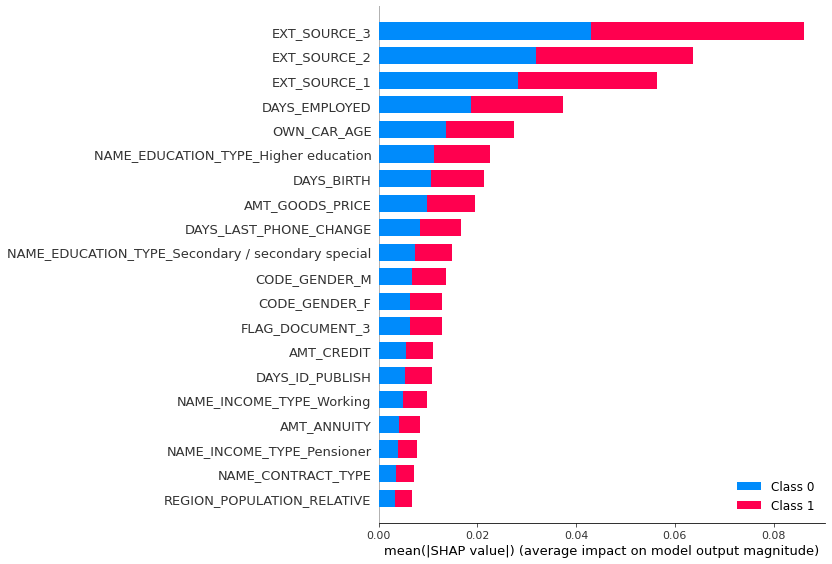

In [ ]:
#plot the feature importance
shap.summary_plot(shap_values, X_val, plot_type="bar")

In [ ]:
#plot the feature importance
shap.summary_plot(shap_values[0], X_val, plot_type='dot')

AssertionError: ignored

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], observations[5], feature_names=var)

### LightGBM
1. Arbre de décision
arbre de décision du titanic

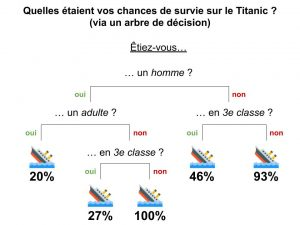

Exemple d’un arbre de décision (crédit de l’icône : Color Cinema Symbols by icons8 – Linkware License)
Un arbre de décision est tout simplement un algorithme que l’on va “dérouler” et où l’on trouvera des intersections : une question y sera posée, qui nous orientera vers l’une ou l’autre des branches en fonction de la réponse !

Le concept est simple et intuitif, car on a l’habitude de raisonner de cette manière.

Par exemple, dans l’arbre à gauche, on peut donner la probabilité de survivre à l’accident du Titanic en fonction de 2 ou 3 questions simples : un homme adulte en 3ème classe n’avait que 27% de chances de survie. Le point de départ s’appelle la racine (root), et on parle de feuilles (leaf) pour désigner le bout des branches (ici, les probabilités indiquées).

Les arbres de décisions peuvent être utilisés pour de nombreux problèmes et peuvent apprendre de différentes manières : en général, on va partir d’un arbre simple et on va remplacer certaines de ses feuilles par de nouvelles branches avec leurs feuilles, en s’appuyant sur les données d’apprentissage.

2. Gradient Boosting Machine
Il s’agit d’une technique de Machine Learning qui consiste à réunir plusieurs petites IA (entraînées sur un même problème mais souvent avec des données différentes/partielles) puis de les faire voter sur le résultat d’une nouvelle donnée.

Le schéma ci-contre présente le mode de fonctionnement de Random Forest, qui est très similaire à Boosted Decision Tree (on reviendra sur la différence juste après).

Pour l’algorithme Boosted Decision Tree (qui est du Gradient Boosting s’appuyant sur des arbres de décisions comme petites IA) on a donc :

* un ensemble de 3 arbres de décision qui ont été entraînés séparément sur les données des survivants du Titanic (et parfois on a enlevé une colonne d’informations pour certains : cela permet d’éviter que les arbres aient “les mêmes domaines d’expertise”)

* ensuite, on les a fait voter sur une nouvelle donnée entrante pour évaluer lesquels sont performants et lesquels le sont moins

* en fonction de leurs résultats, pour le vote suivant, on leur accorde plus ou moins de crédit (ce qui améliore la qualité de notre prédiction)

3. Quelle différence entre Random Forest et Gradient Boosting Machine ?

Les deux diffèrent dans la manière dont les arbres sont construits et dont les résultats sont assemblés (par exemple si on fait un vote majoritaire sur le résultat final, ou si on pondère les réponses en fonction du taux de prédiction correct individuel).

Ainsi, dans Gradient Boosting, les arbres sont construits 1 à 1, avec chaque nouvel arbre qui vient corriger les prédictions incorrectes de l’arbre précédent : ils sont donc mis bout à bout, ce qui ralentit le processus de fabrication des arbres car dans Random Forest, on peut tous les entraîner en même temps, ils sont indépendants.

4. Mise bout-à-bout : Light GBM
Light GBM appartient à la famille des GBM, avec tous les avantages que cela comporte (haute précision surtout lorsque les données ne sont pas équilibrées) et les inconvénients (lenteur d’apprentissage). Heureusement, grâce à son architecture particulière, Light GBM est en réalité très rapide (surtout comparé à XGBoost) !

Habituellement, les arbres dans les algorithmes de Gradient Boosting apprennent en divisant leurs feuilles par étage. On parle de “level-wise tree growth” pour signifier que d’une itération à l’autre, on a divisé toutes les feuilles de l’arbre en un nouveau lot de feuilles, ce qui a créé un nouveau niveau (ou étage).

Dans le schéma ci-dessous, ce sont donc les feuilles 2.1 et 2.2 qui sont sélectionnées à l’étape 1 pour être divisées : chacune devient le noeud (et n’est plus une feuille) qui va vers deux feuilles. A l’étape 2, on sélectionne les feuilles du niveau suivant : 3.1, 3.2, 3.3, 3.4 pour qu’elles soient divisées.
  4.1 Croissance de l’arbre par niveaux

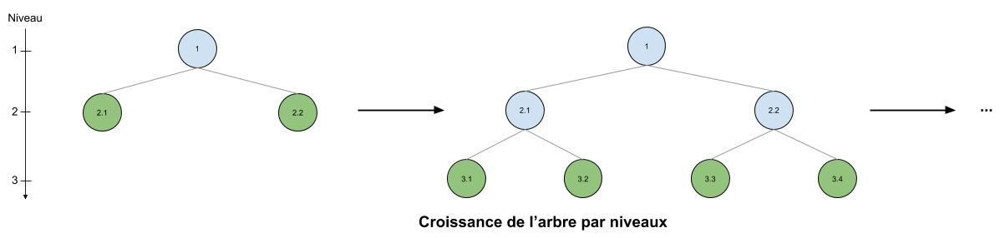


Croissance de l’arbre par niveaux (crédit : Lambert Rosique)

  4.2 Croissance de l’arbre par feuilles 
A l’inverse, pour Light GBM, la division des arbres se fait par les feuilles et non les niveaux : on parle de “leaf-wise tree growth“. Ce coup-ci, on ne se soucie plus de prendre les feuilles du dernier niveau mais on choisit une feuille dans l’arbre et elle se divise. Par exemple (cf schéma ci-après) à l’étape 1 on choisit la feuille 2.1, puis à l’étape 2 on prend la feuille 3.2 (qui va donc se diviser en deux nouvelles feuilles), mais à l’étape 3 on peut très bien prendre la feuille 2.2 car on n’est pas restreint au dernier niveau de l’arbre !

Attention toutefois avec LightGBM : il peut facilement sur-apprendre, donc il est déconseillé de l’utiliser avec moins de 10 000 lignes, et il faut être vigilant dans ses résultats.

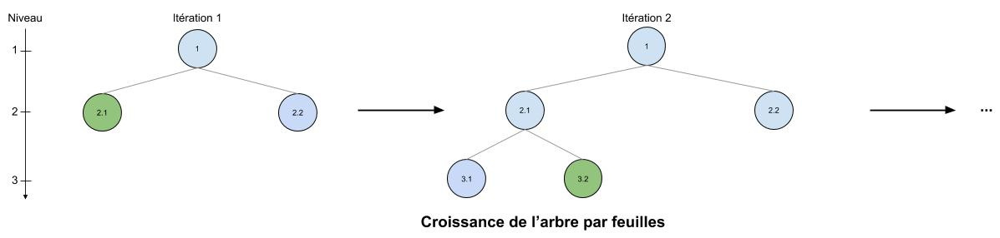
  
5. Paramétrages
* Le nombre de feuilles des arbres (num_leaves)
* La vitesse d’apprentissage comme dans beaucoup d’algorithmes (learning_rate)
* L’indication comme quoi le dataset est déséquilibré, très importante ici (is_unbalanced)
* Le gain minimal à atteindre pour couper un arbre (min_split_gain)
* Le poids minimal d’une feuille, pour éviter l’overfitting (min_child_weight)
* La régularisation L2 voulue (reg_lambda)
* Le ratio voulu de données à garder, par exemple si on veut accélérer l’entraînement ou éviter de l’overfitting, on peut enlever une partie des données à la volée ainsi (subsample)
* Le type d’output attendu et donc le “loss” à utiliser pour évaluer l’erreur commise par l’algorithme : ici c’est du binary, puisque soit la donnée est frauduleuse = 1 soit elle ne l’est pas = 0 (objective)

* Eventuellement le paramètre “device” pour forcer l’utilisation du GPU plutôt que du CPU par l’algorithme (ce n’est pas indispensable, puisqu’avec le CPU l’entraînement est terminé en moins de 10s)
* Et enfin la tâche à accomplir, ici de l’entraînement (task)

* Ainsi que le nombre d’epochs qui viendra en paramètre externe à LightGBM

Pour savoir combien d’epoch réaliser, il “suffit” de regarder la courbe d’apprentissage et de repérer le moment où il y a de l’overfitting ou plus de gain. Ensuite, on peut soit s’arrêter là, soit diminuer la vitesse d’apprentissage et continuer (pour améliorer plus finement les résultats).

Selon la documentation, il ya 3 hyper-paramètres importants : 
* num_leaves. This is the main parameter to control the complexity of the tree model. Theoretically, we can set num_leaves = 2^(max_depth) to obtain the same number of leaves as depth-wise tree. However, this simple conversion is not good in practice. The reason is that a leaf-wise tree is typically much deeper than a depth-wise tree for a fixed number of leaves. Unconstrained depth can induce over-fitting. Thus, when trying to tune the num_leaves, we should let it be smaller than 2^(max_depth). For example, when the max_depth=7 the depth-wise tree can get good accuracy, but setting num_leaves to 127 may cause over-fitting, and setting it to 70 or 80 may get better accuracy than depth-wise.

* min_data_in_leaf. This is a very important parameter to prevent over-fitting in a leaf-wise tree. Its optimal value depends on the number of training samples and num_leaves. Setting it to a large value can avoid growing too deep a tree, but may cause under-fitting. In practice, setting it to hundreds or thousands is enough for a large dataset.

* max_depth. You also can use max_depth to limit the tree depth explicitly.

5.1 For Better Accuracy
  Use large max_bin (may be slower)

  Use small learning_rate with large num_iterations

  Use large num_leaves (may cause over-fitting)

  Use bigger training data

  Try dart

5.2 Deal with Over-fitting
  Use small max_bin

  Use small num_leaves

  Use min_data_in_leaf and min_sum_hessian_in_leaf

  Use bagging by set bagging_fraction and bagging_freq

  Use feature sub-sampling by set feature_fraction

  Use bigger training data

  Try lambda_l1, lambda_l2 and min_gain_to_split for regularization

  Try max_depth to avoid growing deep tree

  Try extra_trees

  Try increasing path_smooth

In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                     ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                     ['classifier', lgb.LGBMClassifier(**param)]])

    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
    
    pipeline.fit(X_train,y_train,verbose=True)
    
    y_pred = pipeline.predict(X_val)
    y_pred_train = pipeline.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f1_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-09-24 08:44:02,089] A new study created in memory with name: no-name-115d6676-bb76-4fe1-93d5-b21ac09122c9
[I 2021-09-24 08:44:51,359] Trial 0 finished with value: 0.28169551327897774 and parameters: {'subsample': 0.4, 'max_depth': 10, 'num_leaves': 967, 'min_child_samples': 113, 'min_child_weight': 0, 'reg_lambda': 2.3693144158642925}. Best is trial 0 with value: 0.28169551327897774.
[I 2021-09-24 08:45:42,121] Trial 1 finished with value: 0.27711329122429784 and parameters: {'subsample': 0.4, 'max_depth': 20, 'num_leaves': 123, 'min_child_samples': 59, 'min_child_weight': 1, 'reg_lambda': 0.003869172335749096}. Best is trial 0 with value: 0.28169551327897774.
[I 2021-09-24 08:46:17,694] Trial 2 finished with value: 0.26562377171606005 and parameters: {'subsample': 0.4, 'max_depth': 5, 'num_leaves': 22, 'min_child_samples': 220, 'min_child_weight': 0, 'reg_lambda': 6.39510361238112}. Best is trial 0 with value: 0.28169551327897774.
[I 2021-09-24 08:46:53,905] Trial 3 finished w

KeyboardInterrupt: ignored

In [ ]:
print('Best trial:', study.best_trial.params)

Best trial: {'subsample': 0.7, 'max_depth': 100, 'num_leaves': 595, 'min_child_samples': 269, 'min_child_weight': 1, 'reg_lambda': 0.4918481755325586}


In [ ]:
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_max_depth,params_min_child_samples,params_min_child_weight,params_num_leaves,params_reg_lambda,params_subsample,state
0,0,0.281696,2021-09-24 08:44:02.100716,2021-09-24 08:44:51.358914,0 days 00:00:49.258198,10,113,0,967,2.369314,0.4,COMPLETE
1,1,0.277113,2021-09-24 08:44:51.361481,2021-09-24 08:45:42.120857,0 days 00:00:50.759376,20,59,1,123,0.003869,0.4,COMPLETE
2,2,0.265624,2021-09-24 08:45:42.123727,2021-09-24 08:46:17.694305,0 days 00:00:35.570578,5,220,0,22,6.395104,0.4,COMPLETE
3,3,0.265674,2021-09-24 08:46:17.697485,2021-09-24 08:46:53.905254,0 days 00:00:36.207769,5,9,1,921,0.320936,0.5,COMPLETE
4,4,0.265392,2021-09-24 08:46:53.907960,2021-09-24 08:47:32.435864,0 days 00:00:38.527904,5,130,0,381,2.854551,0.8,COMPLETE
...,...,...,...,...,...,...,...,...,...,...,...,...
120,120,0.295015,2021-09-24 11:15:43.800187,2021-09-24 11:17:12.891518,0 days 00:01:29.091331,100,239,1,704,0.362827,0.7,COMPLETE
121,121,0.297653,2021-09-24 11:17:12.894063,2021-09-24 11:18:33.328329,0 days 00:01:20.434266,100,276,1,557,0.223219,0.7,COMPLETE
122,122,0.299875,2021-09-24 11:18:33.333539,2021-09-24 11:19:53.500373,0 days 00:01:20.166834,100,263,1,538,0.332537,0.7,COMPLETE
123,123,0.296735,2021-09-24 11:19:53.502871,2021-09-24 11:21:14.239059,0 days 00:01:20.736188,100,285,1,642,0.432421,0.7,COMPLETE


In [ ]:
df_model.loc[4,:]={'subsample': 0.7, 'max_depth': 100, 'num_leaves': 595, 'min_child_samples': 269, 'min_child_weight': 1, 'reg_lambda': 0.4918481755325586, 'smote': False, 'F1':0.301, 'F2':None,'C':None,"model":'LGBM','Feature engineering':False}

In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))]])
    X_train = pipeline.fit_transform(X_train)
    X_val = pipeline.transform(X_val)

    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f2_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-09-24 13:22:53,139] A new study created in memory with name: no-name-0a28da68-0be0-43c3-a288-47cbcef1a86d
[I 2021-09-24 13:24:16,956] Trial 0 finished with value: 0.3569093099294442 and parameters: {'subsample': 0.8, 'max_depth': 20, 'num_leaves': 986, 'min_child_samples': 134, 'min_child_weight': 0, 'reg_lambda': 0.6999964440355205}. Best is trial 0 with value: 0.3569093099294442.
[I 2021-09-24 13:24:53,342] Trial 1 finished with value: 0.41833511577586 and parameters: {'subsample': 0.8, 'max_depth': 5, 'num_leaves': 480, 'min_child_samples': 117, 'min_child_weight': 0, 'reg_lambda': 0.0046826387546971895}. Best is trial 1 with value: 0.41833511577586.
[I 2021-09-24 13:25:42,546] Trial 2 finished with value: 0.4030266482885367 and parameters: {'subsample': 1.0, 'max_depth': 10, 'num_leaves': 980, 'min_child_samples': 66, 'min_child_weight': 0, 'reg_lambda': 0.00783932557100413}. Best is trial 1 with value: 0.41833511577586.
[I 2021-09-24 13:26:55,865] Trial 3 finished with val

KeyboardInterrupt: ignored

In [ ]:
print('Best trial:', study.best_trial.params)

Best trial: {'subsample': 0.4, 'max_depth': 10, 'num_leaves': 37, 'min_child_samples': 145, 'min_child_weight': 0, 'reg_lambda': 0.3867490951255623}


In [ ]:
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_max_depth,params_min_child_samples,params_min_child_weight,params_num_leaves,params_reg_lambda,params_subsample,state
0,0,0.356909,2021-09-24 13:22:53.148962,2021-09-24 13:24:16.955859,0 days 00:01:23.806897,20.0,134.0,0.0,986.0,0.699996,0.8,COMPLETE
1,1,0.418335,2021-09-24 13:24:16.958578,2021-09-24 13:24:53.341803,0 days 00:00:36.383225,5.0,117.0,0.0,480.0,0.004683,0.8,COMPLETE
2,2,0.403027,2021-09-24 13:24:53.344488,2021-09-24 13:25:42.546159,0 days 00:00:49.201671,10.0,66.0,0.0,980.0,0.007839,1.0,COMPLETE
3,3,0.352343,2021-09-24 13:25:42.548557,2021-09-24 13:26:55.865161,0 days 00:01:13.316604,100.0,56.0,1.0,604.0,0.006803,0.6,COMPLETE
4,4,0.418546,2021-09-24 13:26:55.868126,2021-09-24 13:27:30.989929,0 days 00:00:35.121803,5.0,159.0,1.0,789.0,0.024468,0.5,COMPLETE
...,...,...,...,...,...,...,...,...,...,...,...,...
181,181,0.420405,2021-09-24 15:32:56.167146,2021-09-24 15:33:34.568319,0 days 00:00:38.401173,100.0,152.0,0.0,30.0,0.418872,0.4,COMPLETE
182,182,0.417255,2021-09-24 15:33:34.570654,2021-09-24 15:34:13.297286,0 days 00:00:38.726632,100.0,149.0,0.0,28.0,0.233498,0.4,COMPLETE
183,183,0.420576,2021-09-24 15:34:13.299675,2021-09-24 15:34:50.454950,0 days 00:00:37.155275,100.0,135.0,0.0,18.0,0.544741,0.4,COMPLETE
184,184,0.419624,2021-09-24 15:34:50.457292,2021-09-24 15:35:33.112669,0 days 00:00:42.655377,100.0,93.0,0.0,50.0,0.436056,0.4,COMPLETE


In [ ]:
df_model.loc[5,:]={'subsample': 0.4, 'max_depth': 10, 'num_leaves': 37, 'min_child_samples': 145, 'min_child_weight': 0, 'reg_lambda': 0.3867490951255623, 'smote':False, 'F1':None, 'F2':0.42386047560578344, 'C':None,'model': 'LGBM','Feature engineering':False}

In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline_smote = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                          ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['smote', SMOTE(random_state=11)]])
                                        
    X_train, y_train = pipeline_smote.fit_resample(X_train, y_train)
    #pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                          #['scaler', MinMaxScaler(feature_range = (0, 1))]])
    #X_val = pipeline.transform(X_val)

    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f1_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-09-27 07:21:17,246] A new study created in memory with name: no-name-3a9b7dc4-7139-4f77-ba06-b5853da47c45
[I 2021-09-27 07:28:07,115] Trial 0 finished with value: 0.004008016032064129 and parameters: {'subsample': 0.7, 'max_depth': 100, 'num_leaves': 801, 'min_child_samples': 83, 'min_child_weight': 1, 'reg_lambda': 0.03212146080537308}. Best is trial 0 with value: 0.004008016032064129.
[I 2021-09-27 07:32:47,498] Trial 1 finished with value: 0.0 and parameters: {'subsample': 1.0, 'max_depth': 5, 'num_leaves': 389, 'min_child_samples': 113, 'min_child_weight': 1, 'reg_lambda': 0.9478545330523271}. Best is trial 0 with value: 0.004008016032064129.
[I 2021-09-27 07:38:07,027] Trial 2 finished with value: 0.14094516167239135 and parameters: {'subsample': 0.8, 'max_depth': 10, 'num_leaves': 985, 'min_child_samples': 78, 'min_child_weight': 0, 'reg_lambda': 1.0349418503109815}. Best is trial 2 with value: 0.14094516167239135.
[I 2021-09-27 07:43:17,768] Trial 3 finished with value: 

Trial 60 finished with value: 0.22558091712934406 and parameters: {'subsample': 0.7, 'max_depth': 10, 'num_leaves': 202, 'min_child_samples': 33, 'min_child_weight': 0, 'reg_lambda': 0.04139581762557417}. Best is trial 60 with value: 0.22558091712934406.

In [ ]:
df_model.loc[6,:]={'subsample': 0.7, 'max_depth': 10, 'num_leaves': 202, 'min_child_samples': 33, 'min_child_weight': 0, 'reg_lambda': 0.04139581762557417, 'smote':True, 'F1':0.22558091712934406, 'F2':None, 'C':None, 'model': 'LGBM', 'Feature engineering': False}

In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline_smote = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                          ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['smote', SMOTE(random_state=11)]])
                                        
    X_train, y_train = pipeline_smote.fit_resample(X_train, y_train)
    #pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                          #['scaler', MinMaxScaler(feature_range = (0, 1))]])
    #X_val = pipeline.transform(X_val)

    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f2_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-09-29 09:45:51,582] A new study created in memory with name: no-name-73fcb964-c317-4e30-84cd-546360d0dba8
[I 2021-09-29 09:52:29,155] Trial 0 finished with value: 0.029075497733096783 and parameters: {'subsample': 0.7, 'max_depth': 100, 'num_leaves': 912, 'min_child_samples': 270, 'min_child_weight': 0, 'reg_lambda': 0.9477113970784509}. Best is trial 0 with value: 0.029075497733096783.
[I 2021-09-29 09:57:49,097] Trial 1 finished with value: 0.0 and parameters: {'subsample': 0.7, 'max_depth': 5, 'num_leaves': 121, 'min_child_samples': 149, 'min_child_weight': 1, 'reg_lambda': 0.033332988585987676}. Best is trial 0 with value: 0.029075497733096783.
[I 2021-09-29 10:02:42,506] Trial 2 finished with value: 0.0015143102316894652 and parameters: {'subsample': 1.0, 'max_depth': 10, 'num_leaves': 27, 'min_child_samples': 57, 'min_child_weight': 1, 'reg_lambda': 2.032979232904419}. Best is trial 0 with value: 0.029075497733096783.
[I 2021-09-29 10:09:20,253] Trial 3 finished with valu

KeyboardInterrupt: ignored

In [ ]:
print('Best trial:', study.best_trial.params)

Best trial: {'subsample': 0.4, 'max_depth': 100, 'num_leaves': 304, 'min_child_samples': 2, 'min_child_weight': 0, 'reg_lambda': 0.0018533665591059015}


In [ ]:
df_model.loc[7,:]={'subsample': 0.4, 'max_depth': 100, 'num_leaves': 304, 'min_child_samples': 2, 'min_child_weight': 0, 'reg_lambda': 0.0018533665591059015, 'smote':True, 'F1':None, 'F2':0.3211627553732817, 'model': 'LGBM', 'C': None, 'Feature engineering': False}

In [ ]:
df_model

,subsample,max_depth,num_leaves,min_child_samples,min_child_weight,reg_lambda,smote,F1,F2,model,C,Feature engineering
0,None,None,None,None,None,None,True,0.2581,0.4078,LogisticRegression,1000,False
1,None,None,None,None,None,None,False,0.2569,0.4082,LogisticRegression,1000,False
2,None,5,None,None,None,None,True,0.1699,0.1552,RandomForestClassifier,None,False
3,None,10,None,None,None,None,False,0.257,0.3929,RandomForestClassifier,None,False
4,0.7,100,595,269,1,0.491848,False,0.301,None,LGBM,None,False
5,0.4,10,37,145,0,0.386749,False,None,0.42386,LGBM,None,False
6,0.7,10,202,33,0,0.0413958,True,0.225581,None,LGBM,None,False
7,0.4,100,304,2,0,0.00185337,True,None,0.321163,LGBM,None,False


In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold, df_max_depth, df_num_leaves = [], [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
# Hyper-paramètres 
tuned_parameters = { 'max_depth': [None, 2, 5, 10]}
for max_d in tuned_parameters["max_depth"]:
  if max_d==None:
    n_leaves = 31
  else :
    n_leaves = 2**max_d -1

  df_max_depth.append(max_d)

  LGBM_smote = model(lgb.LGBMClassifier(n_estimators=100, max_depth=max_d, num_leaves=n_leaves), X, y, smote=True)

  df_f1_val_score.append(LGBM_smote["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(LGBM_smote["f1_train_score"])
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(LGBM_smote["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(LGBM_smote["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(LGBM_smote["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'max_depth': df_max_depth}

df_LGBM_smote = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold','max_depth'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.0333, Val=0.0295, Fbeta-score: Train=0.0212, Val=0.0188
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.0356, Val=0.0270, Fbeta-score: Train=0.0227, Val=0.0172
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.0349, Val=0.0266, Fbeta-score: Train=0.0223, Val=0.0169
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.0383, Val=0.0348, Fbeta-score: Train=0.0245, Val=0.0223
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.0368, Val=0.0301, Fbeta-score: Train=0.0235, Val=0.0191
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.0000, Val=0.0000, Fbeta-score: Train=0.0000, Val=0.0000
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.0000, Val=0.0000, Fbeta-score: Train=0.0000, Val=0.0000
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.0000, Val=0.0000, Fbeta-score: Train=0.0000, Val=0.0000
>Train: 0=226294

In [ ]:
df_LGBM_smote

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,max_depth
0,"[0.029492725127801805, 0.027048216385731082, 0...",0.029610,"[0.033272807577170334, 0.03556382874497894, 0....",0.035779,"[0.021202872082259634, 0.022690903635545333, 0...",0.022828,"[0.018753750750150032, 0.01724741288806679, 0....",0.018881,"[1, 2, 3, 4, 5]",NaN
1,"[0.0, 0.0, 0.0, 0.0, 0.0]",0.014805,"[0.0, 0.0, 0.0, 0.0, 0.0]",0.017889,"[0.0, 0.0, 0.0, 0.0, 0.0]",0.011414,"[0.0, 0.0, 0.0, 0.0, 0.0]",0.009441,"[1, 2, 3, 4, 5]",2.0
2,"[0.011971268954509177, 0.014311270125223614, 0...",0.014411,"[0.019083590100387637, 0.020052613292301583, 0...",0.018193,"[0.0120471344133924, 0.012669183778427268, 0.0...",0.011565,"[0.007529364521634374, 0.009030704394942806, 0...",0.009158,"[1, 2, 3, 4, 5]",5.0
3,"[0.048864948056944975, 0.03898861223701988, 0....",0.021506,"[0.15567977086894258, 0.15881511558159922, 0.1...",0.054178,"[0.1037408264788455, 0.10591160288995287, 0.11...",0.035756,"[0.0315794708573702, 0.025146897719350664, 0.0...",0.013774,"[1, 2, 3, 4, 5]",10.0


In [ ]:
df_model.loc[9,:]={'subsample': 1, 'max_depth':10, 'num_leaves': 1023, 'min_child_samples': 20, 'min_child_weight': 1e-3, 'reg_lambda': 0, 'smote':True, 'F1':0.021506, 'F2':0.013774, 'model': 'LGBM', 'C': None, 'Feature engineering': False}

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold, df_max_depth, df_num_leaves = [], [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
# Hyper-paramètres 
tuned_parameters = { 'max_depth': [None, 2, 5, 10]}
for max_d in tuned_parameters["max_depth"]:
  if max_d==None:
    n_leaves = 31
  else :
    n_leaves = 2**max_d -1

  df_max_depth.append(max_d)

  LGBM_smote = model(lgb.LGBMClassifier(n_estimators=100, max_depth=max_d, num_leaves=n_leaves, is_unbalance=True), X, y, smote=False)

  df_f1_val_score.append(LGBM_smote["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(LGBM_smote["f1_train_score"])
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(LGBM_smote["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(LGBM_smote["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(LGBM_smote["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'max_depth': df_max_depth}

df_LGBM_unbalanced = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold','max_depth'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2892, Val=0.2719, Fbeta-score: Train=0.4528, Val=0.4265
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2892, Val=0.2660, Fbeta-score: Train=0.4535, Val=0.4169
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2893, Val=0.2628, Fbeta-score: Train=0.4545, Val=0.4135
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2872, Val=0.2742, Fbeta-score: Train=0.4517, Val=0.4264
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2894, Val=0.2617, Fbeta-score: Train=0.4548, Val=0.4141
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2587, Val=0.2612, Fbeta-score: Train=0.4095, Val=0.4140
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2583, Val=0.2551, Fbeta-score: Train=0.4107, Val=0.4066
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2581, Val=0.2532, Fbeta-score: Train=0.4114, Val=0.4047
>Train: 0=226294

In [ ]:
df_LGBM_unbalanced

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,max_depth
0,"[0.271884081047729, 0.2659638193362885, 0.2627...",0.267315,"[0.28921239567574064, 0.2891765738450491, 0.28...",0.288845,"[0.4528028411158657, 0.45349040903915216, 0.45...",0.453446,"[0.4265444280682471, 0.41685443893645785, 0.41...",0.419478,"[1, 2, 3, 4, 5]",NaN
1,"[0.2611758331075589, 0.2551129426129426, 0.253...",0.262170,"[0.25866158572150716, 0.25829386162966095, 0.2...",0.273662,"[0.40952269551138004, 0.41067598697275404, 0.4...",0.432154,"[0.4140182099295654, 0.40660196064122217, 0.40...",0.414000,"[1, 2, 3, 4, 5]",2.0
2,"[0.2685870296363708, 0.26571634499879876, 0.26...",0.263362,"[0.28328053081475285, 0.28493096057026074, 0.2...",0.277141,"[0.44445069682816574, 0.4469004684792875, 0.44...",0.436779,"[0.4223178956275042, 0.416050156739812, 0.4111...",0.415023,"[1, 2, 3, 4, 5]",5.0
3,"[0.2822863729239797, 0.275829132395861, 0.2751...",0.267115,"[0.461316412243518, 0.4650167642953125, 0.4715...",0.324457,"[0.6499182976603087, 0.6541383740135805, 0.662...",0.491705,"[0.39621143042033125, 0.3850826764653588, 0.38...",0.408583,"[1, 2, 3, 4, 5]",10.0


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', lgb.LGBMClassifier(n_estimators=1000, max_depth=2, num_leaves=3, is_unbalance=True)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2770, Val=0.2678, Fbeta-score: Train=0.4333, Val=0.4206


In [ ]:
df_model.loc[8,:]={'subsample': 1, 'max_depth':2, 'num_leaves': 3, 'min_child_samples': 20, 'min_child_weight': 1e-3, 'reg_lambda': 0, 'smote':False, 'F1':0.2678, 'F2':0.4206, 'model': 'LGBM', 'C': None, 'Feature engineering': False}

In [ ]:
cm = metrics.confusion_matrix(y_val, y_pred)  
print ("Confusion Matrix : \n", cm)
print ("Vrais positifs : (VP)", cm[0][0])
print ("Faux positifs : (FP)", cm[0][1])
print ("Faux négatifs : (FN)", cm[1][0])
print ("Vrais négatifs : (VN)", cm[1][1])

Confusion Matrix : 
 [[39767 16787]
 [ 1589  3360]]
Vrais positifs : (VP) 39767
Faux positifs : (FP) 16787
Faux négatifs : (FN) 1589
Vrais négatifs : (VN) 3360


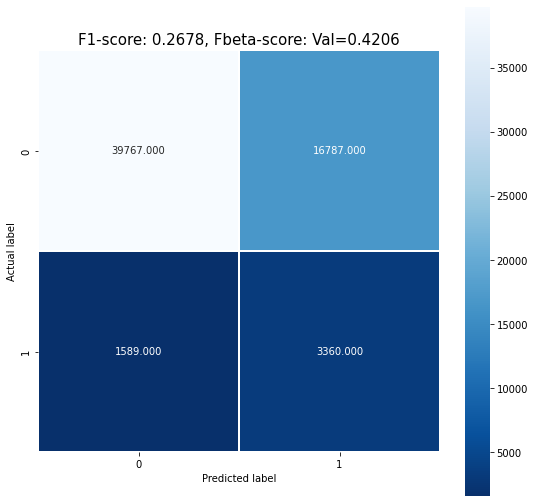

In [ ]:
plt.figure(figsize=(9,9))
sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues_r');
plt.ylabel('Actual label');
plt.xlabel('Predicted label');
all_sample_title ='F1-score: %.4f, Fbeta-score: Val=%.4f' % (f1_score_val,f2_score_val)
plt.title(all_sample_title, size = 15);

In [ ]:
results = pd.DataFrame({"var":app_train.drop(columns = ['TARGET']).columns,"features_importance": pipeline.named_steps['classifier'].feature_importances_})
results.head()

,var,features_importance
0,SK_ID_CURR,19
1,NAME_CONTRACT_TYPE,24
2,FLAG_OWN_CAR,25
3,FLAG_OWN_REALTY,0
4,CNT_CHILDREN,5


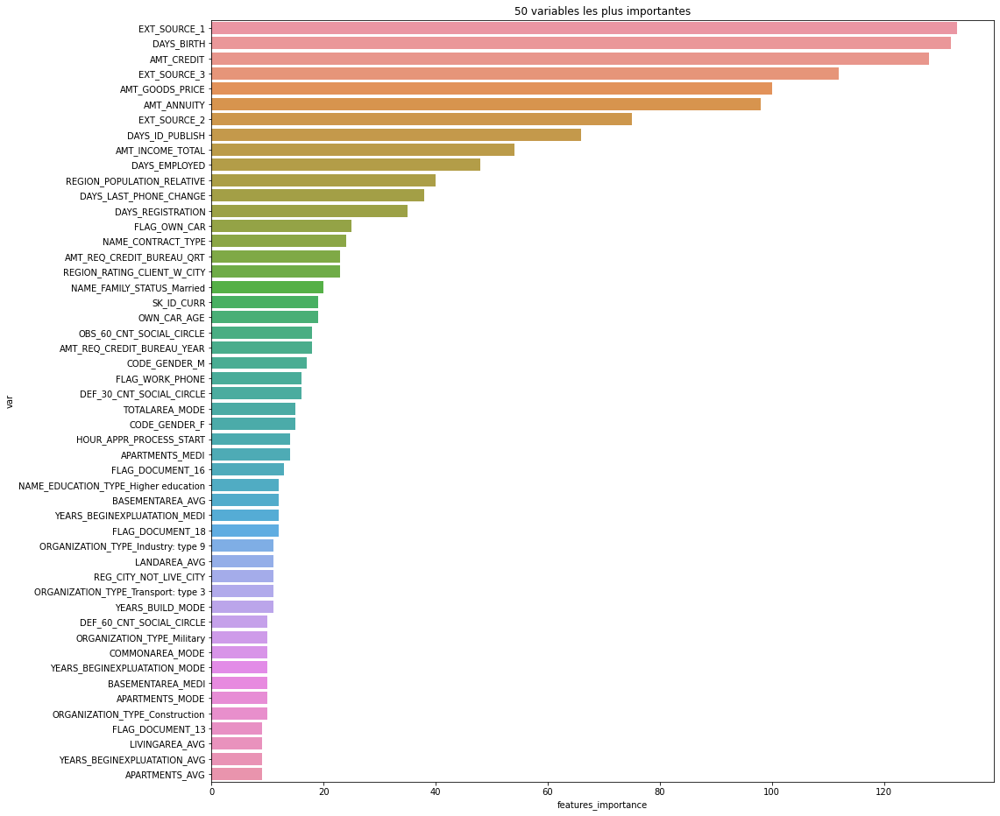

In [ ]:
plt.figure(figsize=(16, 16))
sns.barplot(data=results.sort_values(by='features_importance', ascending=False).head(50), x='features_importance', y='var');
plt.title('50 variables les plus importantes');

In [ ]:
#On regarde les valeurs de SHAP pour un individu, l'individu 6 ici (5ème ligne). 
#Afin d'avoir le contexte, on regardera les prédictions pour cet individu avant les valeurs de SHAP.

index_choisi = 5
predicted_data = X_val.iloc[index_choisi]  # 1 ligne choisie, mais on aurait pu en choisir davantage
predicted_data_array = predicted_data.values.reshape(1, -1)

pipeline.predict_proba(predicted_data_array)

array([[0.28408016, 0.71591984]])

L'individu 6 a 75.2% de chance de faire défaut

In [ ]:
# Create object that can calculate shap values
explainer = shap.TreeExplainer(pipeline.named_steps['classifier'])

# Calculate Shap values
shap_values = explainer.shap_values(predicted_data_array)

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], predicted_data)

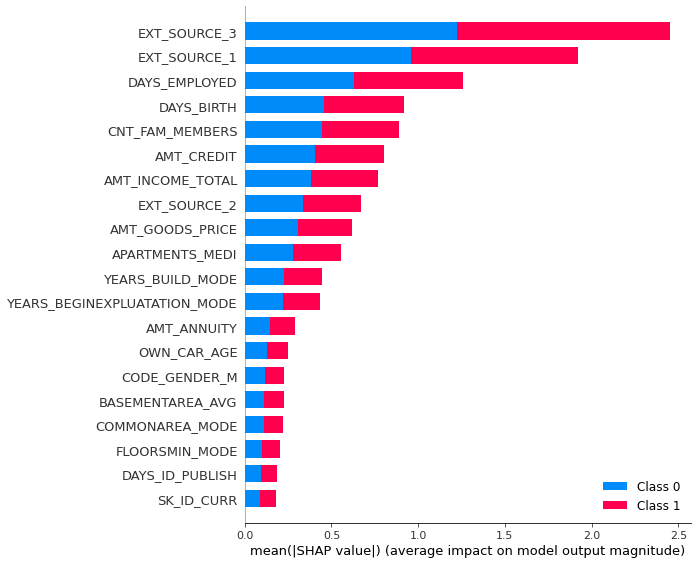

In [ ]:
#plot the feature importance
shap.summary_plot(shap_values, X_val, plot_type="bar")

In [ ]:
df_model

,subsample,max_depth,num_leaves,min_child_samples,min_child_weight,reg_lambda,smote,F1,F2,model,C,Feature engineering
0,None,None,None,None,None,None,True,0.2581,0.4078,LogisticRegression,1000,False
1,None,None,None,None,None,None,False,0.2569,0.4082,LogisticRegression,1000,False
2,None,5,None,None,None,None,True,0.1699,0.1552,RandomForestClassifier,None,False
3,None,10,None,None,None,None,False,0.257,0.3929,RandomForestClassifier,None,False
4,0.7,100,595,269,1,0.491848,False,0.301,None,LGBM,None,False
5,0.4,10,37,145,0,0.386749,False,None,0.42386,LGBM,None,False
6,0.7,10,202,33,0,0.0413958,True,0.225581,None,LGBM,None,False
7,0.4,100,304,2,0,0.00185337,True,None,0.321163,LGBM,None,False
8,1,2,3,20,0.001,0,False,0.2678,0.4206,LGBM,None,False
9,1,10,1023,20,0.001,0,False,0.021506,0.013774,LGBM,None,False


In [ ]:

def load_model(model, X, y, smote=True):

  f1_val_score = []
  f1_train_score = []

  f2_val_score = []
  f2_train_score = []
  nb_fold = []
  fold = 1

  # Etape 1 : prepare cross validation
  kfold = model_selection.KFold(n_splits = 5, shuffle = True, random_state = 1)
  # enumerate splits
  for train_ix, val_ix in kfold.split(X):

    # select rows : split into train and validation set 
    X_train, X_val = X.iloc[train_ix], X.iloc[val_ix]
    y_train, y_val = y[train_ix], y[val_ix]

    # summarize
    train_0, train_1 = len(y_train[y_train==0]), len(y_train[y_train==1])
    val_0, val_1 = len(y_val[y_val==0]), len(y_val[y_val==1])

    print('>Train: 0=%d, 1=%d, Val: 0=%d, 1=%d' % (train_0, train_1, val_0, val_1))
    
    #pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        #['scaler', MinMaxScaler(feature_range = (0, 1))]])
    
    #X_train = pipeline.fit_transform(X_train)
    #X_val = pipeline.transform(X_val)

    if smote == True:
        pipeline = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['smote', SMOTE(random_state=11)],
                                        ['classifier', model]])
    else:
        
        pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                     ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                     ['classifier', model]])
    
    
    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_val)
    y_pred_train = pipeline.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)

    print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

    f1_val_score.append(f1_score_val)
    f1_train_score.append(f1_score_train)

    f2_val_score.append(f2_score_val)
    f2_train_score.append(f2_score_train)

    nb_fold.append(fold)

    fold = fold +1

  return {'f1_val_score':f1_val_score, 'f1_train_score': f1_train_score, 'f2_val_score':f2_val_score, 'f2_train_score': f2_train_score, 'fold': nb_fold}


In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold= [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}

LGBM_balanced = load_model(lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=10, num_leaves=37, min_child_samples=145, min_child_weight=0, reg_lambda=0.3867490951255623), X, y, smote=False)

df_f1_val_score.append(LGBM_balanced["f1_val_score"])
f1_val_score_mean.append(np.mean(df_f1_val_score))

df_f1_train_score.append(LGBM_balanced["f1_train_score"])
f1_train_score_mean.append(np.mean(df_f1_train_score))

df_f2_val_score.append(LGBM_balanced["f2_val_score"])
f2_val_score_mean.append(np.mean(df_f2_val_score))

df_f2_train_score.append(LGBM_balanced["f2_train_score"])
f2_train_score_mean.append(np.mean(df_f2_train_score))

df_nb_fold.append(LGBM_balanced["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold}

df_LGBM = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2936, Val=0.2720, Fbeta-score: Train=0.4585, Val=0.4255
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2954, Val=0.2672, Fbeta-score: Train=0.4621, Val=0.4177
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2949, Val=0.2647, Fbeta-score: Train=0.4615, Val=0.4151
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2914, Val=0.2762, Fbeta-score: Train=0.4571, Val=0.4281
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2956, Val=0.2633, Fbeta-score: Train=0.4628, Val=0.4155


In [ ]:
df_LGBM

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold
0,"[0.27197240162060254, 0.26723513796154774, 0.2...",0.268675,"[0.29355596559686215, 0.29544061956947554, 0.2...",0.294181,"[0.45851129505738875, 0.46208374443054917, 0.4...",0.460395,"[0.42546248650819546, 0.4177250207479315, 0.41...",0.420374,"[1, 2, 3, 4, 5]"


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=10, num_leaves=37, min_child_samples=145, min_child_weight=0, reg_lambda=0.3867490951255623)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2957, Val=0.2669, Fbeta-score: Train=0.4622, Val=0.4191


In [ ]:
df_model.loc[5,"F1"]=0.2669

In [ ]:
{'subsample': 0.7, 'max_depth': 100, 'num_leaves': 595, 'min_child_samples': 269, 'min_child_weight': 1, 'reg_lambda': 0.4918481755325586}
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold= [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}

LGBM_balanced = load_model(lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=595, min_child_samples=269, min_child_weight=1, reg_lambda=0.4918481755325586), X, y, smote=False)

df_f1_val_score.append(LGBM_balanced["f1_val_score"])
f1_val_score_mean.append(np.mean(df_f1_val_score))

df_f1_train_score.append(LGBM_balanced["f1_train_score"])
f1_train_score_mean.append(np.mean(df_f1_train_score))

df_f2_val_score.append(LGBM_balanced["f2_val_score"])
f2_val_score_mean.append(np.mean(df_f2_val_score))

df_f2_train_score.append(LGBM_balanced["f2_train_score"])
f2_train_score_mean.append(np.mean(df_f2_train_score))

df_nb_fold.append(LGBM_balanced["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold}

df_LGBM = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.6490, Val=0.2998, Fbeta-score: Train=0.8221, Val=0.3711
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.6491, Val=0.2895, Fbeta-score: Train=0.8222, Val=0.3542
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.6492, Val=0.2965, Fbeta-score: Train=0.8223, Val=0.3645
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.6502, Val=0.2987, Fbeta-score: Train=0.8228, Val=0.3649
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.6499, Val=0.2876, Fbeta-score: Train=0.8227, Val=0.3585


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=595, min_child_samples=269, min_child_weight=1, reg_lambda=0.4918481755325586)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.6708, Val=0.2992, Fbeta-score: Train=0.8359, Val=0.3635


In [ ]:
df_model.loc[4,"F1"]=0.2992
df_model.loc[4,"F2"]=0.3635

## Modèles avec feature engineering 

In [ ]:
#X matrice des var. explicatives
X = app_train_FE.drop('TARGET', axis=1) 

#Y matrice de la variable cible : expliquée
y = app_train_FE['TARGET']
y = y.values.reshape(-1,1)

### Régression logistique


In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_C, df_nb_fold = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
for param_C in np.logspace(-3, 3, 7): 
  df_C.append(param_C)
  log_reg_smote = model(LogisticRegression(C=param_C, random_state=42), X, y, smote=True)

  df_f1_val_score.append(log_reg_smote["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(log_reg_smote["f1_train_score"]) 
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(log_reg_smote["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(log_reg_smote["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(log_reg_smote["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'C': df_C}

df_log_reg_smote = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold', 'C'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2529, Val=0.2558, Fbeta-score: Train=0.4069, Val=0.4115
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2549, Val=0.2517, Fbeta-score: Train=0.4087, Val=0.4035
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2556, Val=0.2498, Fbeta-score: Train=0.4099, Val=0.4017
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2532, Val=0.2588, Fbeta-score: Train=0.4071, Val=0.4128
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2549, Val=0.2511, Fbeta-score: Train=0.4091, Val=0.4060
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2576, Val=0.2604, Fbeta-score: Train=0.4094, Val=0.4142
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2608, Val=0.2558, Fbeta-score: Train=0.4127, Val=0.4051
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2605, Val=0.2542, Fbeta-score: Train=0.4129, Val=0.4036
>Train: 0=226294

In [ ]:
df_log_reg_smote

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,C
0,"[0.2557871660535801, 0.25165115580906633, 0.24...",0.253433,"[0.25286758007845184, 0.25490619339458837, 0.2...",0.254297,"[0.40688735065541115, 0.4087332879854083, 0.40...",0.408358,"[0.4114960667575257, 0.4034994825386892, 0.401...",0.407101,"[1, 2, 3, 4, 5]",0.001
1,"[0.2604458427656064, 0.2558482940856454, 0.254...",0.255667,"[0.2575769230769231, 0.26079931476182133, 0.26...",0.256877,"[0.4094396723015314, 0.41269283848390753, 0.41...",0.409905,"[0.4141751885387938, 0.40506952134859114, 0.40...",0.408051,"[1, 2, 3, 4, 5]",0.010
2,"[0.2633165829145728, 0.2588373919874312, 0.255...",0.256941,"[0.2596089466789578, 0.26245560330448775, 0.26...",0.258310,"[0.4112962735210921, 0.41409694357754995, 0.41...",0.411005,"[0.4176066699362432, 0.40819107554322237, 0.40...",0.408847,"[1, 2, 3, 4, 5]",0.100
3,"[0.2625595329543709, 0.2576783129230408, 0.255...",0.257586,"[0.2594344175272657, 0.26168553508351355, 0.26...",0.259066,"[0.4118277922475869, 0.4132951728656822, 0.414...",0.411577,"[0.417378986958433, 0.40694513099357393, 0.404...",0.409236,"[1, 2, 3, 4, 5]",1.000
4,"[0.26296396850638015, 0.25878468673846394, 0.2...",0.257954,"[0.2603691131140505, 0.2617369278799898, 0.262...",0.259563,"[0.41170772638372166, 0.4128673373308886, 0.41...",0.411944,"[0.4165335561398767, 0.4080013880970677, 0.403...",0.409407,"[1, 2, 3, 4, 5]",10.000
5,"[0.26273148148148145, 0.25839219109594475, 0.2...",0.258251,"[0.2599658756010548, 0.26288445140692857, 0.26...",0.259906,"[0.4120036628010595, 0.413165702602972, 0.4142...",0.412162,"[0.4169728141072741, 0.4059546667331621, 0.405...",0.409544,"[1, 2, 3, 4, 5]",100.000
6,"[0.26280417149478563, 0.2571853708199546, 0.25...",0.258417,"[0.259840992825286, 0.2612089965465627, 0.2620...",0.260075,"[0.41178820564825913, 0.4125693023715781, 0.41...",0.412289,"[0.4169117647058824, 0.4060436707139148, 0.405...",0.409658,"[1, 2, 3, 4, 5]",1000.000


In [ ]:
#Score en fonction des hyperparamètres

# Afficher les performances correspondantes
print("Résultats de la validation croisée :")
for f1_mean, f2_mean, params in zip(
        df_log_reg_smote['f1_val_score_mean'], # F1-score moyen
        df_log_reg_smote['f2_val_score_mean'], # F2-score moyen
        df_log_reg_smote['C'],
                    ):

    print("f1-score = {:.4f} et f2-score={:.4f}  for {}".format(
        f1_mean,
        f2_mean,
        params
    ) )

Résultats de la validation croisée :
f1-score = 0.2534 et f2-score=0.4071  for 0.001
f1-score = 0.2557 et f2-score=0.4081  for 0.01
f1-score = 0.2569 et f2-score=0.4088  for 0.1
f1-score = 0.2576 et f2-score=0.4092  for 1.0
f1-score = 0.2580 et f2-score=0.4094  for 10.0
f1-score = 0.2583 et f2-score=0.4095  for 100.0
f1-score = 0.2584 et f2-score=0.4097  for 1000.0


In [ ]:
pipeline_smote = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['smote', SMOTE(random_state=11)],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', LogisticRegression(C=1000, random_state=42)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline_smote.fit(X_train, y_train)

y_pred = pipeline_smote.predict(X_val)
y_pred_train = pipeline_smote.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2611, Val=0.2597, Fbeta-score: Train=0.4128, Val=0.4120


In [ ]:
df_model.loc[10,:]={'subsample': None, 'max_depth':None, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':True, 'F1':0.2597, 'F2':0.4120, 'model': 'LogisticRegression', 'C': 1000, 'Feature engineering': True}

In [ ]:
results = pd.DataFrame({"var":app_train_FE.drop(columns = ['TARGET']).columns,"coef": pipeline_smote.named_steps['classifier'].coef_[0], "odds_ratio": np.exp(pipeline_smote.named_steps['classifier'].coef_[0])})
results.head()

,var,coef,odds_ratio
0,SK_ID_CURR,-0.020385,0.979821
1,NAME_CONTRACT_TYPE_x,-0.126009,0.881607
2,FLAG_OWN_CAR_x,-0.166460,0.846657
3,FLAG_OWN_REALTY_x,0.017869,1.018030
4,CNT_CHILDREN_x,0.095140,1.099813


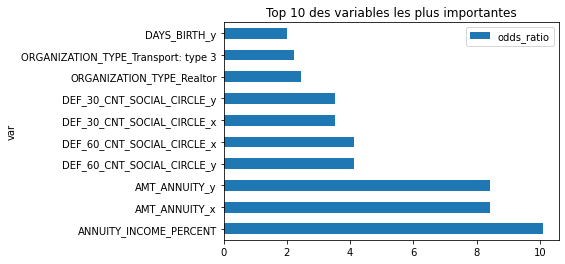

In [ ]:
results = results.sort_values(by = ["odds_ratio"], ascending=False)
ax = results.iloc[:10,].plot.barh(x='var', y='odds_ratio')
plt.title("Top 10 des variables les plus importantes")
plt.show()

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_C, df_nb_fold = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
for param_C in np.logspace(-3, 3, 7): 
  df_C.append(param_C)
  log_reg = model(LogisticRegression(C=param_C, class_weight='balanced', random_state=42), X, y, smote=False)

  df_f1_val_score.append(log_reg["f1_val_score"])
  f1_val_score_mean.append(np.mean(df_f1_val_score))

  df_f1_train_score.append(log_reg["f1_train_score"]) 
  f1_train_score_mean.append(np.mean(df_f1_train_score))

  df_f2_val_score.append(log_reg["f2_val_score"])
  f2_val_score_mean.append(np.mean(df_f2_val_score))

  df_f2_train_score.append(log_reg["f2_train_score"])
  f2_train_score_mean.append(np.mean(df_f2_train_score))

  df_nb_fold.append(log_reg["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'C': df_C}

df_log_reg = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold', 'C'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2512, Val=0.2534, Fbeta-score: Train=0.4060, Val=0.4097
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2527, Val=0.2508, Fbeta-score: Train=0.4078, Val=0.4048
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2538, Val=0.2474, Fbeta-score: Train=0.4094, Val=0.3999
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2511, Val=0.2565, Fbeta-score: Train=0.4061, Val=0.4113
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2530, Val=0.2495, Fbeta-score: Train=0.4082, Val=0.4053
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2554, Val=0.2587, Fbeta-score: Train=0.4088, Val=0.4144
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2576, Val=0.2531, Fbeta-score: Train=0.4116, Val=0.4043
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2581, Val=0.2523, Fbeta-score: Train=0.4124, Val=0.4041
>Train: 0=226294

In [ ]:
df_log_reg

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,C
0,"[0.2534447376136031, 0.2508477075040543, 0.247...",0.251548,"[0.2511702186243736, 0.25270418560902963, 0.25...",0.252358,"[0.40597796094208966, 0.40775635798758464, 0.4...",0.407479,"[0.4097350585335798, 0.40480098969857015, 0.39...",0.406200,"[1, 2, 3, 4, 5]",0.001
1,"[0.2587394167450611, 0.2531088868668486, 0.252...",0.253479,"[0.2554456566876817, 0.25759069026951215, 0.25...",0.254650,"[0.40880009183124805, 0.4116040170080801, 0.41...",0.409176,"[0.4143666385440521, 0.40434140078009545, 0.40...",0.407368,"[1, 2, 3, 4, 5]",0.010
2,"[0.2599772813328285, 0.25737491379970884, 0.25...",0.254761,"[0.25761822863712813, 0.2593113477416454, 0.26...",0.256131,"[0.41127143429244084, 0.4129265007891673, 0.41...",0.410443,"[0.4154162633107453, 0.40960417530424603, 0.40...",0.408299,"[1, 2, 3, 4, 5]",0.100
3,"[0.2616268015362969, 0.25817396668723014, 0.25...",0.255439,"[0.25849339535239113, 0.2600190426728988, 0.25...",0.256864,"[0.41189792042078605, 0.4132655868811564, 0.41...",0.411116,"[0.41740480986240197, 0.40992237431740824, 0.4...",0.408849,"[1, 2, 3, 4, 5]",1.000
4,"[0.26206215333181365, 0.2576564835754533, 0.25...",0.255923,"[0.2581223819928819, 0.25965698097316336, 0.25...",0.257334,"[0.4114547843862553, 0.4134208633532044, 0.413...",0.411536,"[0.41824311214590615, 0.40997804342522565, 0.4...",0.409280,"[1, 2, 3, 4, 5]",10.000
5,"[0.26123872337199605, 0.25752688172043015, 0.2...",0.256264,"[0.2583442112183549, 0.2599645066909684, 0.259...",0.257690,"[0.41202178485028995, 0.41356619195575606, 0.4...",0.411823,"[0.41727211082049787, 0.4094917075791994, 0.40...",0.409551,"[1, 2, 3, 4, 5]",100.000
6,"[0.26116655914386555, 0.25741053601597297, 0.2...",0.256469,"[0.25774041027987493, 0.259700176366843, 0.259...",0.257916,"[0.4109893049754057, 0.4132652438652365, 0.413...",0.412006,"[0.41697971450037563, 0.4093295884723409, 0.40...",0.409697,"[1, 2, 3, 4, 5]",1000.000


In [ ]:
#Score en fonction des hyperparamètres

# Afficher les performances correspondantes
print("Résultats de la validation croisée :")
for f1_mean, f2_mean, params in zip(
        df_log_reg['f1_val_score_mean'], # F1-score moyen
        df_log_reg['f2_val_score_mean'], # F2-score moyen
        df_log_reg['C'],
                    ):

    print("f1-score = {:.4f} et f2-score={:.4f}  for {}".format(
        f1_mean,
        f2_mean,
        params
    ) )

Résultats de la validation croisée :
f1-score = 0.2515 et f2-score=0.4062  for 0.001
f1-score = 0.2535 et f2-score=0.4074  for 0.01
f1-score = 0.2548 et f2-score=0.4083  for 0.1
f1-score = 0.2554 et f2-score=0.4088  for 1.0
f1-score = 0.2559 et f2-score=0.4093  for 10.0
f1-score = 0.2563 et f2-score=0.4096  for 100.0
f1-score = 0.2565 et f2-score=0.4097  for 1000.0


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', LogisticRegression(C=1000, class_weight='balanced', random_state=42)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2586, Val=0.2563, Fbeta-score: Train=0.4125, Val=0.4101


In [ ]:
df_model.loc[11,:]={'subsample': None, 'max_depth':None, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':False, 'F1':0.2586, 'F2':0.4101, 'model': 'LogisticRegression', 'C': 1000, 'Feature engineering': True}

In [ ]:
results = pd.DataFrame({"var":app_train_FE.drop(columns = ['TARGET']).columns,"coef": pipeline.named_steps['classifier'].coef_[0], "odds_ratio": np.exp(pipeline.named_steps['classifier'].coef_[0])})
results.head()

,var,coef,odds_ratio
0,SK_ID_CURR,-0.030506,0.969954
1,NAME_CONTRACT_TYPE_x,-0.105818,0.899588
2,FLAG_OWN_CAR_x,-0.137519,0.871517
3,FLAG_OWN_REALTY_x,0.017776,1.017935
4,CNT_CHILDREN_x,0.056730,1.058370


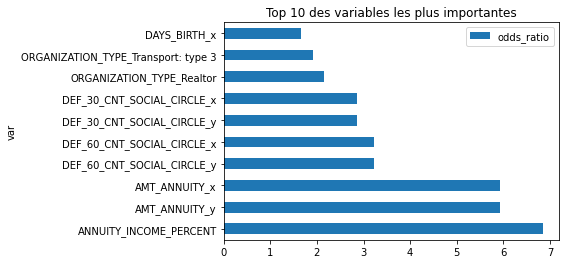

In [ ]:
results = results.sort_values(by = ["odds_ratio"], ascending=False)
ax = results.iloc[:10,].plot.barh(x='var', y='odds_ratio')
plt.title("Top 10 des variables les plus importantes")
plt.show()

### RandomForestClassifier

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold, df_max_depth = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
# Hyper-paramètres 
tuned_parameters = { 'max_depth': [None, 2, 5, 10], 'min_samples_split': [ 2, 3], 'n_estimators':[100, 500, 1000]}
for max_d in tuned_parameters["max_depth"]: 
  df_max_depth.append(max_d)
  #for min_samples in tuned_parameters["min_samples_split"]:
    #df_min_samples_split.append(min_samples)

  RF_smote = model(RandomForestClassifier(n_estimators=100, max_depth=max_d), X, y, smote=True)

  df_f1_val_score.append(RF_smote["f1_val_score"])
  f1_val_score_mean.append(np.mean(RF_smote["f1_val_score"]))

  df_f1_train_score.append(RF_smote["f1_train_score"])
  f1_train_score_mean.append(np.mean(RF_smote["f1_train_score"]))

  df_f2_val_score.append(RF_smote["f2_val_score"])
  f2_val_score_mean.append(np.mean(RF_smote["f2_val_score"]))

  df_f2_train_score.append(RF_smote["f2_train_score"])
  f2_train_score_mean.append(np.mean(RF_smote["f2_train_score"]))

  df_nb_fold.append(RF_smote["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'max_depth': df_max_depth}

df_RF_smote = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold','max_depth'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.9999, Val=0.0111, Fbeta-score: Train=0.9998, Val=0.0070
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.9999, Val=0.0151, Fbeta-score: Train=0.9999, Val=0.0095
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.9999, Val=0.0073, Fbeta-score: Train=0.9998, Val=0.0046
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.9998, Val=0.0131, Fbeta-score: Train=0.9997, Val=0.0083
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.9999, Val=0.0102, Fbeta-score: Train=0.9998, Val=0.0064
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2380, Val=0.2442, Fbeta-score: Train=0.3601, Val=0.3708
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2384, Val=0.2366, Fbeta-score: Train=0.3521, Val=0.3498
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2402, Val=0.2313, Fbeta-score: Train=0.3575, Val=0.3447
>Train: 0=226294

In [ ]:
df_RF_smote

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,max_depth
0,"[0.011148715906828588, 0.01513341298287535, 0....",0.011371,"[0.9998992595577495, 0.9999496399254671, 0.999...",0.999884,"[0.9998388250345016, 0.9999194263153655, 0.999...",0.999814,"[0.0070235288215522, 0.009536716357978215, 0.0...",0.007165,"[1, 2, 3, 4, 5]",NaN
1,"[0.2442218464073544, 0.2365760919966614, 0.231...",0.238252,"[0.23802428014199942, 0.23844927687993767, 0.2...",0.238796,"[0.36006709407092613, 0.3520797685557411, 0.35...",0.358394,"[0.37080930183561134, 0.3497682836537143, 0.34...",0.357790,"[1, 2, 3, 4, 5]",2.0
2,"[0.22907164925702517, 0.22993838347227255, 0.2...",0.226834,"[0.2265401079471431, 0.23403405583995934, 0.23...",0.229530,"[0.2685908469040999, 0.28109192394906685, 0.28...",0.274591,"[0.2731195621667134, 0.2763451352104823, 0.269...",0.271307,"[1, 2, 3, 4, 5]",5.0
3,"[0.11134903640256959, 0.12287503728004771, 0.1...",0.122357,"[0.1180496808428824, 0.13175775480059088, 0.13...",0.129287,"[0.08969160112654986, 0.10293812172548296, 0.1...",0.100652,"[0.08485639686684074, 0.09533947331883184, 0.0...",0.095258,"[1, 2, 3, 4, 5]",10.0


In [ ]:
pipeline_smote = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['smote', SMOTE(random_state=11)],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', RandomForestClassifier(n_estimators=1000, max_depth=2)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline_smote.fit(X_train, y_train)

y_pred = pipeline_smote.predict(X_val)
y_pred_train = pipeline_smote.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2383, Val=0.2368, Fbeta-score: Train=0.3595, Val=0.3580


In [ ]:
df_model.loc[12,:]={'subsample': None, 'max_depth':2, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':True, 'F1':0.2368, 'F2':0.3580, 'model': 'RandomForestClassifier', 'C': None, 'Feature engineering': True}

In [ ]:
feature_imp = pd.Series(pipeline_smote.named_steps['classifier'].feature_importances_,index=app_train_FE.drop(columns = ['TARGET']).columns).sort_values(ascending=False)
feature_imp.head()

CODE_GENDER_M                             0.045667
EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3    0.040965
EXT_SOURCE_2 EXT_SOURCE_3                 0.039099
EXT_SOURCE_1 EXT_SOURCE_3                 0.038304
EXT_SOURCE_3_y                            0.036807
dtype: float64

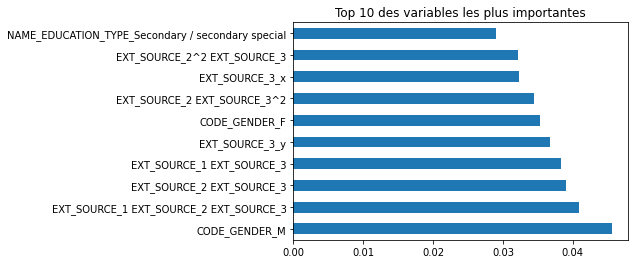

In [ ]:
ax = feature_imp.iloc[:10,].plot.barh(x=feature_imp.index, y=feature_imp[1])
plt.title("Top 10 des variables les plus importantes")
plt.show()

In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold, df_max_depth = [], [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}
# Hyper-paramètres 
tuned_parameters = { 'max_depth': [None, 2, 5, 10], 'min_samples_split': [ 2, 3], 'n_estimators':[100, 500, 1000]}
for max_d in tuned_parameters["max_depth"]: 
  df_max_depth.append(max_d)
  #for min_samples in tuned_parameters["min_samples_split"]:
    #df_min_samples_split.append(min_samples)

  RF_balanced = model(RandomForestClassifier(n_estimators=100, max_depth=max_d, class_weight='balanced'), X, y, smote=False)

  df_f1_val_score.append(RF_balanced["f1_val_score"])
  f1_val_score_mean.append(np.mean(RF_balanced["f1_val_score"]))

  df_f1_train_score.append(RF_balanced["f1_train_score"])
  f1_train_score_mean.append(np.mean(RF_balanced["f1_train_score"]))

  df_f2_val_score.append(RF_balanced["f2_val_score"])
  f2_val_score_mean.append(np.mean(RF_balanced["f2_val_score"]))

  df_f2_train_score.append(RF_balanced["f2_train_score"])
  f2_train_score_mean.append(np.mean(RF_balanced["f2_train_score"]))

  df_nb_fold.append(RF_balanced["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold, 'max_depth': df_max_depth}

df_RF_balanced = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold','max_depth'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.9998, Val=0.0258, Fbeta-score: Train=0.9997, Val=0.0165
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.9996, Val=0.0256, Fbeta-score: Train=0.9994, Val=0.0163
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.9997, Val=0.0269, Fbeta-score: Train=0.9995, Val=0.0172
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.9997, Val=0.0296, Fbeta-score: Train=0.9996, Val=0.0189
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.9996, Val=0.0329, Fbeta-score: Train=0.9994, Val=0.0211
>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2362, Val=0.2385, Fbeta-score: Train=0.3874, Val=0.3921
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2393, Val=0.2377, Fbeta-score: Train=0.3886, Val=0.3861
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2406, Val=0.2343, Fbeta-score: Train=0.3930, Val=0.3838
>Train: 0=226294

In [ ]:
df_RF_balanced

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold,max_depth
0,"[0.025826648405400117, 0.025550314465408803, 0...",0.028151,"[0.9998236909049694, 0.999647372928316, 0.9996...",0.999698,"[0.9997179352862957, 0.999435916032072, 0.9994...",0.999517,"[0.01648269317216922, 0.01625894241833008, 0.0...",0.017995,"[1, 2, 3, 4, 5]",NaN
1,"[0.23852441836093063, 0.23768535262206153, 0.2...",0.237706,"[0.23619677785501228, 0.23927724367678743, 0.2...",0.239056,"[0.38743534084611114, 0.38861444366031517, 0.3...",0.389669,"[0.3920893054024256, 0.38612488543159973, 0.38...",0.387465,"[1, 2, 3, 4, 5]",2.0
2,"[0.24966989851737276, 0.2495618647038205, 0.24...",0.248103,"[0.24867664636575787, 0.2523091928797854, 0.25...",0.250340,"[0.3972323750295492, 0.39895372580953614, 0.40...",0.399208,"[0.3994736460873554, 0.39479520922667455, 0.38...",0.395554,"[1, 2, 3, 4, 5]",5.0
3,"[0.2699088145896657, 0.26531418785403765, 0.26...",0.265744,"[0.2975725720267824, 0.30043813895263927, 0.30...",0.299475,"[0.45099063245783944, 0.4540596517548343, 0.45...",0.453812,"[0.4095940959409594, 0.4009396400700749, 0.396...",0.402468,"[1, 2, 3, 4, 5]",10.0


In [ ]:
#Score en fonction des hyperparamètres

# Afficher les performances correspondantes
print("Résultats de la validation croisée :")
for f1_mean, f2_mean, params in zip(
        df_RF_balanced['f1_val_score_mean'], # F1-score moyen
        df_RF_balanced['f2_val_score_mean'], # F2-score moyen
        df_RF_balanced['max_depth'],
                    ):

    print("f1-score = {:.4f} et f2-score={:.4f}  for max_depth={}".format(
        f1_mean,
        f2_mean,
        params
    ) )

Résultats de la validation croisée :
f1-score = 0.0282 et f2-score=0.0180  for max_depth=nan
f1-score = 0.2377 et f2-score=0.3875  for max_depth=2.0
f1-score = 0.2481 et f2-score=0.3956  for max_depth=5.0
f1-score = 0.2657 et f2-score=0.4025  for max_depth=10.0


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', RandomForestClassifier(n_estimators=1000, max_depth=5, class_weight='balanced')]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2501, Val=0.2465, Fbeta-score: Train=0.3989, Val=0.3943


In [ ]:
df_model.loc[13,:]={'subsample': None, 'max_depth':5, 'num_leaves': None, 'min_child_samples': None, 'min_child_weight': None, 'reg_lambda': None, 'smote':False, 'F1':0.2465, 'F2':0.3943, 'model': 'RandomForestClassifier', 'C': None, 'Feature engineering': True}

In [ ]:
results = pd.DataFrame({"var":app_train_FE.drop(columns = ['TARGET']).columns,"features_importance": pipeline.named_steps['classifier'].feature_importances_})
results.head()


,var,features_importance
0,SK_ID_CURR,0.000041
1,NAME_CONTRACT_TYPE_x,0.000587
2,FLAG_OWN_CAR_x,0.000105
3,FLAG_OWN_REALTY_x,0.000002
4,CNT_CHILDREN_x,0.000010


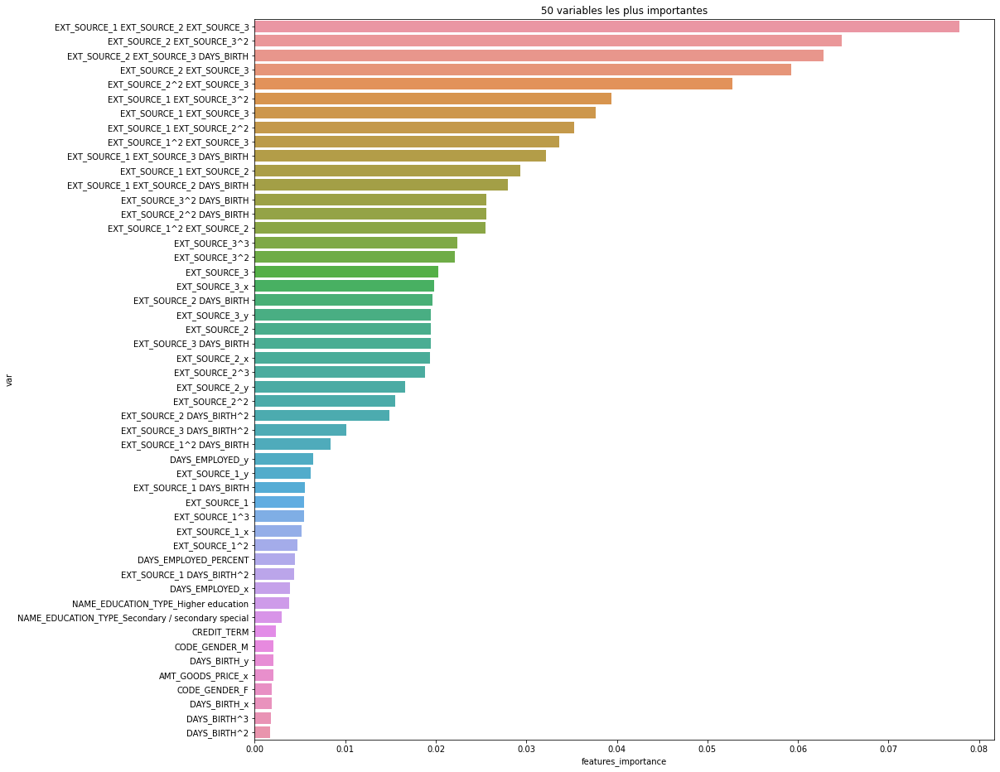

In [ ]:
plt.figure(figsize=(16, 16))
sns.barplot(data=results.sort_values(by='features_importance', ascending=False).head(50), x='features_importance', y='var');
plt.title('50 variables les plus importantes');

### LightGBM


In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))]])
    X_train = pipeline.fit_transform(X_train)
    X_val = pipeline.transform(X_val)

    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f2_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-10-06 11:15:18,757] A new study created in memory with name: no-name-f5186b53-b9d2-43a9-8699-758e8d6715f4
[I 2021-10-06 11:16:31,863] Trial 0 finished with value: 0.42808219178082185 and parameters: {'subsample': 0.4, 'max_depth': 20, 'num_leaves': 35, 'min_child_samples': 105, 'min_child_weight': 1, 'reg_lambda': 0.021705408789401276}. Best is trial 0 with value: 0.42808219178082185.
[I 2021-10-06 11:18:37,739] Trial 1 finished with value: 0.4004889044096637 and parameters: {'subsample': 0.5, 'max_depth': 20, 'num_leaves': 654, 'min_child_samples': 245, 'min_child_weight': 1, 'reg_lambda': 9.58929105171334}. Best is trial 0 with value: 0.42808219178082185.
[I 2021-10-06 11:20:30,886] Trial 2 finished with value: 0.4068793224263473 and parameters: {'subsample': 0.6, 'max_depth': 100, 'num_leaves': 274, 'min_child_samples': 91, 'min_child_weight': 1, 'reg_lambda': 0.03578659628858785}. Best is trial 0 with value: 0.42808219178082185.
[I 2021-10-06 11:21:32,917] Trial 3 finished 

In [ ]:
df_model.loc[14,:]={'subsample': 0.8, 'max_depth': 100, 'num_leaves': 28, 'min_child_samples': 75, 'min_child_weight': 1, 'reg_lambda': 5.675828416435622, 'smote':False, 'F1':None, 'F2':0.4292395896197948, 'model': 'LGBM', 'Feature engineering': True}

In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))]])
    X_train = pipeline.fit_transform(X_train)
    X_val = pipeline.transform(X_val)

    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f1_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-10-06 13:55:39,121] A new study created in memory with name: no-name-5f580376-d96b-4ff8-8331-0aeeb4659e59
[I 2021-10-06 13:58:15,713] Trial 0 finished with value: 0.2979947147520597 and parameters: {'subsample': 0.7, 'max_depth': 20, 'num_leaves': 605, 'min_child_samples': 25, 'min_child_weight': 1, 'reg_lambda': 0.009061398763895808}. Best is trial 0 with value: 0.2979947147520597.
[I 2021-10-06 14:00:37,682] Trial 1 finished with value: 0.29812046399106756 and parameters: {'subsample': 0.7, 'max_depth': 100, 'num_leaves': 413, 'min_child_samples': 209, 'min_child_weight': 1, 'reg_lambda': 0.20215466037843394}. Best is trial 1 with value: 0.29812046399106756.
[I 2021-10-06 14:02:20,422] Trial 2 finished with value: 0.2848225149447178 and parameters: {'subsample': 0.8, 'max_depth': 10, 'num_leaves': 298, 'min_child_samples': 5, 'min_child_weight': 1, 'reg_lambda': 0.13285548419711637}. Best is trial 1 with value: 0.29812046399106756.
[I 2021-10-06 14:04:09,487] Trial 3 finished

KeyboardInterrupt: ignored

In [ ]:
df_model.loc[15,:]={'subsample': 0.5, 'max_depth': 100, 'num_leaves': 976, 'min_child_samples': 299, 'min_child_weight': 1, 'reg_lambda': 9.055919048563737, 'smote':False, 'F1':0.30733019502353737, 'F2':None, 'model': 'LGBM', 'Feature engineering': True}

In [ ]:
def objective(trial):

    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                          ['scaler', MinMaxScaler(feature_range = (0, 1))]])
    
    X_train = pipeline.fit_transform(X_train)
    X_val = pipeline.transform(X_val)

    pipeline_smote = imbpipeline(steps = [['smote', SMOTE(random_state=11)]])
                                        
    X_train, y_train = pipeline_smote.fit_resample(X_train, y_train)

    
    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f1_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-10-06 17:20:01,731] A new study created in memory with name: no-name-3f41080f-0055-4715-9f1b-8137f9ea17e7
[I 2021-10-06 17:28:01,043] Trial 0 finished with value: 0.02842679127725857 and parameters: {'subsample': 0.5, 'max_depth': 5, 'num_leaves': 311, 'min_child_samples': 76, 'min_child_weight': 0, 'reg_lambda': 0.02736351940387369}. Best is trial 0 with value: 0.02842679127725857.
[I 2021-10-06 17:35:57,379] Trial 1 finished with value: 0.026510721247563353 and parameters: {'subsample': 0.6, 'max_depth': 5, 'num_leaves': 662, 'min_child_samples': 83, 'min_child_weight': 1, 'reg_lambda': 0.0010404710637317207}. Best is trial 0 with value: 0.02842679127725857.
[I 2021-10-06 17:46:40,287] Trial 2 finished with value: 0.06615297876339032 and parameters: {'subsample': 0.6, 'max_depth': 20, 'num_leaves': 415, 'min_child_samples': 85, 'min_child_weight': 0, 'reg_lambda': 0.01281009334307666}. Best is trial 2 with value: 0.06615297876339032.
[I 2021-10-06 17:58:07,868] Trial 3 finish

Trial 60 finished with value: 0.22558091712934406 and parameters: {'subsample': 0.7, 'max_depth': 10, 'num_leaves': 202, 'min_child_samples': 33, 'min_child_weight': 0, 'reg_lambda': 0.04139581762557417}. Best is trial 60 with value: 0.22558091712934406.

In [ ]:
df_model.loc[16,:]={'subsample': 1.0, 'max_depth': 100, 'num_leaves': 610, 'min_child_samples': 125, 'min_child_weight': 1, 'reg_lambda': 0.16216043884348086, 'smote':True, 'F1':0.07185628742514968, 'F2':None, 'model': 'LGBM', 'Feature engineering': True}

In [ ]:
def objective(trial):

 
    X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                          ['scaler', MinMaxScaler(feature_range = (0, 1))]])
    
    X_train = pipeline.fit_transform(X_train)
    X_val = pipeline.transform(X_val)

    pipeline_smote = imbpipeline(steps = [['smote', SMOTE(random_state=11)]])
                                        
    X_train, y_train = pipeline_smote.fit(X_train, y_train)

    
    param = {
        'objective': 'binary',
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': 0.1,
        'max_depth': trial.suggest_categorical('max_depth', [5,10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 1000), # 2**max_depth -1
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'is_unbalance': True,
        'min_split_gain': 0.1,
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0)
        #'scale_pos_weight': 99 #jeu d'entraînement très contre-balancé
    }
 
    model = lgb.LGBMClassifier(**param)  
    
    model.fit(X_train,y_train,verbose=True)
    
    y_pred = model.predict(X_val)
    y_pred_train = model.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)
    
    return f2_score_val

In [ ]:
study = optuna.create_study(direction='maximize')
study.optimize(objective)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2021-10-07 18:41:27,801] A new study created in memory with name: no-name-5ceb8fe4-d551-4ad9-8b69-529f9160f5c3
[I 2021-10-07 18:52:16,676] Trial 0 finished with value: 0.043646463644479716 and parameters: {'subsample': 0.5, 'max_depth': 100, 'num_leaves': 386, 'min_child_samples': 195, 'min_child_weight': 1, 'reg_lambda': 0.02776641726382667}. Best is trial 0 with value: 0.043646463644479716.
[I 2021-10-07 19:03:01,510] Trial 1 finished with value: 0.0429131319144714 and parameters: {'subsample': 0.5, 'max_depth': 20, 'num_leaves': 940, 'min_child_samples': 285, 'min_child_weight': 0, 'reg_lambda': 0.012885194428758611}. Best is trial 0 with value: 0.043646463644479716.
[I 2021-10-07 19:12:25,783] Trial 2 finished with value: 0.027469783238437722 and parameters: {'subsample': 0.4, 'max_depth': 10, 'num_leaves': 961, 'min_child_samples': 202, 'min_child_weight': 1, 'reg_lambda': 0.01565844693399995}. Best is trial 0 with value: 0.043646463644479716.
[I 2021-10-07 19:22:22,513] Trial 

In [ ]:
print('Best trial:', study.best_trial.params)

Best trial: {'subsample': 0.4, 'max_depth': 100, 'num_leaves': 304, 'min_child_samples': 2, 'min_child_weight': 0, 'reg_lambda': 0.0018533665591059015}


In [ ]:
df_model.loc[17,:]={'subsample': 0.8, 'max_depth': 20, 'num_leaves': 810, 'min_child_samples': 113, 'min_child_weight': 0, 'reg_lambda': 0.015552737806700884, 'smote':True, 'F1':None, 'F2':0.04680998613037447, 'model': 'LGBM', 'Feature engineering': True}

In [ ]:
df_model

,subsample,max_depth,num_leaves,min_child_samples,min_child_weight,reg_lambda,smote,F1,F2,model,C,Feature engineering
0,None,None,None,None,None,None,True,0.2581,0.4078,LogisticRegression,1000,False
1,None,None,None,None,None,None,False,0.2569,0.4082,LogisticRegression,1000,False
2,None,5,None,None,None,None,True,0.1699,0.1552,RandomForestClassifier,None,False
3,None,10,None,None,None,None,False,0.257,0.3929,RandomForestClassifier,None,False
4,0.7,100,595,269,1,0.491848,False,0.301,None,LGBM,None,False
5,0.4,10,37,145,0,0.386749,False,0.2669,0.42386,LGBM,None,False
6,0.7,10,202,33,0,0.0413958,True,0.225581,None,LGBM,None,False
7,0.4,100,304,2,0,0.00185337,True,None,0.321163,LGBM,None,False
8,1,2,3,20,0.001,0,False,0.2678,0.4206,LGBM,None,False
9,1,10,1023,20,0.001,0,False,0.021506,0.013774,LGBM,None,False


In [ ]:

def load_model(model, X, y, smote=True):

  f1_val_score = []
  f1_train_score = []

  f2_val_score = []
  f2_train_score = []
  nb_fold = []
  fold = 1

  # Etape 1 : prepare cross validation
  kfold = model_selection.KFold(n_splits = 5, shuffle = True, random_state = 1)
  # enumerate splits
  for train_ix, val_ix in kfold.split(X):

    # select rows : split into train and validation set 
    X_train, X_val = X.iloc[train_ix], X.iloc[val_ix]
    y_train, y_val = y[train_ix], y[val_ix]

    # summarize
    train_0, train_1 = len(y_train[y_train==0]), len(y_train[y_train==1])
    val_0, val_1 = len(y_val[y_val==0]), len(y_val[y_val==1])

    print('>Train: 0=%d, 1=%d, Val: 0=%d, 1=%d' % (train_0, train_1, val_0, val_1))
    
    #pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        #['scaler', MinMaxScaler(feature_range = (0, 1))]])
    
    #X_train = pipeline.fit_transform(X_train)
    #X_val = pipeline.transform(X_val)

    if smote == True:
        pipeline = imbpipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['smote', SMOTE(random_state=11)],
                                        ['classifier', model]])
    else:
        
        pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                     ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                     ['classifier', model]])
    
    
    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_val)
    y_pred_train = pipeline.predict(X_train)

    #On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
    f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
    f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

    f1_score_train = metrics.f1_score(y_train,y_pred_train)
    f1_score_val = metrics.f1_score(y_val,y_pred)

    print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

    f1_val_score.append(f1_score_val)
    f1_train_score.append(f1_score_train)

    f2_val_score.append(f2_score_val)
    f2_train_score.append(f2_score_train)

    nb_fold.append(fold)

    fold = fold +1

  return {'f1_val_score':f1_val_score, 'f1_train_score': f1_train_score, 'f2_val_score':f2_val_score, 'f2_train_score': f2_train_score, 'fold': nb_fold}


In [ ]:
df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold= [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}

LGBM_balanced = load_model(lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=28, min_child_samples=75, min_child_weight=1, reg_lambda=5.67583), X, y, smote=False)

df_f1_val_score.append(LGBM_balanced["f1_val_score"])
f1_val_score_mean.append(np.mean(LGBM_balanced["f1_val_score"]))

df_f1_train_score.append(LGBM_balanced["f1_train_score"])
f1_train_score_mean.append(np.mean(LGBM_balanced["f1_train_score"]))

df_f2_val_score.append(LGBM_balanced["f2_val_score"])
f2_val_score_mean.append(np.mean(LGBM_balanced["f2_val_score"]))

df_f2_train_score.append(LGBM_balanced["f2_train_score"])
f2_train_score_mean.append(np.mean(LGBM_balanced["f2_train_score"]))

df_nb_fold.append(LGBM_balanced["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold}

df_LGBM = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.2921, Val=0.2774, Fbeta-score: Train=0.4570, Val=0.4346
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.2937, Val=0.2715, Fbeta-score: Train=0.4591, Val=0.4236
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.2927, Val=0.2695, Fbeta-score: Train=0.4584, Val=0.4228
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.2907, Val=0.2797, Fbeta-score: Train=0.4556, Val=0.4337
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.2930, Val=0.2698, Fbeta-score: Train=0.4580, Val=0.4249


In [ ]:
df_LGBM

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold
0,"[0.2774247692123247, 0.27148918973530006, 0.26...",0.273598,"[0.29206062430994684, 0.2937440233529619, 0.29...",0.292453,"[0.4569553063852508, 0.4590703440117293, 0.458...",0.457596,"[0.4346029599579295, 0.42362407304646116, 0.42...",0.427928,"[1, 2, 3, 4, 5]"


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=28, min_child_samples=75, min_child_weight=1, reg_lambda=5.67583)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.2930, Val=0.2733, Fbeta-score: Train=0.4580, Val=0.4283


In [ ]:
df_model.loc[14,"F1"]=0.2733

In [ ]:

df_f1_val_score, df_f1_train_score, df_f2_val_score, df_f2_train_score, df_nb_fold= [], [], [], [], []
f1_val_score_mean, f1_train_score_mean, f2_val_score_mean, f2_train_score_mean = [], [], [], []
scores = {}

LGBM_balanced = load_model(lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=976, min_child_samples=299, min_child_weight=1, reg_lambda=9.05592), X, y, smote=False)

df_f1_val_score.append(LGBM_balanced["f1_val_score"])
f1_val_score_mean.append(np.mean(LGBM_balanced["f1_val_score"]))

df_f1_train_score.append(LGBM_balanced["f1_train_score"])
f1_train_score_mean.append(np.mean(LGBM_balanced["f1_train_score"]))

df_f2_val_score.append(LGBM_balanced["f2_val_score"])
f2_val_score_mean.append(np.mean(LGBM_balanced["f2_val_score"]))

df_f2_train_score.append(LGBM_balanced["f2_train_score"])
f2_train_score_mean.append(np.mean(LGBM_balanced["f2_train_score"]))

df_nb_fold.append(LGBM_balanced["fold"])

scores = {'f1_val_score': df_f1_val_score, 'f1_val_score_mean': f1_val_score_mean, 'f1_train_score': df_f1_train_score, 'f1_train_score_mean':f1_train_score_mean,
          'f2_val_score': df_f2_val_score, 'f2_val_score_mean': f2_val_score_mean, 'f2_train_score': df_f2_train_score, 'f2_train_score_mean': f2_train_score_mean,
          'fold': df_nb_fold}

df_LGBM = pd.DataFrame(scores, columns = ['f1_val_score','f1_val_score_mean','f1_train_score','f1_train_score_mean','f2_train_score','f2_train_score_mean',
                                                   'f2_val_score','f2_val_score_mean','fold'])


>Train: 0=226153, 1=19855, Val: 0=56533, 1=4970
>F1-score: Train=0.6388, Val=0.3085, Fbeta-score: Train=0.8155, Val=0.3842
>Train: 0=226151, 1=19858, Val: 0=56535, 1=4967
>F1-score: Train=0.6371, Val=0.2980, Fbeta-score: Train=0.8144, Val=0.3701
>Train: 0=226098, 1=19911, Val: 0=56588, 1=4914
>F1-score: Train=0.6380, Val=0.3057, Fbeta-score: Train=0.8150, Val=0.3805
>Train: 0=226294, 1=19715, Val: 0=56392, 1=5110
>F1-score: Train=0.6401, Val=0.3106, Fbeta-score: Train=0.8164, Val=0.3828
>Train: 0=226048, 1=19961, Val: 0=56638, 1=4864
>F1-score: Train=0.6388, Val=0.2999, Fbeta-score: Train=0.8155, Val=0.3769


In [ ]:
df_LGBM

,f1_val_score,f1_val_score_mean,f1_train_score,f1_train_score_mean,f2_train_score,f2_train_score_mean,f2_val_score,f2_val_score_mean,fold
0,"[0.2998016822813376, 0.2894736842105263, 0.296...",0.29441,"[0.6490135504012815, 0.6490797947108627, 0.649...",0.649473,"[0.8221112436228716, 0.822153764616251, 0.8222...",0.82241,"[0.3711102834117767, 0.3542430367604235, 0.364...",0.362647,"[1, 2, 3, 4, 5]"


In [ ]:
pipeline = Pipeline(steps = [['imputer', SimpleImputer(strategy = 'median')],
                                        ['scaler', MinMaxScaler(feature_range = (0, 1))],
                                        ['classifier', lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=976, min_child_samples=299, min_child_weight=1, reg_lambda=9.05592)]])

X_train, X_val, y_train, y_val = model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_val)
y_pred_train = pipeline.predict(X_train)

#On chosit de prendre F2-score, car les faux négatifs coûtent plus cher à la banque
f2_score_train = metrics.fbeta_score(y_train, y_pred_train, beta=2) #More weight on recall, less weight on precision.
f2_score_val = metrics.fbeta_score(y_val, y_pred, beta=2)

f1_score_train = metrics.f1_score(y_train,y_pred_train)
f1_score_val = metrics.f1_score(y_val,y_pred)

In [ ]:
print('>F1-score: Train=%.4f, Val=%.4f, Fbeta-score: Train=%.4f, Val=%.4f' % (f1_score_train, f1_score_val, f2_score_train, f2_score_val))

>F1-score: Train=0.6379, Val=0.3008, Fbeta-score: Train=0.8150, Val=0.3760


In [ ]:
df_model[15,"F2"]=0.3760
df_model[15,"F1"]=0.3008

In [ ]:
df_model

,subsample,max_depth,num_leaves,min_child_samples,min_child_weight,reg_lambda,smote,F1,F2,model,C,Feature engineering,"(15, F2)","(15, F1)"
0,None,None,None,None,None,None,True,0.2581,0.4078,LogisticRegression,1000,False,0.3759,0.3016
1,None,None,None,None,None,None,False,0.2569,0.4082,LogisticRegression,1000,False,0.3759,0.3016
2,None,5,None,None,None,None,True,0.1699,0.1552,RandomForestClassifier,None,False,0.3759,0.3016
3,None,10,None,None,None,None,False,0.257,0.3929,RandomForestClassifier,None,False,0.3759,0.3016
4,0.7,100,595,269,1,0.491848,False,0.2992,0.3635,LGBM,None,False,0.3759,0.3016
5,0.4,10,37,145,0,0.386749,False,0.2669,0.42386,LGBM,None,False,0.3759,0.3016
6,0.7,10,202,33,0,0.0413958,True,0.225581,None,LGBM,None,False,0.3759,0.3016
7,0.4,100,304,2,0,0.00185337,True,None,0.321163,LGBM,None,False,0.3759,0.3016
8,1,2,3,20,0.001,0,False,0.2678,0.4206,LGBM,None,False,0.3759,0.3016
9,1,10,1023,20,0.001,0,True,0.021506,0.013774,LGBM,None,False,0.3759,0.3016


Le meilleur modèle est le modèle 14 avec LGBM et feature engineering. 
On a donc un score de F1 = 0.2733 et un score F2 = 0.42924

In [ ]:
# Enregistrer notre modèle avec joblib ou pickle

## Avec joblib 

dump(pipeline, '/content/drive/MyDrive/data/mymodel.joblib') 

## Avec pickle
Pkl_Filename = "/content/drive/MyDrive/data/LGBM_Model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(pipeline, file)

## Modèle choisi

In [9]:
filename = r"/content/drive/MyDrive/data/mymodel.joblib"
app_train_FE = pd.read_csv('/content/drive/MyDrive/data/app_train_FE.csv')

#X matrice des var. explicatives
X = app_train_FE.drop('TARGET', axis=1) 

#Y matrice de la variable cible : expliquée
y = app_train_FE['TARGET']
y = y.values.reshape(-1,1)

In [ ]:
X.shape

(307511, 274)

In [10]:
# Median imputation of missing values
imputer = SimpleImputer(strategy = 'median')
# Fit on the training data
imputer.fit(X)
dump(imputer, '/content/drive/MyDrive/data/imputer.joblib')

['/content/drive/MyDrive/data/imputer.joblib']

In [11]:
scaler = MinMaxScaler(feature_range = (0, 1))
scaler.fit(imputer.transform(X))
dump(scaler, '/content/drive/MyDrive/data/scaler.joblib')

['/content/drive/MyDrive/data/scaler.joblib']

In [18]:
model = lgb.LGBMClassifier(objective='binary',n_estimators=100, is_unbalance=True, max_depth=100, num_leaves=976, min_child_samples=299, min_child_weight=1, reg_lambda=9.05592)
model.fit(scaler.transform(imputer.transform(X)),y)
model.booster_.save_model("/content/drive/MyDrive/data/model.bin")

In [ ]:
if os.path.isfile(filename)==True : 
  my_model = load(filename)
  print(my_model)

Pipeline(memory=None,
         steps=[('imputer',
                 SimpleImputer(add_indicator=False, copy=True, fill_value=None,
                               missing_values=nan, strategy='median',
                               verbose=0)),
                ('scaler', MinMaxScaler(copy=True, feature_range=(0, 1))),
                ['classifier',
                 LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                is_unbalance=True, learning_rate=0.1,
                                max_depth=100, min_child_samples=75,
                                min_child_weight=1, min_split_gain=0.0,
                                n_estimators=100, n_jobs=-1, num_leaves=28,
                                objective='binary', random_state=None,
                                reg_alpha=0.0, reg_lambda=5.67583, silent=True,
                                subsample=1.0, subsample_for

In [ ]:
# Load the Model back from file
with open(Pkl_Filename, 'rb') as file:  
    Pickled_LR_Model = pickle.load(file)

Pickled_LR_Model

Pipeline(memory=None,
         steps=[('imputer',
                 SimpleImputer(add_indicator=False, copy=True, fill_value=None,
                               missing_values=nan, strategy='median',
                               verbose=0)),
                ('scaler', MinMaxScaler(copy=True, feature_range=(0, 1))),
                ['classifier',
                 LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                is_unbalance=True, learning_rate=0.1,
                                max_depth=100, min_child_samples=299,
                                min_child_weight=1, min_split_gain=0.0,
                                n_estimators=100, n_jobs=-1, num_leaves=976,
                                objective='binary', random_state=None,
                                reg_alpha=0.0, reg_lambda=9.05592, silent=True,
                                subsample=1.0, subsample_f

In [ ]:
explainer = shap.TreeExplainer(my_model.named_steps['classifier'])
shap_values = explainer.shap_values(X.iloc[:1000,])

Exception: ignored

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][0,:], X.iloc[0,:])

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][:1000,:], X.iloc[:1000,:])

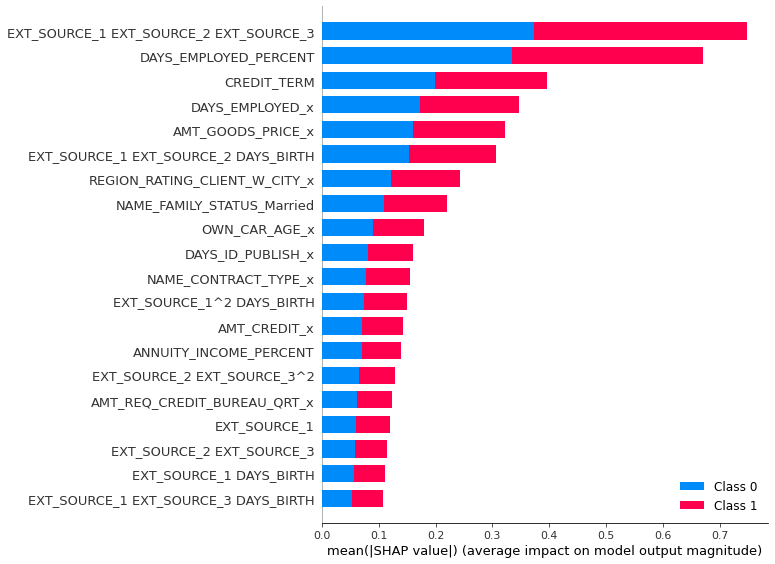

In [ ]:
shap.initjs()
shap.summary_plot(shap_values, X)

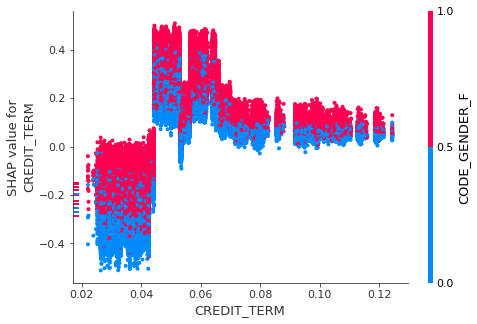

In [ ]:
shap.initjs()
shap.dependence_plot("CREDIT_TERM", shap_values[1], X, display_features=X)

In [ ]:
col_imp = ["DAYS_EMPLOYED_PERCENT", "CREDIT_TERM", "DAYS_EMPLOYED_x", "AMT_GOODS_PRICE_x",
           "NAME_FAMILY_STATUS_Married", "OWN_CAR_AGE_x", "NAME_CONTRACT_TYPE_x","AMT_CREDIT_x",
           "ANNUITY_INCOME_PERCENT"]

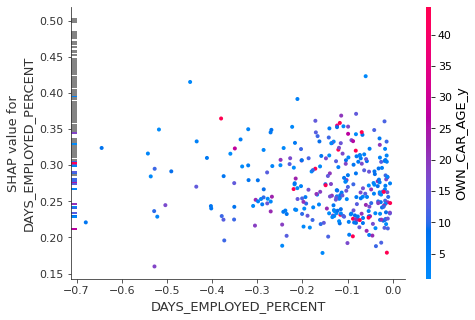

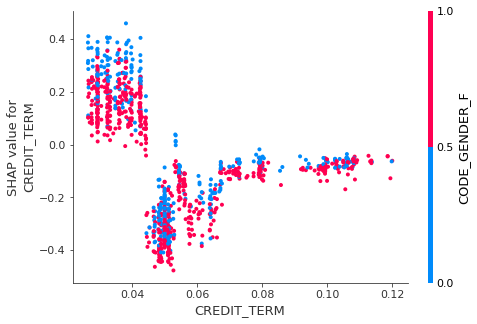

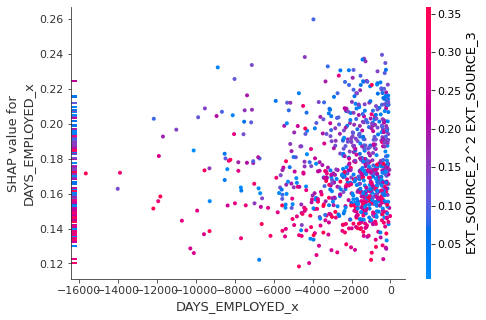

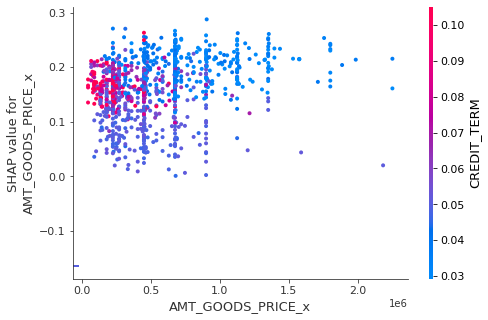

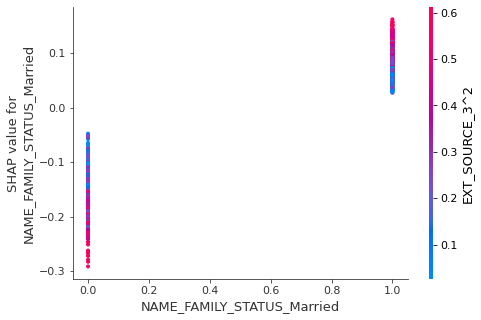

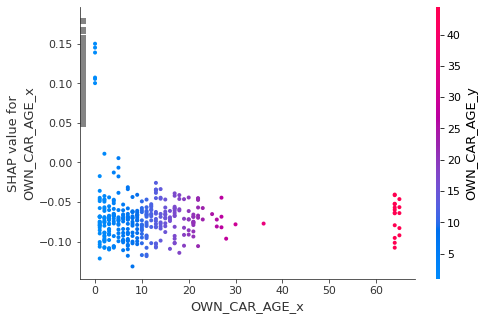

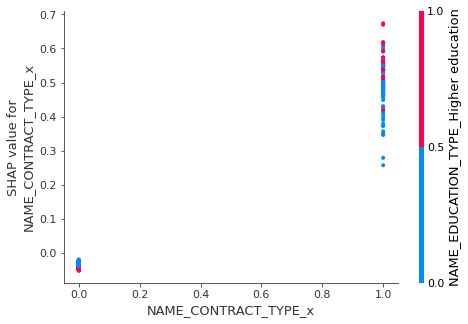

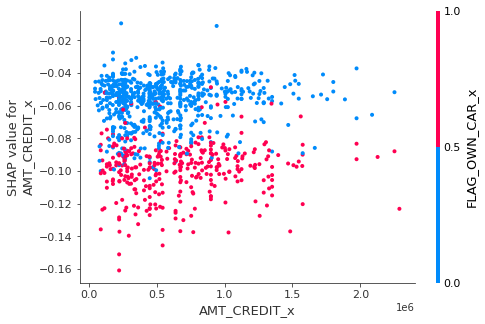

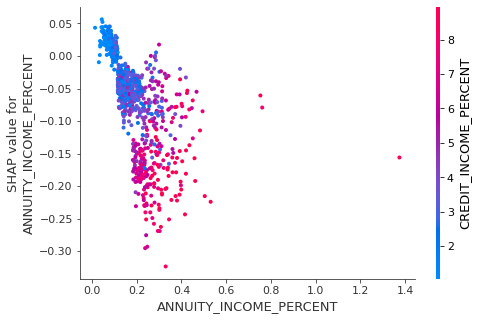

In [ ]:
shap.initjs()
for name in col_imp: 
  shap.dependence_plot(name, shap_values[0], X.iloc[:1000,:])

# Submission dataframe
submit = app_test[['SK_ID_CURR']]
submit['TARGET'] = log_reg_pred

# Save the submission to a csv file
submit.to_csv('log_reg_baseline.csv', index = False)

submit.head()

The predictions represent a probability between 0 and 1 that the loan will not be repaid. If we were using these predictions to classify applicants, we could set a probability threshold for determining that a loan is risky. 

The submission has now been saved to the virtual environment in which our notebook is running. To access the submission, at the end of the notebook, we will hit the blue Commit & Run button at the upper right of the kernel. This runs the entire notebook and then lets us download any files that are created during the run. 

Once we run the notebook, the files created are available in the Versions tab under the Output sub-tab. From here, the submission files can be submitted to the competition or downloaded. Since there are several models in this notebook, there will be multiple output files. 

__The logistic regression baseline should score around 0.671 when submitted.__

### F1 Score
Le F1-Score combine subtilement la précision et le rappel. 
Il est intéressant et plus intéressant que l’accuracy car le nombre de vrais négatifs (tn) n’est pas pris en compte. 
Et dans les situations d’imbalanced class, nous avons une majorité de vrais négatifs qui faussent complètement notre perception de la performance de l’algorithme. 
Un grand nombre de vrais négatifs (tn) laissera le F1-Score de marbre.

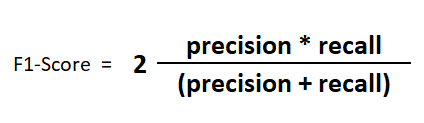

#### Précision

La précision correspond au nombre de documents correctement attribués à la classe i par rapport au nombre total de documents prédits comme appartenant à la classe i (total predicted positive).
Dans notre exemple, il s’agit du nombre de fois où un client n'a vraiment pas remboursé son prêt (c’était vraiment lui) par rapport au nombre de fois où il a été prédit (même s'il l'avait remboursé).

Precision = tp / (tp+fp)

La précision permet de mesurer le coût des faux positifs, c’est-à-dire ceux détectés par erreur. Si l’on cherche à limiter les faux positifs, c’est cet indicateur que l’on va chercher à minimiser. 


#### Rappel (=Recall)
Le rappel correspond au nombre de documents correctement attribués à la classe i par rapport au nombre total de documents appartenant à la classe i (total true positive).
Le rappel correspond au nombre de fois où un client a été prédit comme "mauvais payeur"  par rapport au nombre de fois où il aurait dû être prédit comme tel.

Recall = tp/(tp+fn)

Ce calcul permet d’estimer combien de documents réellement positifs nous avons réussi à capturer et combien sont passés au travers des mailles du filet.

Le recall est aussi appelé sensibilité.

#### SHAP

In [ ]:
row_to_show = 5
data_for_prediction = pd.DataFrame(X_val).iloc[row_to_show,:]  # use 1 row of data here. Could use multiple rows if desired
data_for_prediction_array = data_for_prediction.values.reshape(1, -1)


print("Proba pour l'individu 5 : ",log_reg.predict_proba(data_for_prediction_array))

Proba pour l'individu 5 :  [[0.40572816 0.59427184]]


In [ ]:
# Create object that can calculate shap values
my_model = log_reg.fit(x_train_smote, y_train_smote)

explainer = shap.Explainer(log_reg, x_train_smote, feature_names=app_train.drop('TARGET', axis=1))
# Calculate Shap values
shap_values = explainer.shap_values(data_for_prediction)
#shap_values = explainer(X_val)

The shap_values object above is a list with two arrays. The first array is the SHAP values for a negative outcome (don't win the award), and the second array is the list of SHAP values for the positive outcome (wins the award). We typically think about predictions in terms of the prediction of a positive outcome, so we'll pull out SHAP values for positive outcomes (pulling out shap_values[1]).

It's cumbersome to review raw arrays, but the shap package has a nice way to visualize the results.

In [ ]:
explainer.expected_value

-0.10332093139308873

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], data_for_prediction)

IndexError: ignored

### Make Predictions using Engineered Features

The only way to see if the Polynomial Features and Domain knowledge improved the model is to train a test a model on these features! We can then compare the submission performance to that for the model without these features to gauge the effect of our feature engineering.

In [ ]:
poly_features_names = list(app_train_poly.columns)

# Impute the polynomial features
imputer = SimpleImputer(strategy = 'median')

poly_features = imputer.fit_transform(app_train_poly)
poly_features_test = imputer.transform(app_test_poly)

# Scale the polynomial features
scaler = MinMaxScaler(feature_range = (0, 1))

poly_features = scaler.fit_transform(poly_features)
poly_features_test = scaler.transform(poly_features_test)

random_forest_poly = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

In [ ]:
# Train on the training data
random_forest_poly.fit(poly_features, train_labels)

# Make predictions on the test data
predictions = random_forest_poly.predict_proba(poly_features_test)[:, 1]

In [ ]:
# Make a submission dataframe
submit = app_test[['SK_ID_CURR']]
submit['TARGET'] = predictions

# Save the submission dataframe
submit.to_csv('random_forest_baseline_engineered.csv', index = False)

This model scored 0.678 when submitted to the competition, exactly the same as that without the engineered features. Given these results, it does not appear that our feature construction helped in this case. 

#### Testing Domain Features

Now we can test the domain features we made by hand.

In [ ]:
app_train_domain = app_train_domain.drop(columns = 'TARGET')

domain_features_names = list(app_train_domain.columns)

# Impute the domainnomial features
imputer = Imputer(strategy = 'median')

domain_features = imputer.fit_transform(app_train_domain)
domain_features_test = imputer.transform(app_test_domain)

# Scale the domainnomial features
scaler = MinMaxScaler(feature_range = (0, 1))

domain_features = scaler.fit_transform(domain_features)
domain_features_test = scaler.transform(domain_features_test)

random_forest_domain = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

# Train on the training data
random_forest_domain.fit(domain_features, train_labels)

# Extract feature importances
feature_importance_values_domain = random_forest_domain.feature_importances_
feature_importances_domain = pd.DataFrame({'feature': domain_features_names, 'importance': feature_importance_values_domain})

# Make predictions on the test data
predictions = random_forest_domain.predict_proba(domain_features_test)[:, 1]

In [ ]:
# Make a submission dataframe
submit = app_test[['SK_ID_CURR']]
submit['TARGET'] = predictions

# Save the submission dataframe
submit.to_csv('random_forest_baseline_domain.csv', index = False)

This scores 0.679 when submitted which probably shows that the engineered features do not help in this model (however they do help in the Gradient Boosting Model at the end of the notebook).

In later notebooks, we will do more [feature engineering](https://docs.featuretools.com/index.html) by using the information from the other data sources. From experience, this will definitely help our model! 

## Model Interpretation: Feature Importances

As a simple method to see which variables are the most relevant, we can look at the feature importances of the random forest. Given the correlations we saw in the exploratory data analysis, we should expect that the most important features are the `EXT_SOURCE` and the `DAYS_BIRTH`. We may use these feature importances as a method of dimensionality reduction in future work.

In [ ]:
def plot_feature_importances(df):
    """
    Plot importances returned by a model. This can work with any measure of
    feature importance provided that higher importance is better. 
    
    Args:
        df (dataframe): feature importances. Must have the features in a column
        called `features` and the importances in a column called `importance
        
    Returns:
        shows a plot of the 15 most importance features
        
        df (dataframe): feature importances sorted by importance (highest to lowest) 
        with a column for normalized importance
        """
    
    # Sort features according to importance
    df = df.sort_values('importance', ascending = False).reset_index()
    
    # Normalize the feature importances to add up to one
    df['importance_normalized'] = df['importance'] / df['importance'].sum()

    # Make a horizontal bar chart of feature importances
    plt.figure(figsize = (10, 6))
    ax = plt.subplot()
    
    # Need to reverse the index to plot most important on top
    ax.barh(list(reversed(list(df.index[:15]))), 
            df['importance_normalized'].head(15), 
            align = 'center', edgecolor = 'k')
    
    # Set the yticks and labels
    ax.set_yticks(list(reversed(list(df.index[:15]))))
    ax.set_yticklabels(df['feature'].head(15))
    
    # Plot labeling
    plt.xlabel('Normalized Importance'); plt.title('Feature Importances')
    plt.show()
    
    return df

In [ ]:
# Show the feature importances for the default features
feature_importances_sorted = plot_feature_importances(feature_importances)

As expected, the most important features are those dealing with `EXT_SOURCE` and `DAYS_BIRTH`. We see that there are only a handful of features with a significant importance to the model, which suggests we may be able to drop many of the features without a decrease in performance (and we may even see an increase in performance.) Feature importances are not the most sophisticated method to interpret a model or perform dimensionality reduction, but they let us start to understand what factors our model takes into account when it makes predictions. 

In [ ]:
feature_importances_domain_sorted = plot_feature_importances(feature_importances_domain)

We see that all four of our hand-engineered features made it into the top 15 most important! This should give us confidence that our domain knowledge was at least partially on track.

# Conclusions

In this notebook, we saw how to get started with a Kaggle machine learning competition. We first made sure to understand the data, our task, and the metric by which our submissions will be judged. Then, we performed a fairly simple EDA to try and identify relationships, trends, or anomalies that may help our modeling. Along the way, we performed necessary preprocessing steps such as encoding categorical variables, imputing missing values, and scaling features to a range. Then, we constructed new features out of the existing data to see if doing so could help our model. 

Once the data exploration, data preparation, and feature engineering was complete, we implemented a baseline model upon which we hope to improve. Then we built a second slightly more complicated model to beat our first score. We also carried out an experiment to determine the effect of adding the engineering variables. 

We followed the general outline of a [machine learning project](https://towardsdatascience.com/a-complete-machine-learning-walk-through-in-python-part-one-c62152f39420): 

1.  Understand the problem and the data
2. Data cleaning and formatting (this was mostly done for us)
3. Exploratory Data Analysis
4. Baseline model
5.  Improved model
6. Model interpretation (just a little)

Machine learning competitions do differ slightly from typical data science problems in that we are concerned only with achieving the best performance on a single metric and do not care about the interpretation. However, by attempting to understand how our models make decisions, we can try to improve them or examine the mistakes in order to correct the errors. In future notebooks we will look at incorporating more sources of data, building more complex models (by following the code of others), and improving our scores. 

I hope this notebook was able to get you up and running in this machine learning competition and that you are now ready to go out on your own - with help from the community - and start working on some great problems! 

__Running the notebook__: now that we are at the end of the notebook, you can hit the blue Commit & Run button to execute all the code at once. After the run is complete (this should take about 10 minutes), you can then access the files that were created by going to the versions tab and then the output sub-tab. The submission files can be directly submitted to the competition from this tab or they can be downloaded to a local machine and saved. The final part is to share the share the notebook: go to the settings tab and change the visibility to Public. This allows the entire world to see your work! 

### Follow-up Notebooks

For those looking to keep working on this problem, I have a series of follow-up notebooks:

* [Manual Feature Engineering Part One](https://www.kaggle.com/willkoehrsen/introduction-to-manual-feature-engineering)
* [Manual Feature Engineering Part Two](https://www.kaggle.com/willkoehrsen/introduction-to-manual-feature-engineering-p2)
* [Introduction to Automated Feature Engineering](https://www.kaggle.com/willkoehrsen/automated-feature-engineering-basics)
* [Advanced Automated Feature Engineering](https://www.kaggle.com/willkoehrsen/tuning-automated-feature-engineering-exploratory)
* [Feature Selection](https://www.kaggle.com/willkoehrsen/introduction-to-feature-selection)
* [Intro to Model Tuning: Grid and Random Search](https://www.kaggle.com/willkoehrsen/intro-to-model-tuning-grid-and-random-search)

As always, I welcome feedback and constructive criticism. I write for Towards Data Science at https://medium.com/@williamkoehrsen/ and can be reached on Twitter at https://twitter.com/koehrsen_will

Will


# Just for Fun: Light Gradient Boosting Machine

Now (if you want, this part is entirely optional) we can step off the deep end and use a real machine learning model: the [gradient boosting machine](https://machinelearningmastery.com/gentle-introduction-gradient-boosting-algorithm-machine-learning/) using the [LightGBM library](http://lightgbm.readthedocs.io/en/latest/Quick-Start.html)! The Gradient Boosting Machine is currently the leading model for learning on structured datasets (especially on Kaggle) and we will probably need some form of this model to do well in the competition. Don't worry, even if this code looks intimidating, it's just a series of small steps that build up to a complete model. I added this code just to show what may be in store for this project, and because it gets us a slightly better score on the leaderboard. In future notebooks we will see how to work with more advanced models (which mostly means adapting existing code to make it work better), feature engineering, and feature selection. See you in the next notebook!  

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
import gc

def model(features, test_features, encoding = 'ohe', n_folds = 5):
    
    """Train and test a light gradient boosting model using
    cross validation. 
    
    Parameters
    --------
        features (pd.DataFrame): 
            dataframe of training features to use 
            for training a model. Must include the TARGET column.
        test_features (pd.DataFrame): 
            dataframe of testing features to use
            for making predictions with the model. 
        encoding (str, default = 'ohe'): 
            method for encoding categorical variables. Either 'ohe' for one-hot encoding or 'le' for integer label encoding
            n_folds (int, default = 5): number of folds to use for cross validation
        
    Return
    --------
        submission (pd.DataFrame): 
            dataframe with `SK_ID_CURR` and `TARGET` probabilities
            predicted by the model.
        feature_importances (pd.DataFrame): 
            dataframe with the feature importances from the model.
        valid_metrics (pd.DataFrame): 
            dataframe with training and validation metrics (ROC AUC) for each fold and overall.
        
    """
    
    # Extract the ids
    train_ids = features['SK_ID_CURR']
    test_ids = test_features['SK_ID_CURR']
    
    # Extract the labels for training
    labels = features['TARGET']
    
    # Remove the ids and target
    features = features.drop(columns = ['SK_ID_CURR', 'TARGET'])
    test_features = test_features.drop(columns = ['SK_ID_CURR'])
    
    
    # One Hot Encoding
    if encoding == 'ohe':
        features = pd.get_dummies(features)
        test_features = pd.get_dummies(test_features)
        
        # Align the dataframes by the columns
        features, test_features = features.align(test_features, join = 'inner', axis = 1)
        
        # No categorical indices to record
        cat_indices = 'auto'
    
    # Integer label encoding
    elif encoding == 'le':
        
        # Create a label encoder
        label_encoder = LabelEncoder()
        
        # List for storing categorical indices
        cat_indices = []
        
        # Iterate through each column
        for i, col in enumerate(features):
            if features[col].dtype == 'object':
                # Map the categorical features to integers
                features[col] = label_encoder.fit_transform(np.array(features[col].astype(str)).reshape((-1,)))
                test_features[col] = label_encoder.transform(np.array(test_features[col].astype(str)).reshape((-1,)))

                # Record the categorical indices
                cat_indices.append(i)
    
    # Catch error if label encoding scheme is not valid
    else:
        raise ValueError("Encoding must be either 'ohe' or 'le'")
        
    print('Training Data Shape: ', features.shape)
    print('Testing Data Shape: ', test_features.shape)
    
    # Extract feature names
    feature_names = list(features.columns)
    
    # Convert to np arrays
    features = np.array(features)
    test_features = np.array(test_features)
    
    # Create the kfold object
    k_fold = KFold(n_splits = n_folds, shuffle = True, random_state = 50)
    
    # Empty array for feature importances
    feature_importance_values = np.zeros(len(feature_names))
    
    # Empty array for test predictions
    test_predictions = np.zeros(test_features.shape[0])
    
    # Empty array for out of fold validation predictions
    out_of_fold = np.zeros(features.shape[0])
    
    # Lists for recording validation and training scores
    valid_scores = []
    train_scores = []
    
    # Iterate through each fold
    for train_indices, valid_indices in k_fold.split(features):
        
        # Training data for the fold
        train_features, train_labels = features[train_indices], labels[train_indices]
        # Validation data for the fold
        valid_features, valid_labels = features[valid_indices], labels[valid_indices]
        
        # Create the model
        model = lgb.LGBMClassifier(n_estimators=10000, objective = 'binary', 
                                   class_weight = 'balanced', learning_rate = 0.05, 
                                   reg_alpha = 0.1, reg_lambda = 0.1, 
                                   subsample = 0.8, n_jobs = -1, random_state = 50)
        
        # Train the model
        model.fit(train_features, train_labels, eval_metric = 'auc',
                  eval_set = [(valid_features, valid_labels), (train_features, train_labels)],
                  eval_names = ['valid', 'train'], categorical_feature = cat_indices,
                  early_stopping_rounds = 100, verbose = 200)
        
        # Record the best iteration
        best_iteration = model.best_iteration_
        
        # Record the feature importances
        feature_importance_values += model.feature_importances_ / k_fold.n_splits
        
        # Make predictions
        test_predictions += model.predict_proba(test_features, num_iteration = best_iteration)[:, 1] / k_fold.n_splits
        
        # Record the out of fold predictions
        out_of_fold[valid_indices] = model.predict_proba(valid_features, num_iteration = best_iteration)[:, 1]
        
        # Record the best score
        valid_score = model.best_score_['valid']['auc']
        train_score = model.best_score_['train']['auc']
        
        valid_scores.append(valid_score)
        train_scores.append(train_score)
        
        # Clean up memory
        gc.enable()
        del model, train_features, valid_features
        gc.collect()
        
    # Make the submission dataframe
    submission = pd.DataFrame({'SK_ID_CURR': test_ids, 'TARGET': test_predictions})
    
    # Make the feature importance dataframe
    feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importance_values})
    
    # Overall validation score
    valid_auc = roc_auc_score(labels, out_of_fold)
    
    # Add the overall scores to the metrics
    valid_scores.append(valid_auc)
    train_scores.append(np.mean(train_scores))
    
    # Needed for creating dataframe of validation scores
    fold_names = list(range(n_folds))
    fold_names.append('overall')
    
    # Dataframe of validation scores
    metrics = pd.DataFrame({'fold': fold_names,
                            'train': train_scores,
                            'valid': valid_scores}) 
    
    return submission, feature_importances, metrics

In [ ]:
submission, fi, metrics = model(app_train, app_test)
print('Baseline metrics')
print(metrics)

In [ ]:
fi_sorted = plot_feature_importances(fi)

In [ ]:
submission.to_csv('baseline_lgb.csv', index = False)

This submission should score about 0.735 on the leaderboard. We will certainly best that in future work! 

In [ ]:
app_train_domain['TARGET'] = train_labels

# Test the domain knolwedge features
submission_domain, fi_domain, metrics_domain = model(app_train_domain, app_test_domain)
print('Baseline with domain knowledge features metrics')
print(metrics_domain)

In [ ]:
fi_sorted = plot_feature_importances(fi_domain)

Again, we see tha some of our features made it into the most important. Going forward, we will need to think about whatother domain knowledge features may be useful for this problem (or we should consult someone who knows more about the financial industry! 

In [ ]:
submission_domain.to_csv('baseline_lgb_domain_features.csv', index = False)

This model scores about 0.754 when submitted to the public leaderboard indicating that the domain features do improve the performance! [Feature engineering](https://en.wikipedia.org/wiki/Feature_engineering) is going to be a critical part of this competition (as it is for all machine learning problems)!